# 1. About IEEE-CIS Fraud Detection Dataset

## Deskripsi Permasalahan

Dalam studi ini, kita bertujuan untuk **memprediksi probabilitas bahwa sebuah transaksi online merupakan transaksi fraud**, yang ditandai oleh variabel target biner **`isFraud`**:
- **1** → transaksi terindikasi fraud  
- **0** → transaksi normal  

Dataset dibagi menjadi dua tabel utama, yaitu **transaction data** dan **identity data**, yang dihubungkan menggunakan **`TransactionID`**. Tidak semua transaksi memiliki informasi identitas yang sesuai.


### 1. Transaction Data

Tabel ini berisi informasi utama terkait setiap transaksi.

#### Kolom pada Transaction Data
- **TransactionID** : ID unik transaksi  
- **TransactionDT** : Selisih waktu dari acuan tertentu (bukan timestamp asli)  
- **TransactionAMT** : Jumlah pembayaran dalam USD  
- **ProductCD** *(Categorical)* : Kode produk untuk setiap transaksi  
- **card1 – card6** *(Categorical)* : Informasi kartu pembayaran, seperti tipe kartu dan negara  
- **addr1, addr2** *(Categorical)* : Informasi alamat  
- **dist1, dist2** : Informasi jarak tertentu  
- **P_emaildomain** *(Categorical)* : Domain email pembeli  
- **R_emaildomain** *(Categorical)* : Domain email penerima  
- **C1 – C14** : Berbagai fitur counting (contoh: jumlah alamat terkait kartu) — makna sebenarnya disamarkan  
- **D1 – D15** : Fitur timedelta, seperti jumlah hari dari transaksi sebelumnya  
- **M1 – M9** *(Categorical)* : Fitur kecocokan (misalnya kecocokan antara nama kartu dan alamat)  
- **Vxxx** : Fitur hasil rekayasa Vesta, termasuk ranking, counting, dan relasi antar entitas


### 2. Identity Data

Tabel ini memberikan informasi tambahan mengenai perangkat dan identitas digital pengguna.

#### Kolom pada Identity Data
- **TransactionID** : ID transaksi untuk penggabungan dengan transaction data  
- **DeviceType** *(Categorical)* : Jenis perangkat yang digunakan (mobile/desktop)  
- **DeviceInfo** *(Categorical)* : Informasi lebih detail terkait perangkat  
- **id_01 – id_38** : Berisi informasi jaringan, browser, sistem, dan lainnya  
- **id_12 – id_38** bersifat kategorikal  


###  Catatan Penting

Detail sebenarnya dari sebagian besar kolom **disamarkan demi keamanan data transaksi keuangan**. Oleh karena itu:
- Interpretasi fitur dilakukan melalui **feature engineering**,  
- Analisis statistik,  
- dan eksplorasi pola selama proses pemodelan.  


# 2. Data Understanding

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

pd.set_option('display.max_columns', None)

# Path dataset
train_transaction = pd.read_csv("D:/Semester 7/TA/Data/train_transaction.csv")
train_identity = pd.read_csv("D:/Semester 7/TA/Data/train_identity.csv")

test_transaction = pd.read_csv("D:/Semester 7/TA/Data/test_transaction.csv")
test_identity    = pd.read_csv("D:/Semester 7/TA/Data/test_identity.csv")

# Temukan semua kolom yang diawali "id_"
id_cols = [col for col in test_identity.columns if col.startswith("id-") or col.startswith("id_")]

# Bersihkan format penamaan kolom (jika ada kolom mis-format seperti 'id-12' atau 'id 12')
rename_cols = {}
for col in id_cols:
    clean = col.replace("-", "_").replace(" ", "_")
    rename_cols[col] = clean

# Rename kolom
test_identity = test_identity.rename(columns=rename_cols)


df_train = train_transaction.merge(train_identity, how="left", on="TransactionID")
df_test  = test_transaction.merge(test_identity, how="left", on="TransactionID")

df_train.shape, df_test.shape

((590540, 434), (506691, 433))

In [2]:
train_transaction.shape

(590540, 394)

In [3]:
train_identity.shape

(144233, 41)

In [4]:
df_train.head(10)

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,id_22,id_23,id_24,id_25,id_26,id_27,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0

In [5]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Columns: 434 entries, TransactionID to DeviceInfo
dtypes: float64(399), int64(4), object(31)
memory usage: 1.9+ GB


In [6]:
df_train.describe().T

,count,mean,std,min,25%,50%,75%,max
TransactionID,590540.0,3.282270e+06,1.704744e+05,2987000.000,3134634.750,3282269.500,3429904.25,3.577539e+06
isFraud,590540.0,3.499001e-02,1.837546e-01,0.000,0.000,0.000,0.00,1.000000e+00
TransactionDT,590540.0,7.372311e+06,4.617224e+06,86400.000,3027057.750,7306527.500,11246620.00,1.581113e+07
TransactionAmt,590540.0,1.350272e+02,2.391625e+02,0.251,43.321,68.769,125.00,3.193739e+04
card1,590540.0,9.898735e+03,4.901170e+03,1000.000,6019.000,9678.000,14184.00,1.839600e+04
...,...,...,...,...,...,...,...,...
id_22,5169.0,1.600271e+01,6.897665e+00,10.000,14.000,14.000,14.00,4.400000e+01
id_24,4747.0,1.280093e+01,2.372447e+00,11.000,11.000,11.000,15.00,2.600000e+01
id_25,5132.0,3.296089e+02,9.746109e+01,100.000,321.000,321.000,371.00,5.480000e+02
id_26,5163.0,1.490703e+02,3.210199e+01,100.000,119.000,149.000,169.00,2.160000e+02


In [7]:
df_train.describe(include='object').T

,count,unique,top,freq
ProductCD,590540,5,W,439670
card4,588963,4,visa,384767
card6,588969,4,debit,439938
P_emaildomain,496084,59,gmail.com,228355
R_emaildomain,137291,60,gmail.com,57147
M1,319440,2,T,319415
M2,319440,2,T,285468
M3,319440,2,T,251731
M4,309096,3,M0,196405
M5,240058,2,F,132491


## Missing Value

In [8]:
import pandas as pd

# Hitung persentase missing per kolom di train_transaction
missing_tr = train_transaction.isnull().mean() * 100

# Buat DataFrame tanpa mengubah urutan kolom
missing_tr_df = pd.DataFrame({
    'feature': train_transaction.columns,
    'missing_percent': missing_tr[train_transaction.columns].values
})

# Tampilkan semua baris (tanpa terpotong)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(missing_tr_df)

,feature,missing_percent
0,TransactionID,0.000000
1,isFraud,0.000000
2,TransactionDT,0.000000
3,TransactionAmt,0.000000
4,ProductCD,0.000000
5,card1,0.000000
6,card2,1.512683
7,card3,0.265012
8,card4,0.267044
9,card5,0.721204


In [9]:
import pandas as pd

# Hitung persentase missing per kolom di train_identity
missing_id = train_identity.isnull().mean() * 100

# Buat DataFrame tanpa mengubah urutan kolom
missing_id_df = pd.DataFrame({
    'feature': train_identity.columns,
    'missing_percent': missing_id[train_identity.columns].values
})

# Tampilkan semua baris (tanpa terpotong)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(missing_id_df)

,feature,missing_percent
0,TransactionID,0.000000
1,id_01,0.000000
2,id_02,2.330257
3,id_03,54.016071
4,id_04,54.016071
5,id_05,5.108401
6,id_06,5.108401
7,id_07,96.425922
8,id_08,96.425922
9,id_09,48.052110


In [10]:
missing = df_train.isnull().sum()
missing = missing[missing > 0].sort_values(ascending=False)

missing_df = pd.DataFrame({
    'feature': missing.index,
    'missing_count': missing.values,
    'missing_percent': (missing.values / len(df_train)) * 100
})

missing_df.head(20)

,feature,missing_count,missing_percent
0,id_24,585793,99.196159
1,id_25,585408,99.130965
2,id_08,585385,99.127070
3,id_07,585385,99.127070
4,id_21,585381,99.126393
5,id_26,585377,99.125715
6,id_23,585371,99.124699
7,id_22,585371,99.124699
8,id_27,585371,99.124699
9,dist2,552913,93.628374


In [11]:
missing_full = df_train.isnull().mean() * 100

missing_full_df = pd.DataFrame({
    'feature': df_train.columns,
    'missing_percent': missing_full[df_train.columns].values
})

missing_full_df

,feature,missing_percent
0,TransactionID,0.000000
1,isFraud,0.000000
2,TransactionDT,0.000000
3,TransactionAmt,0.000000
4,ProductCD,0.000000
...,...,...
429,id_36,76.126088
430,id_37,76.126088
431,id_38,76.126088
432,DeviceType,76.155722


## IsFraud

In [12]:
df_train['isFraud'].value_counts()

isFraud
0    569877
1     20663
Name: count, dtype: int64

Jumlah data tiap kelas:
isFraud
0    569877
1     20663
Name: count, dtype: int64

Fraud rate  : 3.50%


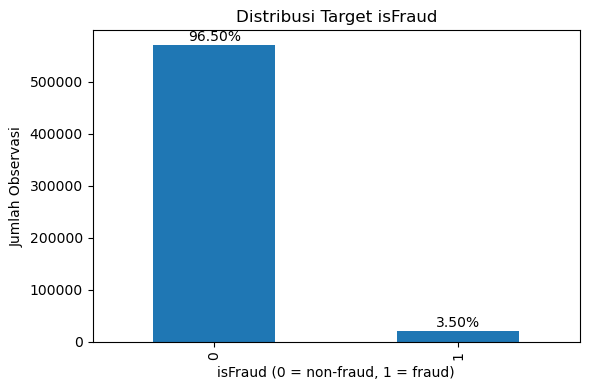

In [13]:
import matplotlib.pyplot as plt

# Hitung jumlah tiap kelas
fraud_counts = df_train['isFraud'].value_counts().sort_index()
total = fraud_counts.sum()
fraud_rate = df_train['isFraud'].mean() * 100

print("Jumlah data tiap kelas:")
print(fraud_counts)
print(f"\nFraud rate  : {fraud_rate:.2f}%")

# Plot bar
plt.figure(figsize=(6,4))
fraud_counts.plot(kind='bar')

plt.title('Distribusi Target isFraud')
plt.xlabel('isFraud (0 = non-fraud, 1 = fraud)')
plt.ylabel('Jumlah Observasi')

# Tambah persentase di atas bar
for i, v in enumerate(fraud_counts.values):
    plt.text(i, v + total*0.005, f"{v/total*100:.2f}%", 
             ha='center', va='bottom')

plt.tight_layout()
plt.show()

## TransactionDT

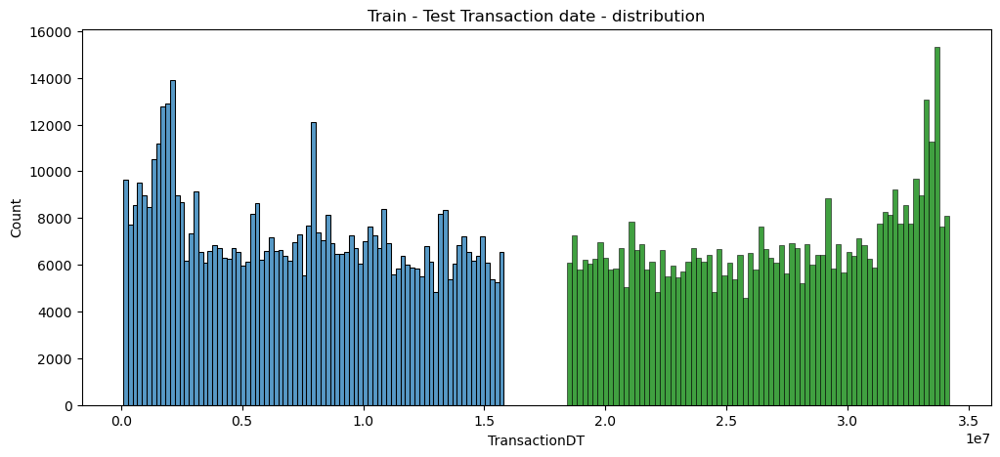

In [14]:
fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(12,5))
sns.histplot(df_train['TransactionDT'])
sns.histplot(df_test['TransactionDT'],color='g')
axes.title.set_text('Train - Test Transaction date - distribution')
plt.show()

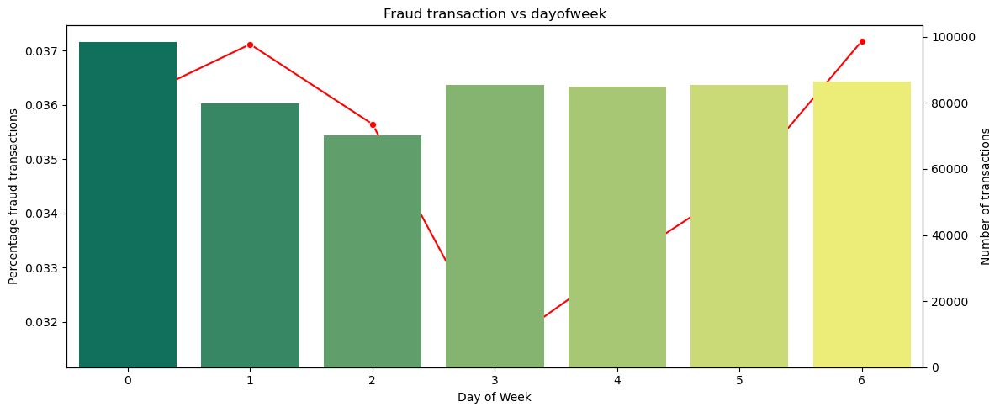

In [15]:
# Feature dayofweek dari TransactionDT
df_train['dayofweek'] = (df_train['TransactionDT'] // (60*60*24) - 1) % 7

# Rata-rata persentase fraud per dayofweek
tmp = (
    df_train[['isFraud', 'dayofweek']]
    .groupby('dayofweek')
    .mean()
    .reset_index()
    .rename(columns={'isFraud': 'Percentage fraud transactions'})
)

# Jumlah transaksi per dayofweek
tmp_count = (
    df_train[['TransactionID', 'dayofweek']]
    .groupby('dayofweek')
    .count()
    .reset_index()
    .rename(columns={'TransactionID': 'Number of transactions'})
)

# Gabungkan keduanya
tmp = tmp.merge(tmp_count, on='dayofweek')

# Plot
fig, axes = plt.subplots(figsize=(12, 5))

# Garis: persentase transaksi fraud
sns.lineplot(
    x='dayofweek',
    y='Percentage fraud transactions',
    data=tmp,
    color='r',
    marker='o',
    ax=axes
)

# Sumbu kedua: jumlah transaksi (bar)
axes2 = axes.twinx()
sns.barplot(
    x='dayofweek',
    y='Number of transactions',
    data=tmp,
    hue='dayofweek',      # sesuai anjuran seaborn
    palette='summer',
    dodge=False,
    legend=False,         # supaya legend tidak muncul
    ax=axes2
)

axes.set_title('Fraud transaction vs dayofweek')
axes.set_xlabel('Day of Week')
axes.set_ylabel('Percentage fraud transactions')
axes2.set_ylabel('Number of transactions')

plt.tight_layout()
plt.show()

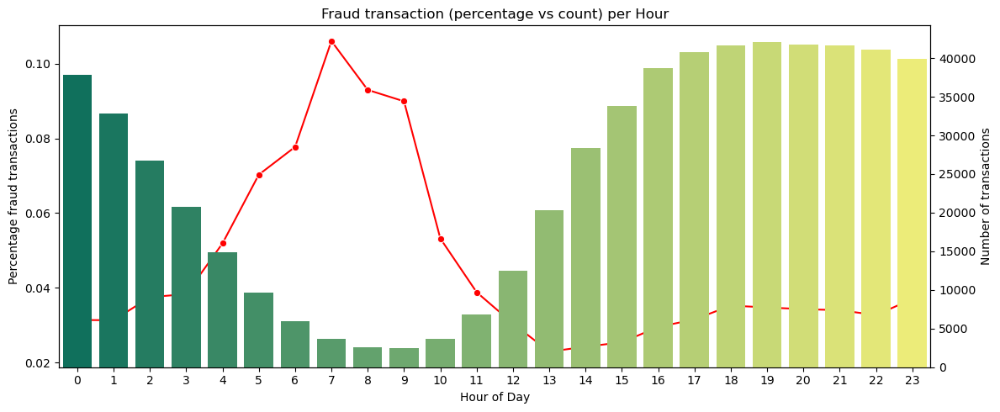

In [16]:
# Membuat fitur jam (hour)
df_train['hour'] = (df_train['TransactionDT'] // (60*60)) % 24

# Rata-rata persentase fraud per hour
tmp = (
    df_train[['isFraud', 'hour']]
    .groupby('hour')
    .mean()
    .reset_index()
    .rename(columns={'isFraud': 'Percentage fraud transactions'})
)

# Jumlah transaksi per hour
tmp_count = (
    df_train[['TransactionID', 'hour']]
    .groupby('hour')
    .count()
    .reset_index()
    .rename(columns={'TransactionID': 'Number of transactions'})
)

# Merge keduanya
tmp = tmp.merge(tmp_count, on='hour')

# Plot
fig, axes = plt.subplots(figsize=(12, 5))

# Garis: fraud rate
sns.lineplot(
    x='hour',
    y='Percentage fraud transactions',
    data=tmp,
    color='r',
    marker='o',
    ax=axes
)

# Bar: jumlah transaksi
axes2 = axes.twinx()
sns.barplot(
    x='hour',
    y='Number of transactions',
    data=tmp,
    hue='hour',          # mengikuti requirement seaborn
    palette='summer',
    dodge=False,
    legend=False,
    ax=axes2
)

axes.set_title('Fraud transaction (percentage vs count) per Hour')
axes.set_xlabel('Hour of Day')
axes.set_ylabel('Percentage fraud transactions')
axes2.set_ylabel('Number of transactions')

plt.tight_layout()
plt.show()

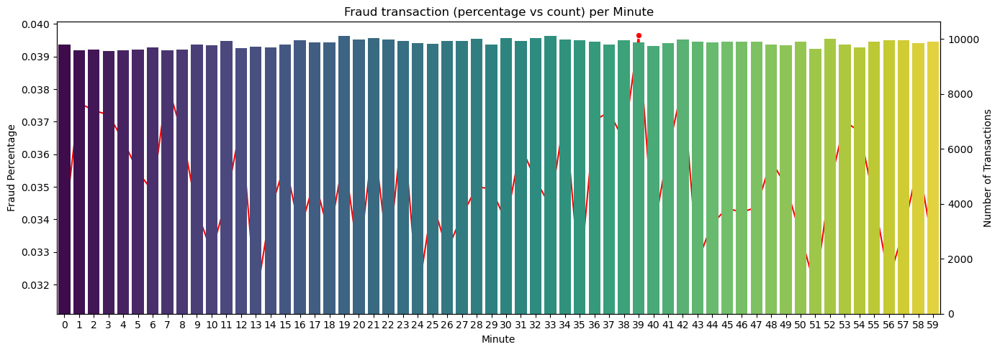

In [17]:
# Membuat fitur minute
df_train['minute'] = (df_train['TransactionDT'] // 60) % 60

# Fraud rate per minute
tmp_min = (
    df_train[['isFraud', 'minute']]
    .groupby('minute')
    .mean()
    .reset_index()
    .rename(columns={'isFraud': 'Percentage fraud transactions'})
)

# Jumlah transaksi per minute
tmp_min_count = (
    df_train[['TransactionID', 'minute']]
    .groupby('minute')
    .count()
    .reset_index()
    .rename(columns={'TransactionID': 'Number of transactions'})
)

# Merge
tmp_min = tmp_min.merge(tmp_min_count, on='minute')

# Plot
fig, axes = plt.subplots(figsize=(14, 5))

sns.lineplot(
    x='minute',
    y='Percentage fraud transactions',
    data=tmp_min,
    color='r',
    marker='o',
    ax=axes
)

axes2 = axes.twinx()

sns.barplot(
    x='minute',
    y='Number of transactions',
    data=tmp_min,
    hue='minute',
    palette='viridis',
    dodge=False,
    legend=False,
    ax=axes2
)

axes.set_title('Fraud transaction (percentage vs count) per Minute')
axes.set_xlabel('Minute')
axes.set_ylabel('Fraud Percentage')
axes2.set_ylabel('Number of Transactions')

plt.tight_layout()
plt.show()

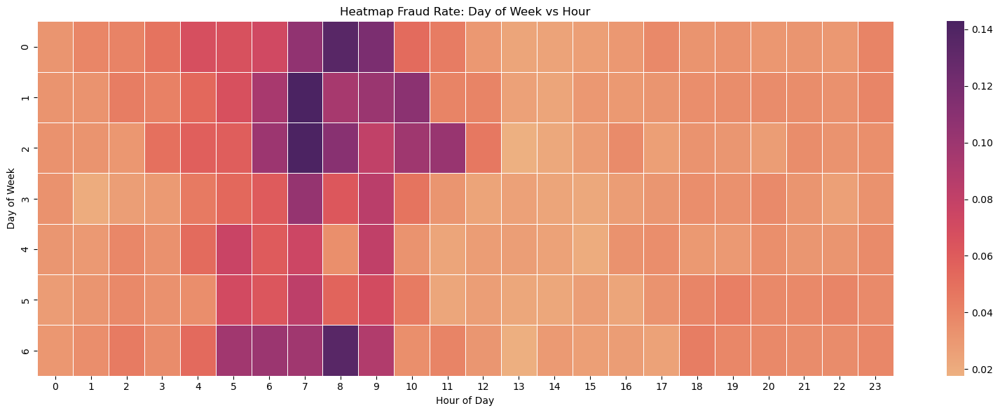

In [18]:
# Pastikan fitur dayofweek dan hour sudah ada
df_train['dayofweek'] = (df_train['TransactionDT'] // (60*60*24) - 1) % 7
df_train['hour'] = (df_train['TransactionDT'] // (60*60)) % 24

# Buat pivot table fraud rate
heatmap_data = (
    df_train.pivot_table(
        index='dayofweek',
        columns='hour',
        values='isFraud',
        aggfunc='mean'
    )
)

plt.figure(figsize=(16, 6))
sns.heatmap(
    heatmap_data,
    cmap='flare',      # palette yang cocok untuk rasio
    linewidths=.5
)

plt.title('Heatmap Fraud Rate: Day of Week vs Hour')
plt.xlabel('Hour of Day')
plt.ylabel('Day of Week')

plt.tight_layout()
plt.show()

## Checking Outliers

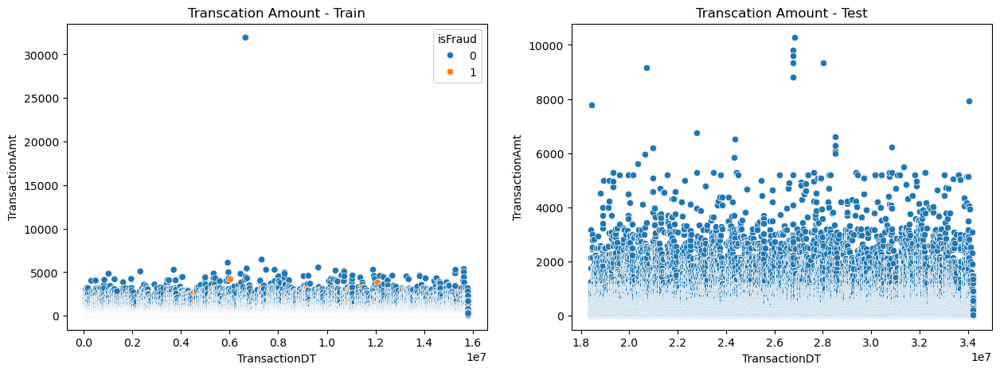

In [19]:
fig, axes = plt.subplots(1,2,figsize=(15,5))

sns.scatterplot(y=df_train['TransactionAmt'],x=df_train['TransactionDT'],hue=df_train['isFraud'],ax=axes[0])
axes[0].title.set_text('Transcation Amount - Train')

sns.scatterplot(y=df_test['TransactionAmt'],x=df_test['TransactionDT'],ax=axes[1])
axes[1].title.set_text('Transcation Amount - Test')

plt.show()

In [20]:
df_train = df_train[df_train['TransactionAmt'] < 30000]
df_train.shape

(590538, 437)

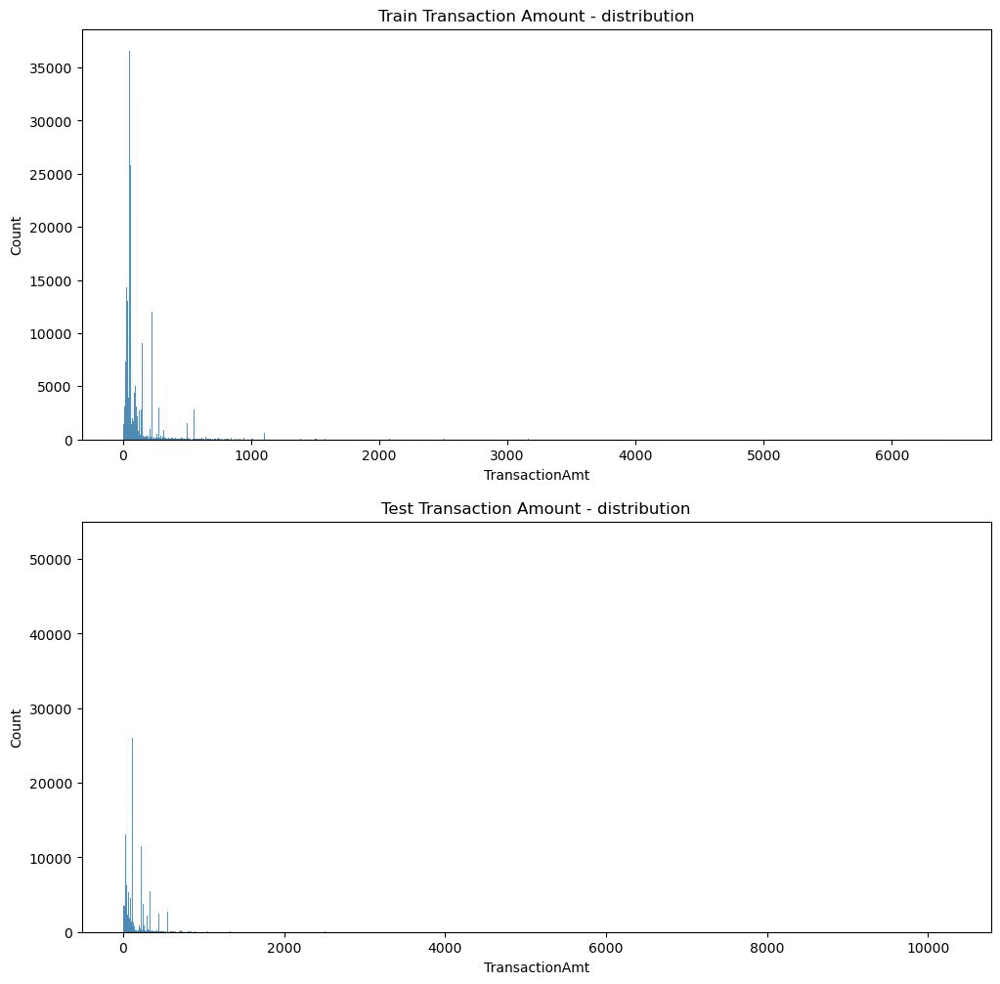

In train data Minimum transaction amount is 0.251 and maximum amount  is 6450.97
In test data Minimum transaction amount is 0.018 and maximum amount  is 10270.0


In [21]:
fig, axes = plt.subplots(nrows=2, ncols=1,figsize=(12,12))
sns.histplot(df_train['TransactionAmt'],ax=axes[0])
sns.histplot(df_test['TransactionAmt'],ax=axes[1])
axes[0].title.set_text('Train Transaction Amount - distribution')
axes[1].title.set_text('Test Transaction Amount - distribution')
plt.show()

print(f'In train data Minimum transaction amount is {df_train["TransactionAmt"].min()} and maximum amount  is {df_train["TransactionAmt"].max()}')
print(f'In test data Minimum transaction amount is {df_test["TransactionAmt"].min()} and maximum amount  is {df_test["TransactionAmt"].max()}')

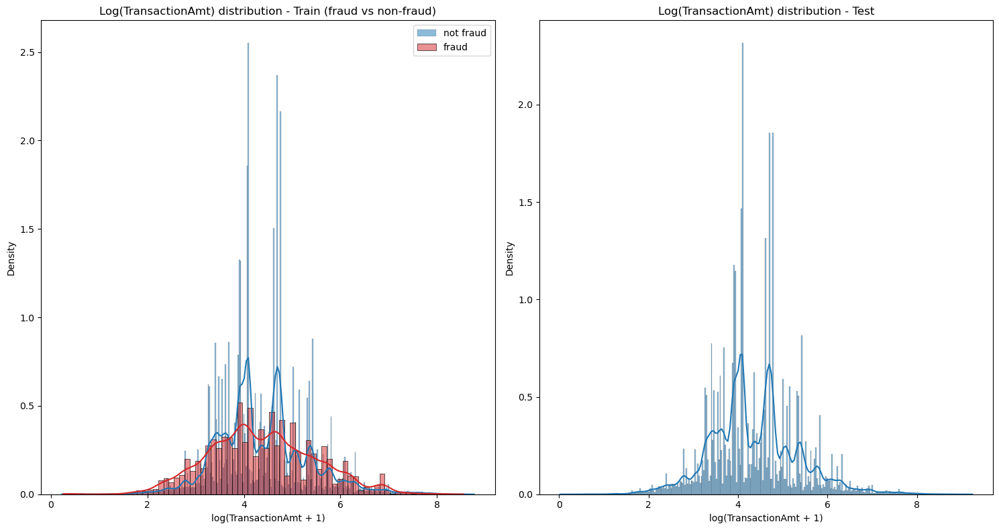

In [22]:
# --- log-transform test set ---
test_amt = np.log1p(df_test['TransactionAmt'])   # Series, bukan DataFrame

# --- pisah fraud & non-fraud + buat salinan aman ---
dff_fraud = df_train[df_train['isFraud'] == 1].copy()
dff_notfraud = df_train[df_train['isFraud'] == 0].copy()

# --- log-transform ke kolom baru, tidak overwrite kolom asli ---
dff_fraud['logAmt'] = np.log1p(dff_fraud['TransactionAmt'])
dff_notfraud['logAmt'] = np.log1p(dff_notfraud['TransactionAmt'])

fig, axes = plt.subplots(1, 2, figsize=(15, 8))

# train

sns.histplot(
    dff_notfraud['logAmt'],
    ax=axes[0],
    label='not fraud',
    stat='density',
    kde=True,
    color='tab:blue',
    alpha=0.5
)

sns.histplot(
    dff_fraud['logAmt'],
    ax=axes[0],
    label='fraud',
    stat='density',
    kde=True,
    color='tab:red',
    alpha=0.5
)

axes[0].set_title('Log(TransactionAmt) distribution - Train (fraud vs non-fraud)')
axes[0].set_xlabel('log(TransactionAmt + 1)')
axes[0].set_ylabel('Density')
axes[0].legend()

# Test

sns.histplot(
    test_amt,
    ax=axes[1],
    stat='density',
    kde=True
)

axes[1].set_title('Log(TransactionAmt) distribution - Test')
axes[1].set_xlabel('log(TransactionAmt + 1)')
axes[1].set_ylabel('Density')

plt.tight_layout()
plt.show()

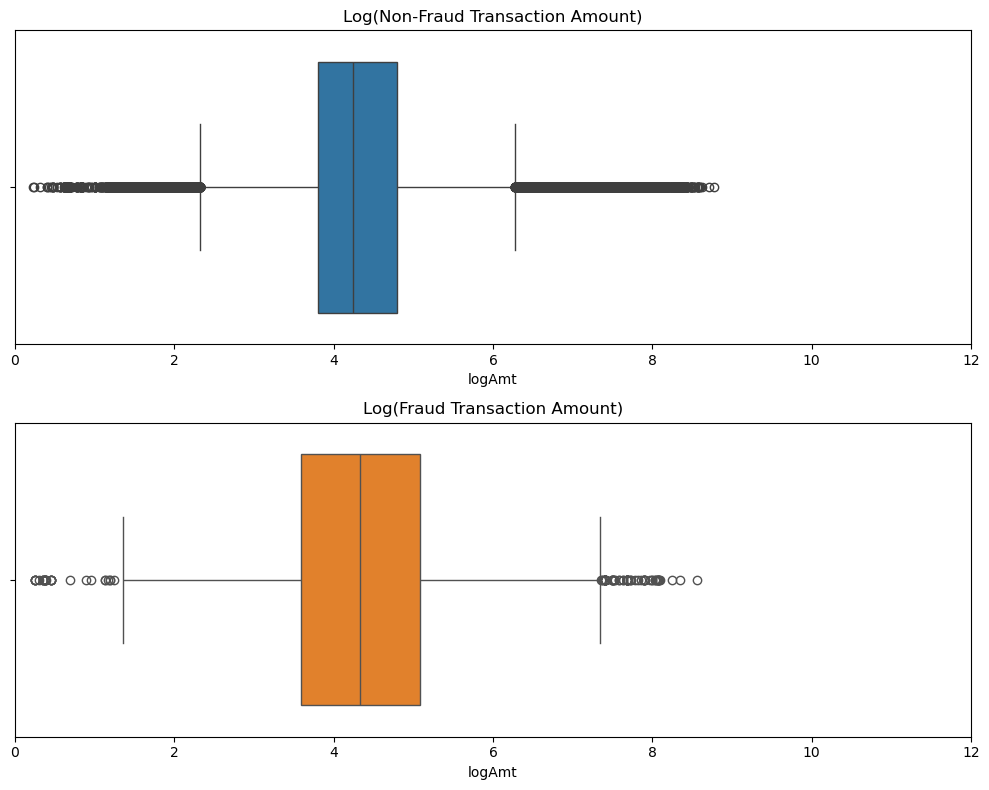

Mean log(TransactionAmt) fraud  = 4.3742  -> 78.3728 dollars
Mean log(TransactionAmt) non-fraud = 4.3833  -> 79.0986 dollars
Median log(TransactionAmt) fraud  = 4.3307  -> 75.0000 dollars
Median log(TransactionAmt) non-fraud = 4.2413  -> 68.5000 dollars


In [23]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Pisahkan fraud dan non-fraud + buat salinan aman
dff_fraud = df_train[df_train['isFraud'] == 1].copy()
dff_notfraud = df_train[df_train['isFraud'] == 0].copy()

# Buat kolom log-transform (pakai log1p supaya aman utk nilai kecil)
dff_fraud['logAmt'] = np.log1p(dff_fraud['TransactionAmt'])
dff_notfraud['logAmt'] = np.log1p(dff_notfraud['TransactionAmt'])

fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 8))

sns.boxplot(x='logAmt', data=dff_notfraud, ax=axes[0])
axes[0].set_title('Log(Non-Fraud Transaction Amount)')
axes[0].set_xlim(0, 12)

sns.boxplot(x='logAmt', data=dff_fraud, ax=axes[1], color='tab:orange')
axes[1].set_title('Log(Fraud Transaction Amount)')
axes[1].set_xlim(0, 12)

plt.tight_layout()
plt.show()

mean_log_fraud = dff_fraud['logAmt'].mean()
mean_log_notfraud = dff_notfraud['logAmt'].mean()

median_log_fraud = dff_fraud['logAmt'].median()
median_log_notfraud = dff_notfraud['logAmt'].median()

print(
    'Mean log(TransactionAmt) fraud  = {:.4f}  -> {:.4f} dollars'
    .format(mean_log_fraud, np.expm1(mean_log_fraud))
)
print(
    'Mean log(TransactionAmt) non-fraud = {:.4f}  -> {:.4f} dollars'
    .format(mean_log_notfraud, np.expm1(mean_log_notfraud))
)

print(
    'Median log(TransactionAmt) fraud  = {:.4f}  -> {:.4f} dollars'
    .format(median_log_fraud, np.expm1(median_log_fraud))
)
print(
    'Median log(TransactionAmt) non-fraud = {:.4f}  -> {:.4f} dollars'
    .format(median_log_notfraud, np.expm1(median_log_notfraud))
)

## ProductCD

In [24]:
df_train['ProductCD'].isnull().sum()

np.int64(0)

In [25]:
df_train['ProductCD'].value_counts()

ProductCD
W    439668
C     68519
R     37699
H     33024
S     11628
Name: count, dtype: int64

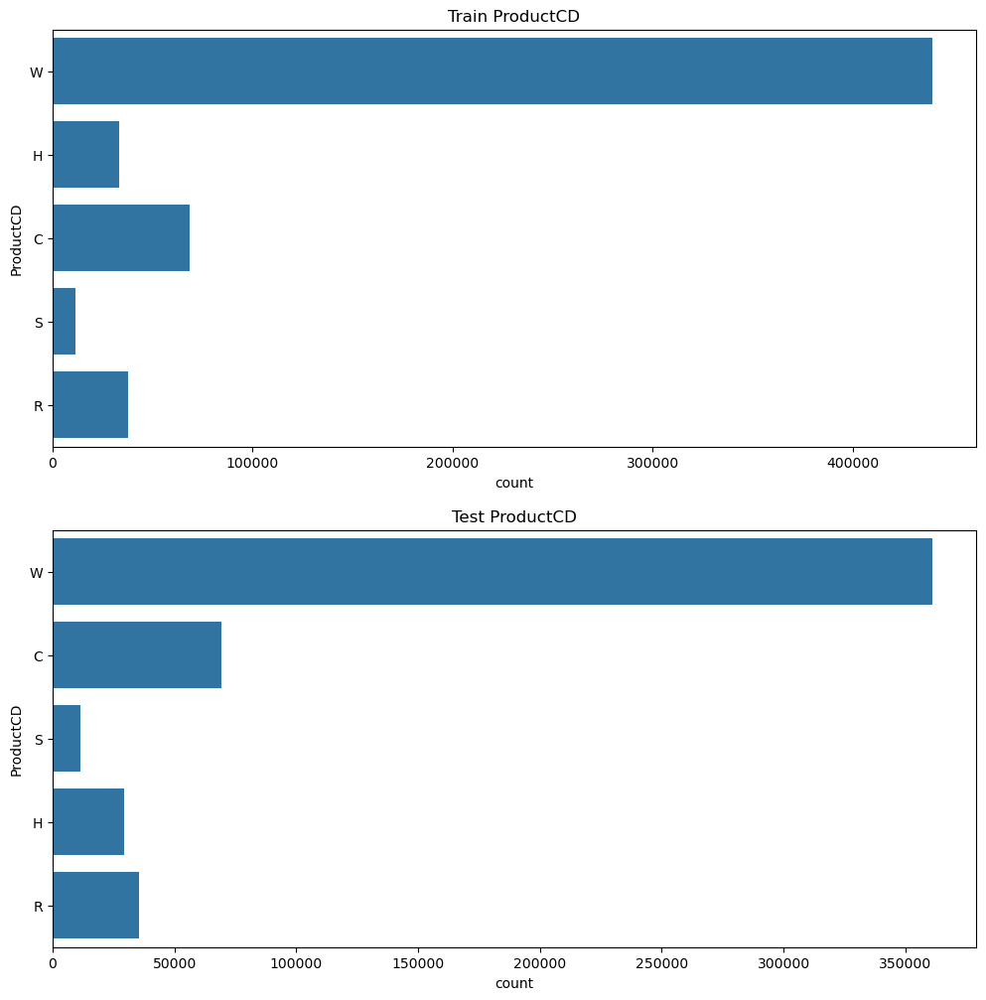

In [26]:
fig, axes = plt.subplots(nrows=2, ncols=1,figsize=(12,12))
sns.countplot(df_train['ProductCD'],ax=axes[0])
sns.countplot(df_test['ProductCD'],ax=axes[1])
axes[0].title.set_text('Train ProductCD')
axes[1].title.set_text('Test ProductCD')
plt.show()

In [27]:
def hor_plot(feat,df=df_train,label_rotation=False,shape=(12,8)):
    
    val_cnts = df[feat].value_counts()
    df1 = pd.DataFrame({feat: val_cnts.index,'Number of units': val_cnts.values})
    # Calculate the percentage of target=1 per category value.For that what we did is we took the mean value of TARGET
    percent = df[[feat, 'isFraud']].groupby([feat],as_index=False).mean()
    percent.sort_values(by='isFraud', ascending=False, inplace=True)
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=shape)
    s = sns.barplot(ax=ax1, x = feat, y="Number of units",data=df1)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)
    
    s = sns.barplot(ax=ax2, x = feat, y='isFraud', order=percent[feat], data=percent)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)
    
    plt.ylabel('Percent of Fraud transactions [Target with value 1]', fontsize=10)
    plt.tick_params(axis='both', which='major', labelsize=10)
    plt.show();

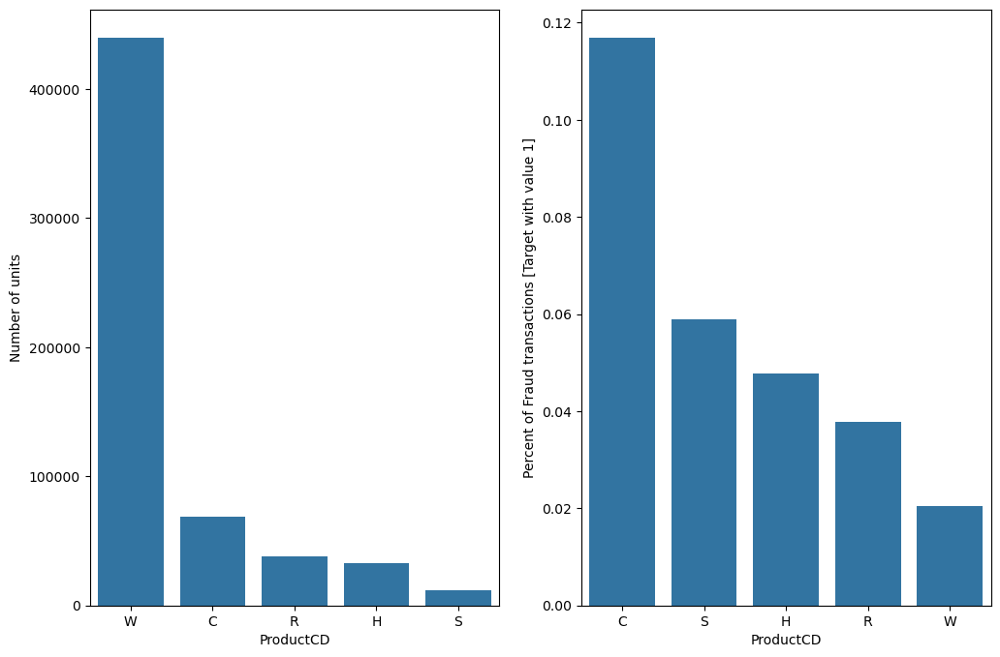

In [28]:
hor_plot(df=df_train,feat='ProductCD')

## Card 1-6

In [29]:
cards = [col for col in df_train.columns if 'card' in col]
df_train[cards].head()

,card1,card2,card3,card4,card5,card6
0,13926,NaN,150.0,discover,142.0,credit
1,2755,404.0,150.0,mastercard,102.0,credit
2,4663,490.0,150.0,visa,166.0,debit
3,18132,567.0,150.0,mastercard,117.0,debit
4,4497,514.0,150.0,mastercard,102.0,credit


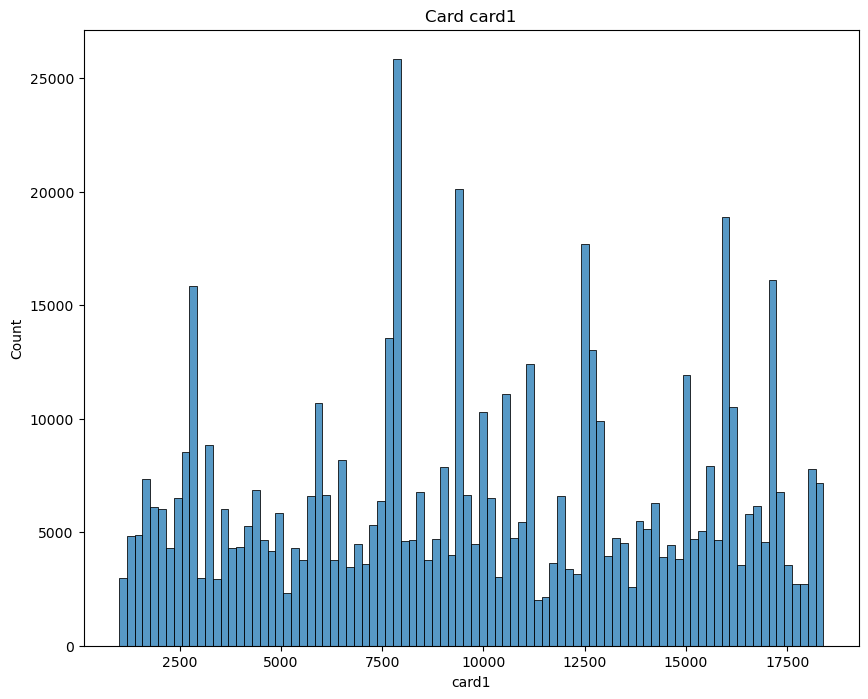

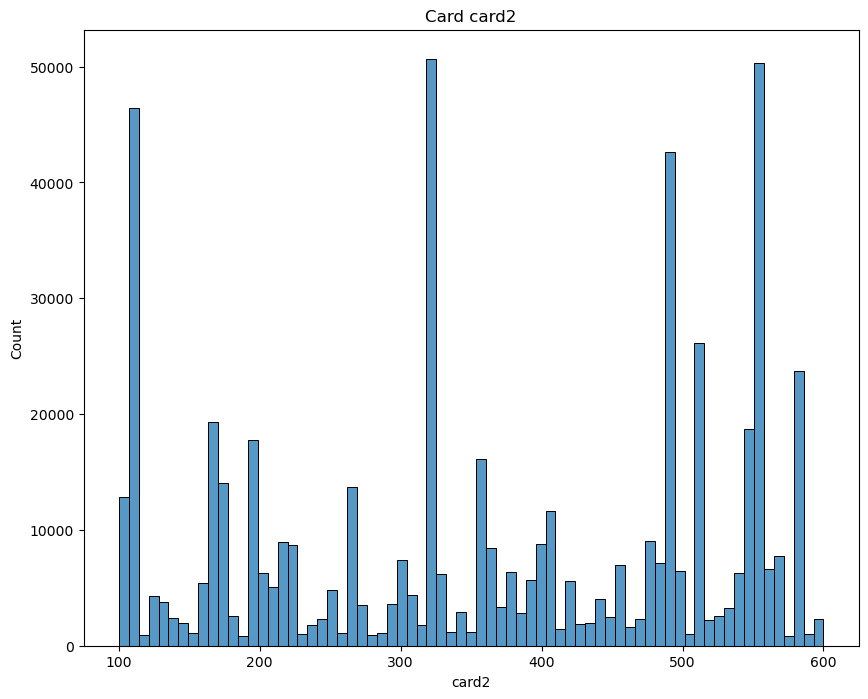

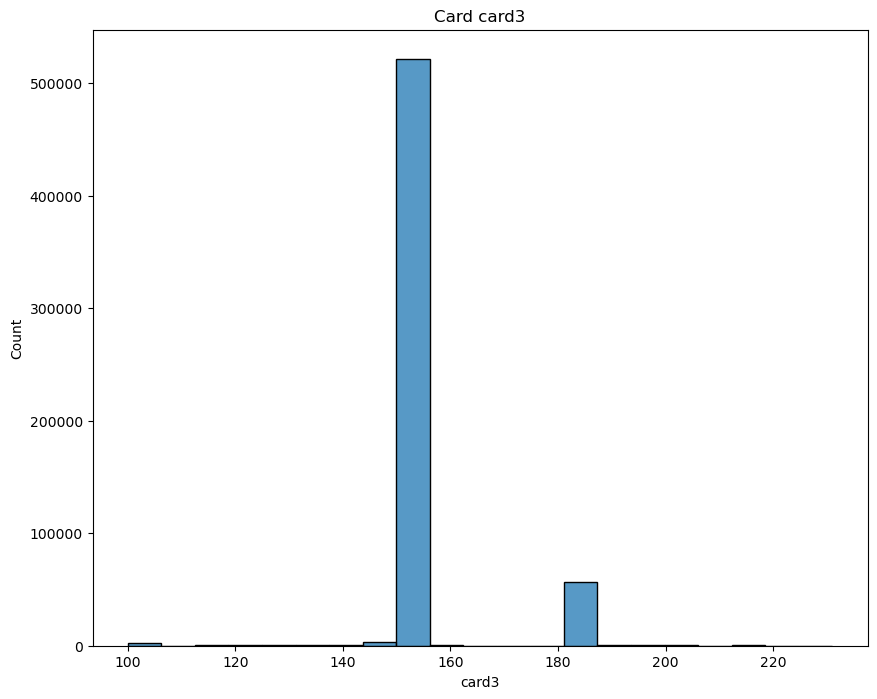

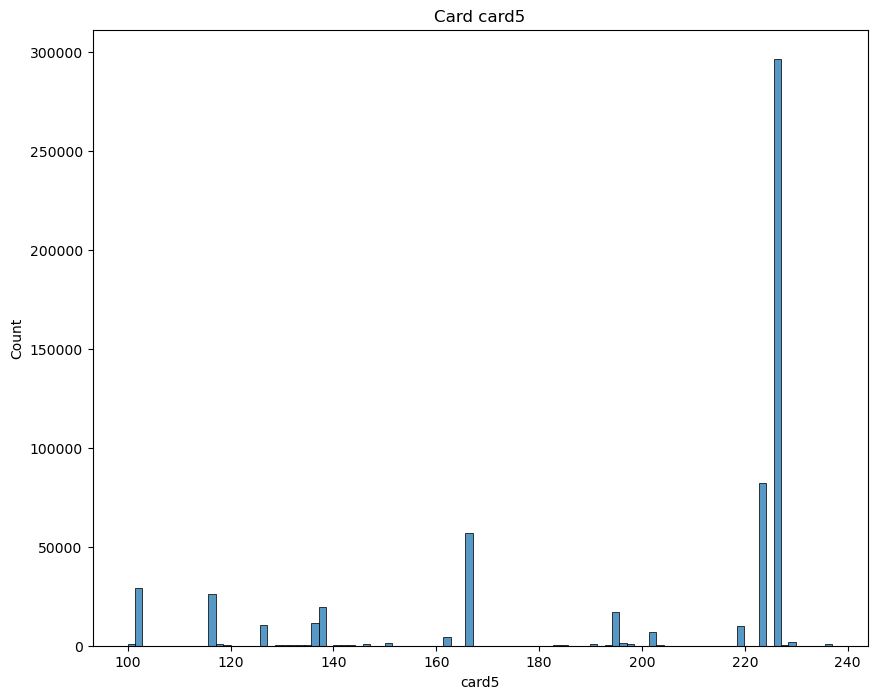

In [30]:
for c in cards:
    if df_train[c].dtypes in ['int64','float64']:
        fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(10,8))
        sns.histplot(df_train[c])
        axes.title.set_text(f'Card {c}')
        plt.show()

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15432\3962252809.py:11: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  s.set_xticklabels(s.get_xticklabels(),rotation=90)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15432\3962252809.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  s.set_xticklabels(s.get_xticklabels(),rotation=90)


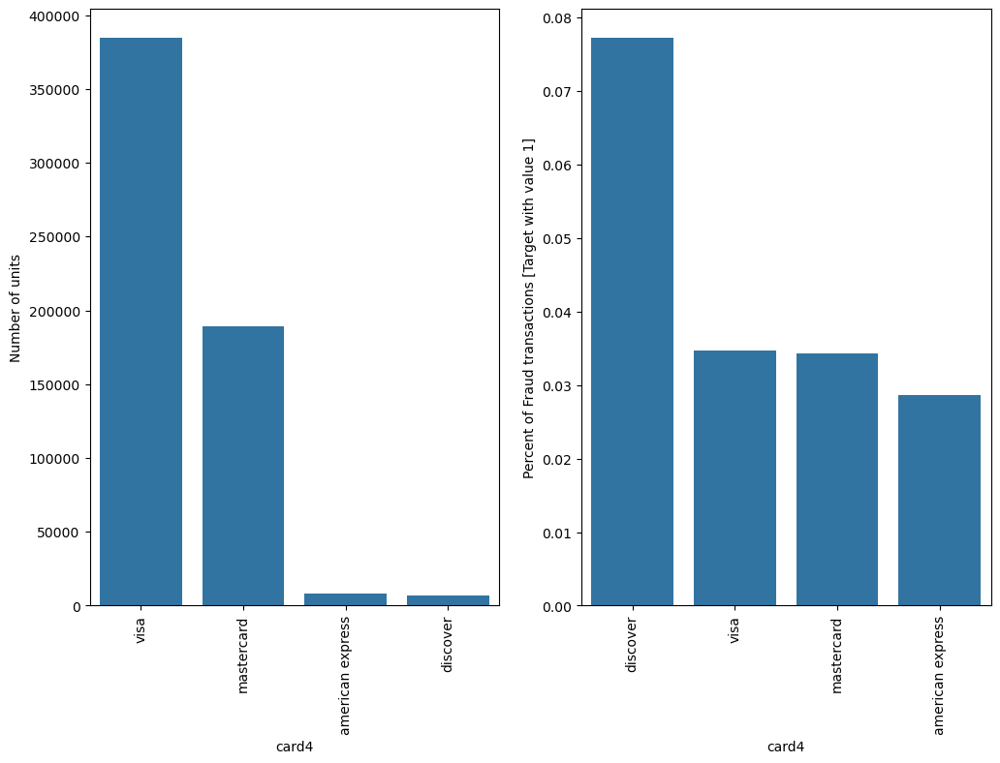

In [31]:
hor_plot('card4',label_rotation=True)

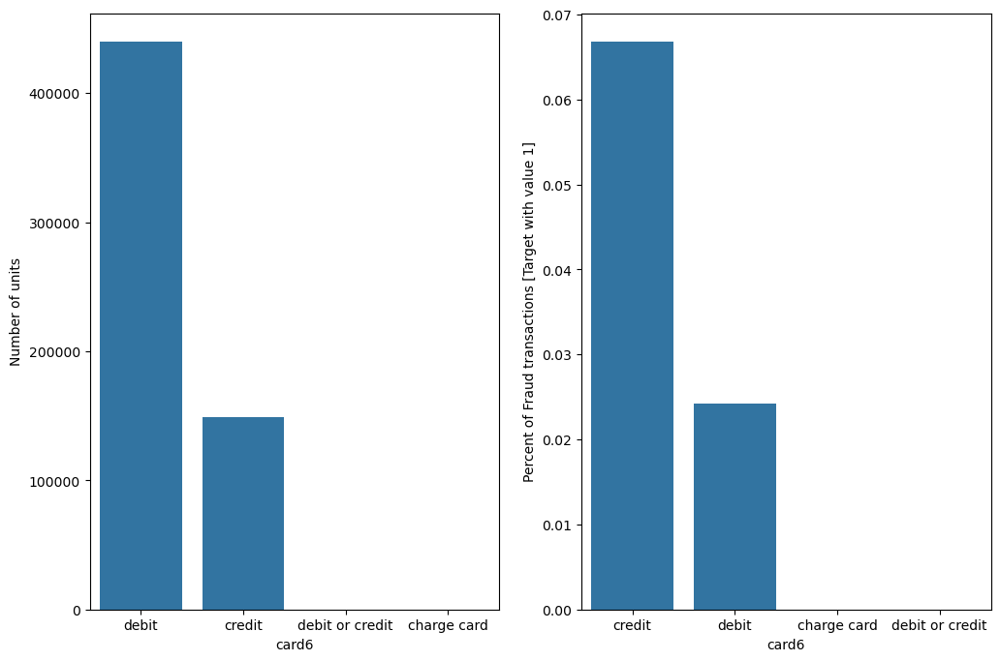

In [32]:
hor_plot('card6')

In [33]:
numeric_cards = ['card1', 'card2', 'card3', 'card5', 'isFraud']
df_train[numeric_cards].corr()

,card1,card2,card3,card5,isFraud
card1,1.000000,0.004956,0.002966,-0.093624,-0.013639
card2,0.004956,1.000000,0.023817,0.030494,0.003389
card3,0.002966,0.023817,1.000000,-0.158387,0.154151
card5,-0.093624,0.030494,-0.158387,1.000000,-0.033581
isFraud,-0.013639,0.003389,0.154151,-0.033581,1.000000


In [34]:
df_train.groupby('card4')['isFraud'].mean().sort_values()

card4
american express    0.028698
mastercard          0.034331
visa                0.034756
discover            0.077282
Name: isFraud, dtype: float64

In [35]:
df_train.groupby('card6')['isFraud'].mean().sort_values()

card6
charge card        0.000000
debit or credit    0.000000
debit              0.024263
credit             0.066786
Name: isFraud, dtype: float64

In [36]:
from sklearn.preprocessing import LabelEncoder

df_corr = df_train[['card1','card2','card3','card4','card5','card6','isFraud']].copy()

for c in ['card4','card6']:
    le = LabelEncoder()
    df_corr[c] = le.fit_transform(df_corr[c].astype(str))

df_corr.corr()

,card1,card2,card3,card4,card5,card6,isFraud
card1,1.000000,0.004956,0.002966,0.042759,-0.093624,0.019834,-0.013639
card2,0.004956,1.000000,0.023817,0.039301,0.030494,-0.134360,0.003389
card3,0.002966,0.023817,1.000000,-0.025550,-0.158387,-0.067030,0.154151
card4,0.042759,0.039301,-0.025550,1.000000,0.395527,0.156143,-0.003298
card5,-0.093624,0.030494,-0.158387,0.395527,1.000000,0.167081,-0.033581
card6,0.019834,-0.134360,-0.067030,0.156143,0.167081,1.000000,-0.097762
isFraud,-0.013639,0.003389,0.154151,-0.003298,-0.033581,-0.097762,1.000000


# Analisis Korelasi dan Fraud Rate pada Fitur Card

## 1. Korelasi Numerik antar Fitur Card dengan isFraud

Pada tahap awal, hanya fitur **card1**, **card2**, **card3**, dan **card5** yang dapat dihitung korelasinya karena semuanya bertipe numerik.  
Hasil korelasi menunjukkan bahwa:

- Korelasi masing-masing fitur card terhadap **isFraud** bernilai sangat kecil (mendekati 0).
- Tidak ada hubungan linear yang kuat antara fitur card numerik dan target.

**Interpretasi:**  
Korelasi linear yang lemah tidak berarti fitur card tidak penting. Pada dataset fraud detection, pola hubungan seringkali non-linear sehingga model seperti LightGBM atau XGBoost dapat menangkap hubungan yang tidak terlihat oleh korelasi Pearson.


## 2. Fraud Rate berdasarkan *card4* (Jenis Kartu)

Fitur **card4** merupakan kategori yang berisi jenis kartu seperti *visa*, *mastercard*, *american express*, dan *discover*.  
Perhitungan fraud rate per kategori menunjukkan bahwa:

- *american express* memiliki fraud rate tertinggi  
- *mastercard* berada pada posisi menengah  
- *visa* memiliki fraud rate lebih rendah  
- *discover* cenderung lebih tinggi dibanding visa

**Interpretasi:**  
Fraud rate yang berbeda antar jenis kartu menunjukkan bahwa tipe kartu dapat menjadi indikator risiko. Meskipun tidak terlihat dalam korelasi numerik, pola kategori seperti ini sangat relevan untuk model prediksi.


## 3. Fraud Rate berdasarkan *card6* (Jenis Metode Pembayaran)

Fitur **card6** berisi tipe pembayaran seperti *credit*, *debit*, *debit or credit*, dan *charge card*.

Hasil perhitungan fraud rate menunjukkan bahwa:

- *debit* memiliki fraud rate tertinggi  
- *credit* dan *charge card* memiliki fraud rate yang lebih rendah

**Interpretasi:**  
Perbedaan fraud rate antar metode pembayaran memberi gambaran bahwa metode transaksi tertentu cenderung lebih rawan fraud. Ini bisa menjadi fitur penting dalam model deteksi anomali.



## 4. Korelasi Setelah Encoding card4 dan card6

Setelah dilakukan **Label Encoding** untuk mengubah kategori menjadi angka, korelasi dihitung kembali.  
Hasilnya:

- Korelasi card4 dan card6 dengan isFraud tetap sangat rendah  
- Hal ini wajar karena label encoding tidak mengubah sifat kategorikal menjadi hubungan linear

**Interpretasi:**  
Walaupun korelasi sangat rendah, fitur kategorikal ini tetap bermanfaat untuk model non-linear. Korelasi Pearson tidak dapat menangkap interaksi kompleks antar kategori.


## 5. Kesimpulan Analisis Fitur Card

1. Korelasi linear fitur card terhadap isFraud sangat lemah.  
2. Fraud rate berdasarkan kategori **jauh lebih informatif** dibanding korelasi numerik.  
3. Fitur card4 dan card6 lebih cocok diproses oleh model **non-linear** seperti LightGBM/XGBoost.  
4. Insight terpenting dalam EDA fitur card berasal dari pola fraud rate kategori, bukan matriks korelasi.


## P_email domain and R_email domain

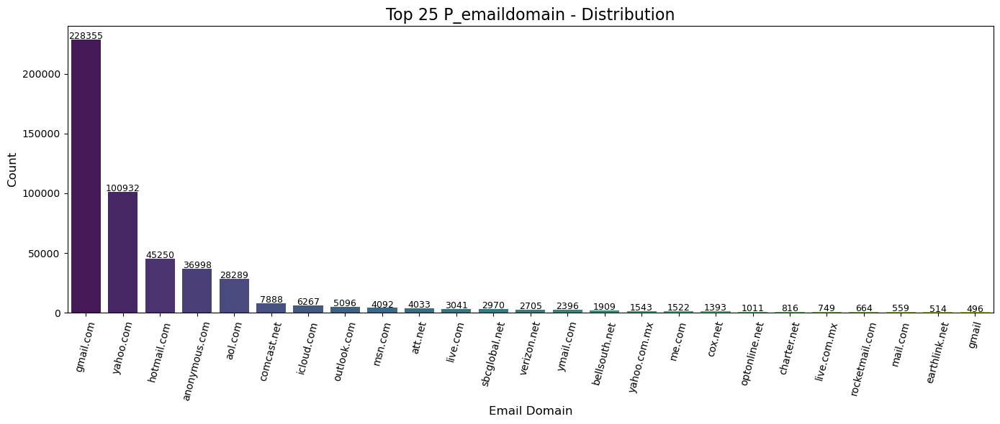

In [37]:
# Hitung frekuensi domain (Top 25) dan jadikan DataFrame
email_counts = (
    df_train['P_emaildomain']
    .value_counts()
    .head(25)
    .reset_index()
)
email_counts.columns = ['P_emaildomain', 'count']

fig, ax = plt.subplots(figsize=(14, 6))

# Gunakan hue=P_emaildomain supaya palette valid
sns.barplot(
    data=email_counts,
    x='P_emaildomain',
    y='count',
    hue='P_emaildomain',      # penting untuk hilangkan FutureWarning
    palette='viridis',
    dodge=False,
    legend=False,             # legend tidak perlu
    ax=ax
)

ax.set_title("Top 25 P_emaildomain - Distribution", fontsize=16)
ax.set_xlabel("Email Domain", fontsize=12)
ax.set_ylabel("Count", fontsize=12)

plt.xticks(rotation=75)

# Tampilkan nilai di atas bar
for i, row in email_counts.iterrows():
    ax.text(
        i,
        row['count'] + 500,
        str(row['count']),
        ha='center',
        fontsize=9
    )

plt.tight_layout()
plt.show()

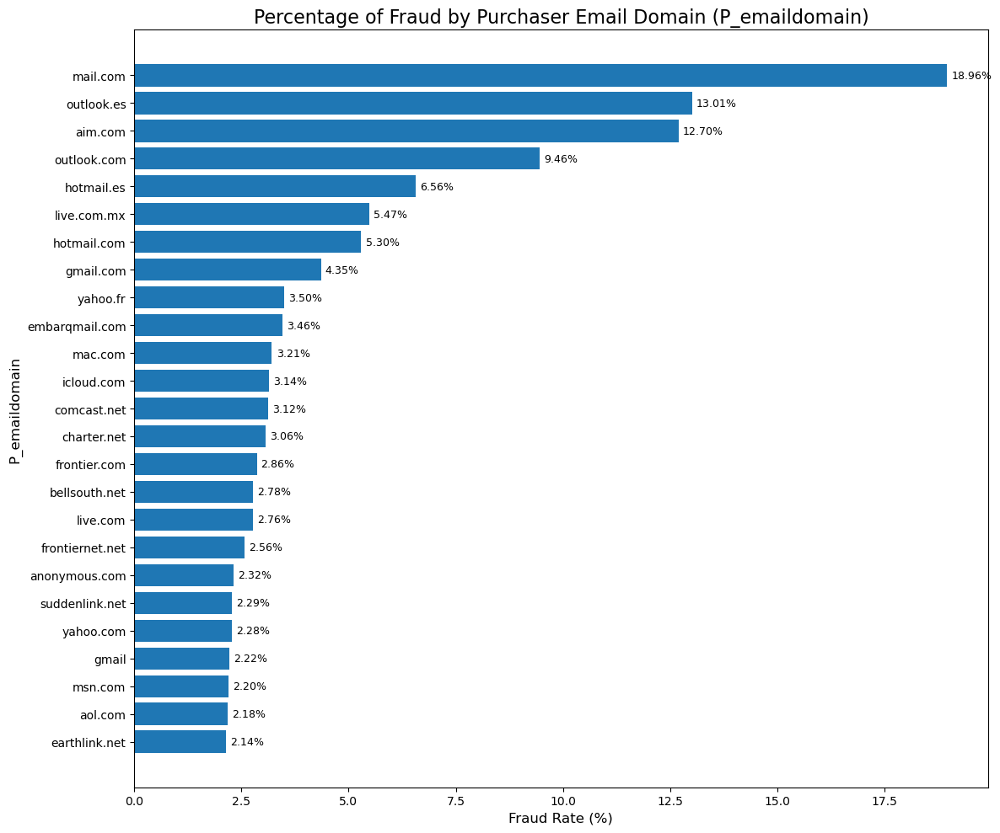

In [38]:
import matplotlib.pyplot as plt

# Hitung fraud rate dan jumlah transaksi per domain
email_fraud = (
    df_train
    .groupby('P_emaildomain')['isFraud']
    .agg(['mean', 'count'])
    .rename(columns={'mean': 'fraud_rate', 'count': 'n_trans'})
)

# (Opsional) filter domain yang transaksinya cukup banyak, misal >= 100
email_fraud = email_fraud[email_fraud['n_trans'] >= 100]

# Konversi ke persen dan ambil misalnya top 25 fraud rate tertinggi
email_fraud['fraud_rate_pct'] = email_fraud['fraud_rate'] * 100
email_fraud_plot = email_fraud.sort_values('fraud_rate_pct', ascending=True).tail(25)

# Plot horizontal bar
fig, ax = plt.subplots(figsize=(12, 10))

ax.barh(
    email_fraud_plot.index,
    email_fraud_plot['fraud_rate_pct']
)

ax.set_title('Percentage of Fraud by Purchaser Email Domain (P_emaildomain)', fontsize=16)
ax.set_xlabel('Fraud Rate (%)', fontsize=12)
ax.set_ylabel('P_emaildomain', fontsize=12)

# Tampilkan nilai persentase di ujung bar
for i, (idx, row) in enumerate(email_fraud_plot.iterrows()):
    ax.text(
        row['fraud_rate_pct'] + 0.1,  # geser sedikit ke kanan
        i,
        f"{row['fraud_rate_pct']:.2f}%",
        va='center',
        fontsize=9
    )

plt.tight_layout()
plt.show()

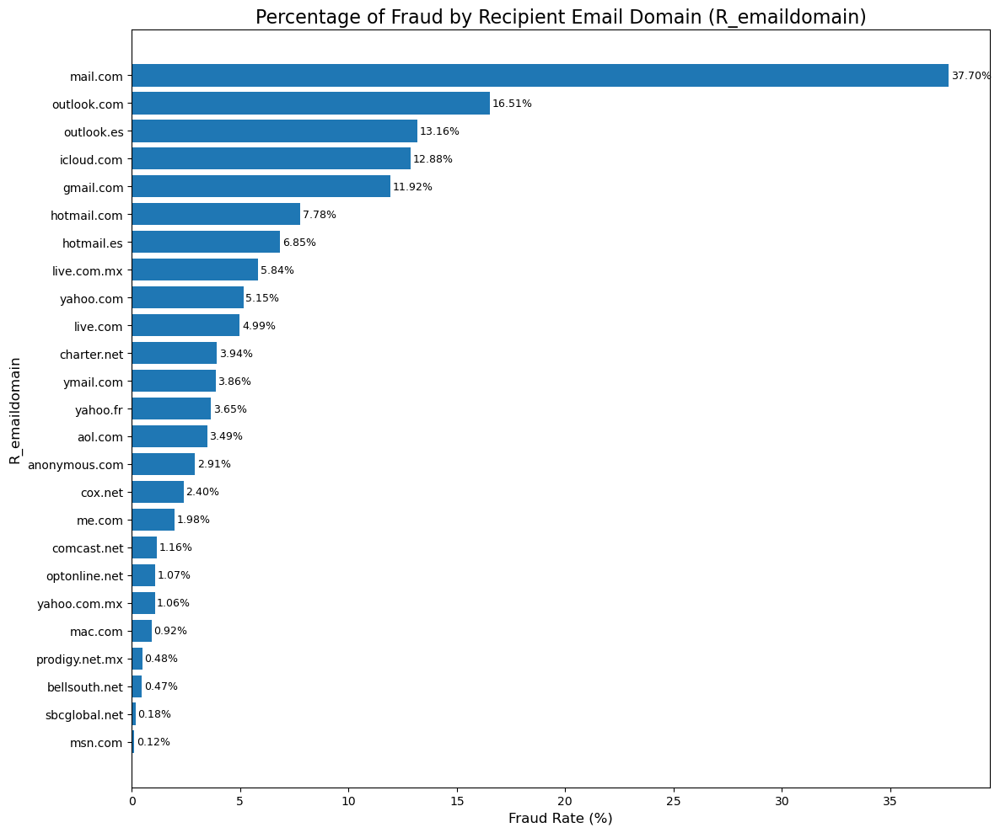

In [39]:
import matplotlib.pyplot as plt

# Hitung fraud rate dan jumlah transaksi per R_emaildomain
r_email_fraud = (
    df_train
    .groupby('R_emaildomain')['isFraud']
    .agg(['mean', 'count'])
    .rename(columns={'mean': 'fraud_rate', 'count': 'n_trans'})
)

# (Opsional, sangat disarankan): filter domain dengan jumlah transaksi cukup
r_email_fraud = r_email_fraud[r_email_fraud['n_trans'] >= 100]

# Tambah kolom persen
r_email_fraud['fraud_rate_pct'] = r_email_fraud['fraud_rate'] * 100

# Ambil TOP 25 berdasarkan fraud rate tertinggi (urut naik lalu ambil tail)
r_email_fraud_plot = (
    r_email_fraud
    .sort_values('fraud_rate_pct', ascending=True)
    .tail(25)
)

# Plot horizontal bar
fig, ax = plt.subplots(figsize=(12, 10))

ax.barh(
    r_email_fraud_plot.index,
    r_email_fraud_plot['fraud_rate_pct']
)

ax.set_title('Percentage of Fraud by Recipient Email Domain (R_emaildomain)', fontsize=16)
ax.set_xlabel('Fraud Rate (%)', fontsize=12)
ax.set_ylabel('R_emaildomain', fontsize=12)

# Tampilkan nilai persentase di ujung bar
for i, (idx, row) in enumerate(r_email_fraud_plot.iterrows()):
    ax.text(
        row['fraud_rate_pct'] + 0.1,
        i,
        f"{row['fraud_rate_pct']:.2f}%",
        va='center',
        fontsize=9
    )

plt.tight_layout()
plt.show()

# Analisis Fraud Rate Berdasarkan P_emaildomain dan R_emaildomain

## 1. Fraud Rate Berdasarkan P_emaildomain (Email Pembeli)

Grafik pertama menunjukkan **persentase fraud berdasarkan domain email pembeli (P_emaildomain)**.  
Temuan penting dari visualisasi:

- **mail.com** memiliki fraud rate tertinggi (≈ 18.96%). Ini menunjukkan bahwa domain ini digunakan secara tidak proporsional oleh pelaku fraud.
- Domain seperti **outlook.es**, **aim.com**, dan **outlook.com** juga menunjukkan fraud rate relatif tinggi (9–13%).
- Domain mainstream besar seperti **gmail.com**, **yahoo.com**, dan **hotmail.com** memiliki fraud rate lebih rendah (sekitar 2–5%).  
  Ini wajar karena domain besar digunakan oleh populasi umum dan cenderung tidak spesifik digunakan oleh pelaku fraud.
- Domain yang relatif jarang muncul seperti **frontiernet.net**, **aol.com**, dan **earthlink.net** memiliki fraud rate rendah, kemungkinan karena transaksinya sedikit.

**Interpretasi utama:**  
Email domain yang tidak umum (atau domain bebas yang mudah dibuat) cenderung memiliki fraud rate lebih tinggi dibandingkan domain besar yang stabil. Hal ini menunjukkan adanya indikasi bahwa pelaku fraud sering memanfaatkan domain tertentu untuk melakukan transaksi.



## 2. Fraud Rate Berdasarkan R_emaildomain (Email Penerima)

Grafik kedua menunjukkan **persentase fraud berdasarkan domain email penerima (R_emaildomain)**.  
Temuan penting:

- Fraud rate pada **mail.com** mencapai lebih dari **37%**, yang berarti lebih dari sepertiga transaksi yang melibatkan domain penerima ini adalah fraud.
- Domain seperti **outlook.com**, **outlook.es**, dan **icloud.com** juga menunjukkan fraud rate tinggi (13–16%).
- Fraud rate untuk domain utama seperti **gmail.com** dan **yahoo.com** relatif moderat (5–12%).
- Beberapa domain kecil seperti **prodigy.net.mx**, **bellsouth.net**, dan **sbcglobal.net** memiliki fraud rate sangat rendah (kurang dari 1%).

**Interpretasi utama:**  
Fraud rate pada R_emaildomain menunjukkan pola serupa dengan P_emaildomain: domain yang jarang digunakan atau domain yang lebih mudah dibuat tampaknya lebih rentan disalahgunakan untuk aktivitas fraud.


## 3. Insight Penting (Gabungan P_emaildomain & R_emaildomain)

1. **mail.com** adalah domain yang paling mencurigakan baik pada sisi pembeli maupun penerima → indikator kuat untuk feature engineering.
2. Domain populer seperti **gmail.com**, **yahoo.com**, dan **hotmail.com** tetap memiliki fraud rate, tetapi jauh lebih rendah dibanding domain anonim/asing.
3. Distribusi fraud ini sangat berguna untuk:
   - *Feature encoding* berbasis risk score domain  
   - *Domain grouping* (high-risk vs low-risk)  
   - *Model interpretability* pada model fraud detection  


## 4. Kesimpulan

Email domain adalah fitur penting dalam mendeteksi potensi fraud. Domain email yang mudah dibuat atau kurang umum memiliki tingkat fraud lebih tinggi, sehingga dapat digunakan sebagai sinyal risiko tambahan dalam pemodelan. Domain populer memiliki fraud rate yang jauh lebih stabil namun tetap perlu diperhatikan.

## Addr 1 dan Addr 2

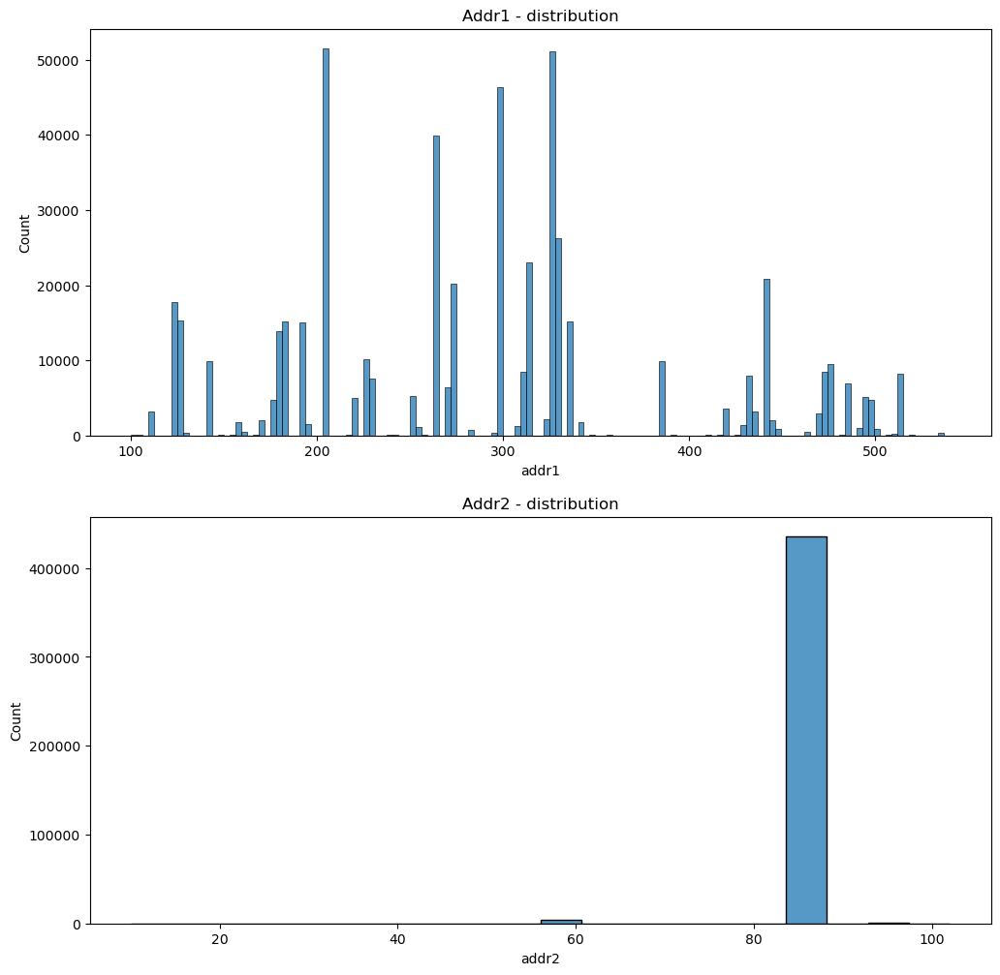

In [40]:
fig, axes = plt.subplots(nrows=2, ncols=1,figsize=(12,12))
sns.histplot(df_train['addr1'],ax=axes[0])
sns.histplot(df_test['addr2'],ax=axes[1])
axes[0].title.set_text('Addr1 - distribution')
axes[1].title.set_text('Addr2 - distribution')
plt.show()

### Analisis Distribusi Fitur Addr1 dan Addr2

#### 1. Distribusi Addr1

Visualisasi distribusi **addr1** menunjukkan pola nilai yang tersebar pada rentang sekitar 100 hingga 550. Beberapa pengamatan penting:

- Distribusi tidak merata; terdapat beberapa **puncak frekuensi** pada nilai tertentu seperti kisaran 200–300 serta sekitar 400–500.
- Nilai addr1 tampak seperti **kode geografis atau lokasi billing**, bukan nilai numerik kontinu, sehingga tidak bersifat linear.
- Banyak nilai dengan frekuensi sangat kecil, menandakan bahwa addr1 memiliki **cardinality tinggi**, yang berarti banyak kategori unik.
- Puncak yang sangat tinggi menunjukkan bahwa lokasi tertentu memiliki jauh lebih banyak transaksi dibanding lokasi lain, yang bisa disebabkan oleh:
  - konsentrasi transaksi pada wilayah geografis tertentu, atau  
  - area yang lebih aktif secara ekonomi.

#### 2. Distribusi Addr2

Pada distribusi **addr2**, terlihat bahwa:

- Hampir seluruh transaksi berada pada satu nilai dominan, yaitu **addr2 ≈ 87**, yang muncul lebih dari 400.000 kali.
- Nilai-nilai addr2 lainnya jumlahnya sangat kecil (hanya sedikit ratusan atau kurang).
- Ini menunjukkan bahwa addr2 adalah fitur dengan **kelas mayoritas ekstrim** dan sangat tidak seimbang.

**Interpretasi:**

- Nilai addr2 kemungkinan besar mewakili kode negara bagian atau region-level yang tidak terlalu bervariasi pada dataset.
- Dominasi addr2=87 menyiratkan bahwa:
  - mayoritas pembeli berasal dari region tertentu, atau
  - data vendor sudah terfilter pada wilayah ini.

## Dist 1 dan Dist2

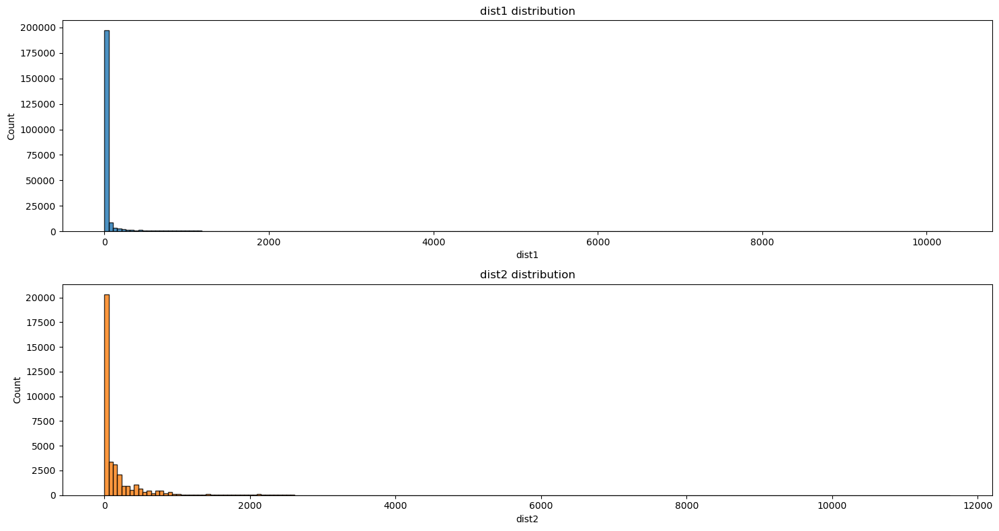

In [41]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(15, 8))

# ----- Dist1 -----
df_train['dist1'].plot(
    kind='hist',
    bins=200,
    ax=axes[0],
    color='tab:blue',
    alpha=0.8,
    edgecolor='black'
)
axes[0].set_title('dist1 distribution')
axes[0].set_xlabel('dist1')
axes[0].set_ylabel('Count')

# ----- Dist2 -----
df_train['dist2'].plot(
    kind='hist',
    bins=200,
    ax=axes[1],
    color='tab:orange',
    alpha=0.8,
    edgecolor='black'
)
axes[1].set_title('dist2 distribution')
axes[1].set_xlabel('dist2')
axes[1].set_ylabel('Count')

plt.tight_layout()
plt.show()

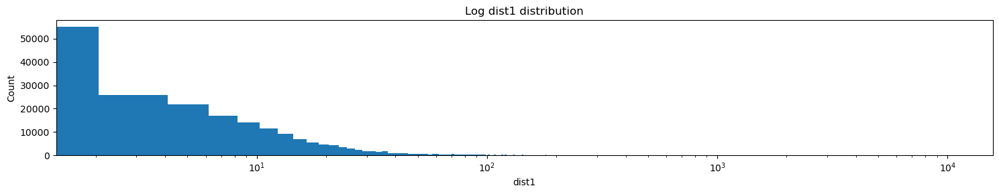

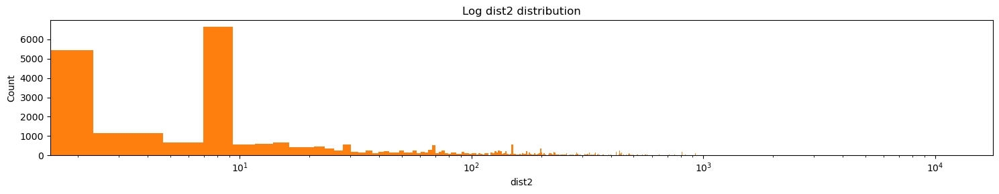

In [42]:
import matplotlib.pyplot as plt

# Ambil daftar warna default matplotlib
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

# dist1
df_train['dist1'].plot(
    kind='hist',
    bins=5000,
    figsize=(15, 3),
    title='Log dist1 distribution',
    color=colors[0],   # warna pertama
    logx=True          # sumbu X log scale
)
plt.xlabel('dist1')
plt.ylabel('Count')
plt.tight_layout()
plt.show()

# dist2
df_train['dist2'].plot(
    kind='hist',
    bins=5000,
    figsize=(15, 3),
    title='Log dist2 distribution',
    color=colors[1],   # warna kedua
    logx=True
)
plt.xlabel('dist2')
plt.ylabel('Count')
plt.tight_layout()
plt.show()

## C1-C14

In [43]:
c_cols = [c for c in df_train if c[0] == 'C']
df_train[c_cols].head()

,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14
0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0
1,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0
2,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0
3,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0
4,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0


In [44]:
# Sample 1000 fraud and 1000 non-fraud examples to plot
sample_df = pd.concat([df_train.loc[df_train['isFraud'] == 0].sample(1000),
                       df_train.loc[df_train['isFraud'] == 1].sample(1000)])

<Figure size 2000x2000 with 0 Axes>

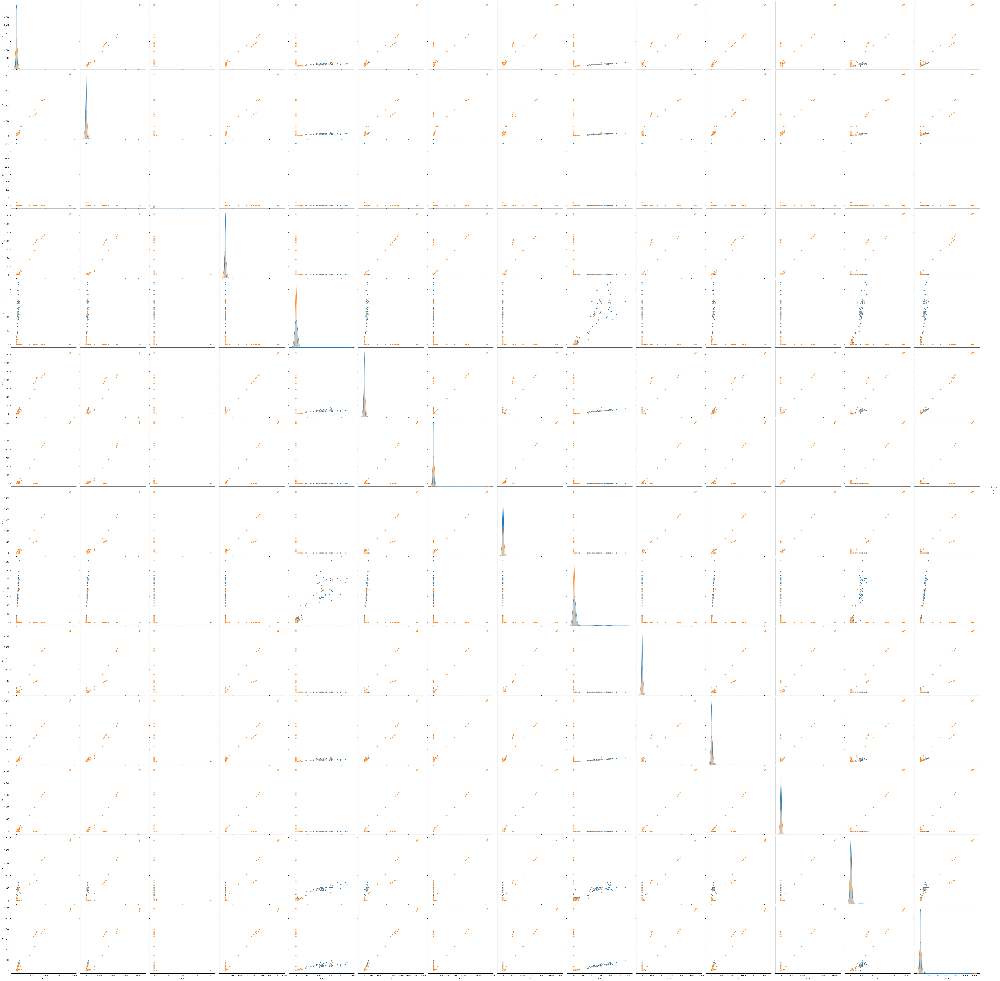

In [45]:
plt.figure(figsize=(20,20))
sns.pairplot(sample_df, 
             hue='isFraud',
            vars=c_cols,height=5)
plt.show()

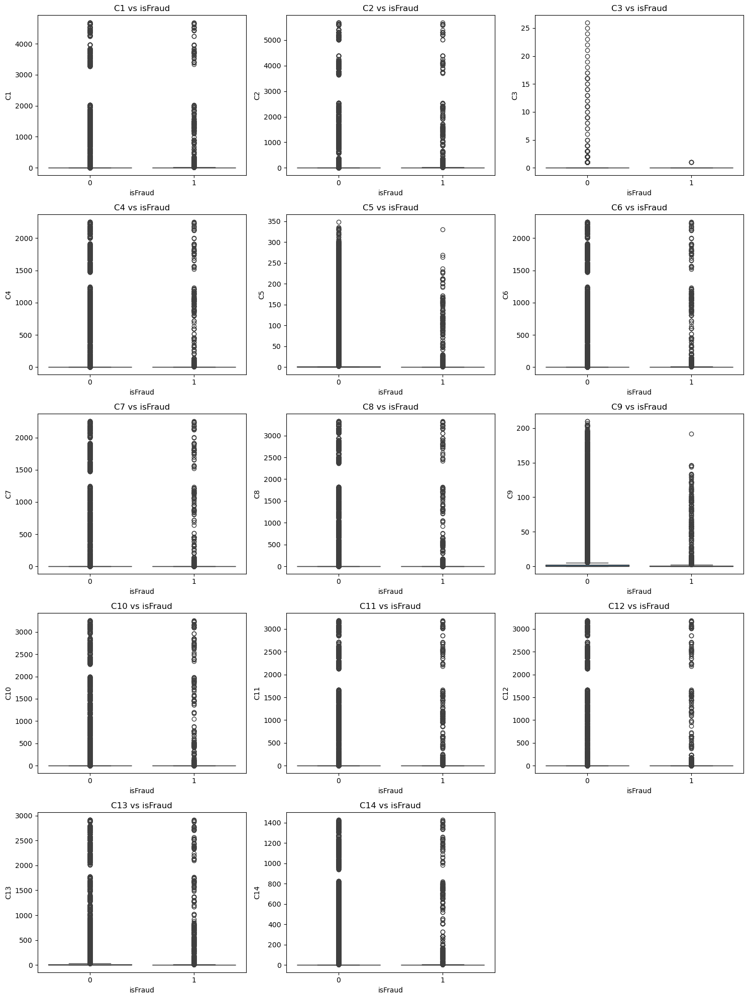

In [46]:
n = len(c_cols)
n_cols = 3
n_rows = int(np.ceil(n / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 4*n_rows))
axes = axes.flatten()

for i, col in enumerate(c_cols):
    sns.boxplot(
        data=df_train,
        x='isFraud',
        y=col,
        ax=axes[i]
    )
    axes[i].set_title(f"{col} vs isFraud")
    axes[i].set_xlabel("isFraud")

for j in range(i+1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()

,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,isFraud
C1,1.000000,0.995089,-0.003467,0.967800,0.165862,0.982238,0.926258,0.967746,0.175999,0.958202,0.996515,0.927939,0.774603,0.951761,0.030570
C2,0.995089,1.000000,-0.003339,0.972134,0.126540,0.974845,0.938867,0.975863,0.133566,0.970624,0.993898,0.940258,0.751221,0.936149,0.037229
C3,-0.003467,-0.003339,1.000000,-0.001720,-0.008101,-0.004711,-0.001730,-0.001203,-0.010074,-0.001494,-0.003584,-0.001763,-0.007747,-0.005091,-0.006833
C4,0.967800,0.972134,-0.001720,1.000000,-0.012842,0.962319,0.895092,0.959995,-0.015970,0.952466,0.974547,0.894619,0.644549,0.907676,0.030382
C5,0.165862,0.126540,-0.008101,-0.012842,1.000000,0.232409,-0.009970,-0.011654,0.925786,-0.011846,0.168862,-0.009875,0.717509,0.378950,-0.030754
C6,0.982238,0.974845,-0.004711,0.962319,0.232409,1.000000,0.858583,0.921972,0.250695,0.914440,0.991105,0.858182,0.808531,0.984201,0.020909
C7,0.926258,0.938867,-0.001730,0.895092,-0.009970,0.858583,1.000000,0.982983,-0.012399,0.985062,0.915209,0.999489,0.632394,0.794701,0.028160
C8,0.967746,0.975863,-0.001203,0.959995,-0.011654,0.921972,0.982983,1.000000,-0.014492,0.996970,0.962722,0.983027,0.653245,0.860246,0.032139
C9,0.175999,0.133566,-0.010074,-0.015970,0.925786,0.250695,-0.012399,-0.014492,1.000000,-0.014731,0.182446,-0.012212,0.704056,0.397396,-0.031704
C10,0.958202,0.970624,-0.001494,0.952466,-0.011846,0.914440,0.985062,0.996970,-0.014731,1.000000,0.956056,0.983817,0.653941,0.853009,0.028396


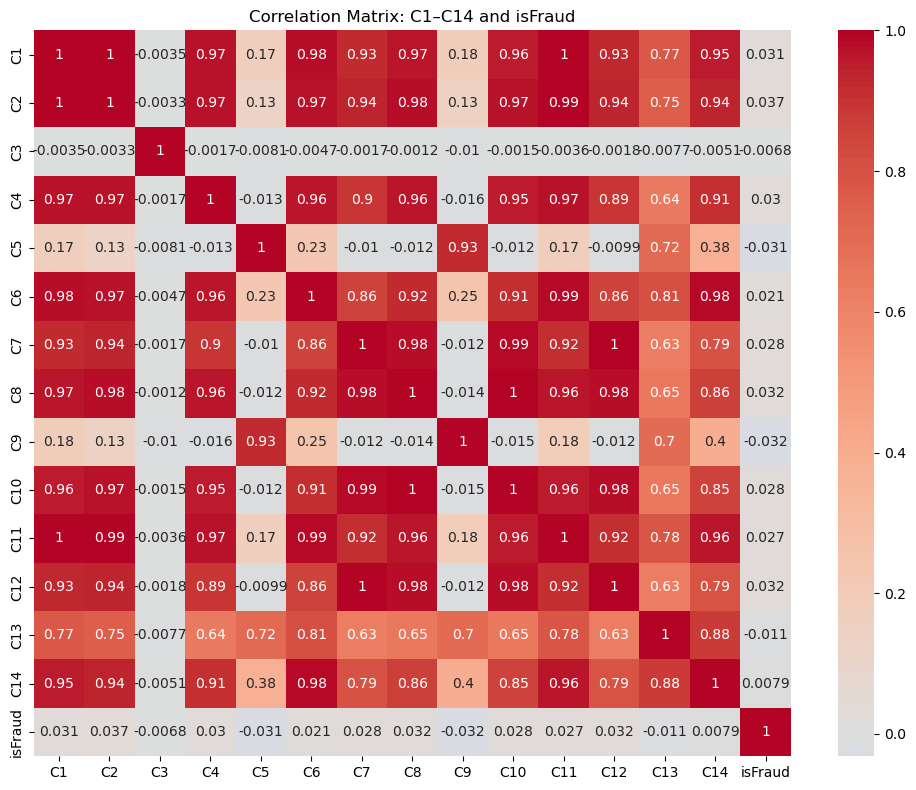

In [47]:
corr_cols = c_cols + ['isFraud']
corr_cols = [c for c in corr_cols if c in df_train.columns]

corr_C = df_train[corr_cols].corr()
display(corr_C)

plt.figure(figsize=(10, 8))
sns.heatmap(corr_C, annot=True, cmap="coolwarm", center=0)
plt.title("Correlation Matrix: C1–C14 and isFraud")
plt.tight_layout()
plt.show()

C2     0.037229
C8     0.032139
C12    0.031905
C1     0.030570
C4     0.030382
C10    0.028396
C7     0.028160
C11    0.027484
C6     0.020909
C14    0.007920
C3    -0.006833
C13   -0.011146
C5    -0.030754
C9    -0.031704
Name: isFraud, dtype: float64

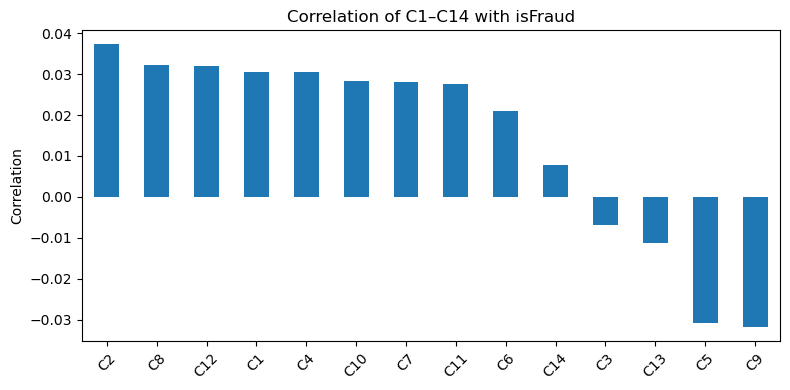

In [48]:
corr_with_target = df_train[c_cols + ['isFraud']].corr()['isFraud'].drop('isFraud')
corr_with_target = corr_with_target.sort_values(ascending=False)
display(corr_with_target)

plt.figure(figsize=(8, 4))
corr_with_target.plot(kind='bar')
plt.title("Correlation of C1–C14 with isFraud")
plt.ylabel("Correlation")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## D1 - D15

Fitur D yang dianalisis: ['D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15']


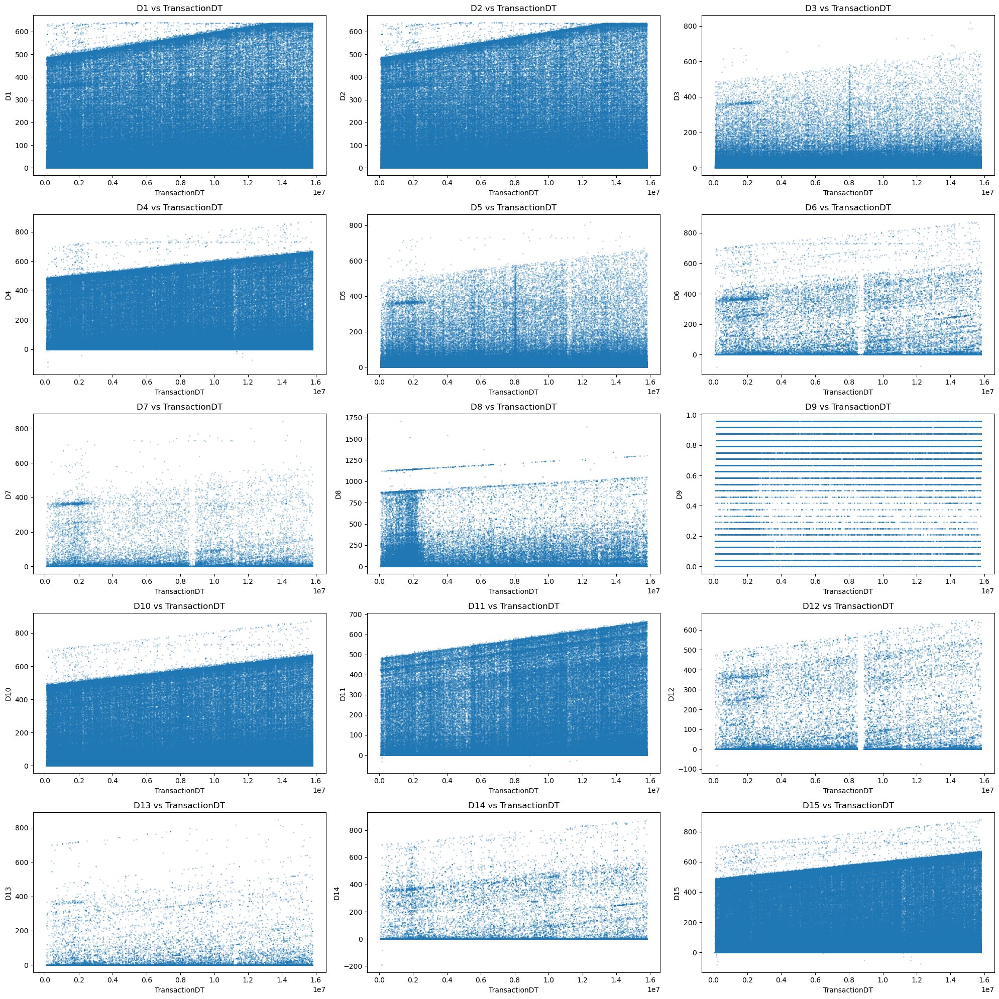

In [49]:
import matplotlib.pyplot as plt

# Daftar kolom D
d_cols = [f"D{i}" for i in range(1, 16) if f"D{i}" in df_train.columns]
print("Fitur D yang dianalisis:", d_cols)

n = len(d_cols)
rows = 5
cols = 3

fig, axes = plt.subplots(rows, cols, figsize=(20, 20))
axes = axes.flatten()

for i, col in enumerate(d_cols):
    axes[i].scatter(
        df_train['TransactionDT'],
        df_train[col],
        s=1,
        alpha=0.25,
        color='tab:blue'
    )
    axes[i].set_title(f'{col} vs TransactionDT')
    axes[i].set_xlabel('TransactionDT')
    axes[i].set_ylabel(col)

for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

In [50]:
import numpy as np

# Normalisasi D1 terhadap TransactionDT
df_train['D1n'] = df_train['D1'] - df_train['TransactionDT'] / np.float32(24 * 60 * 60)

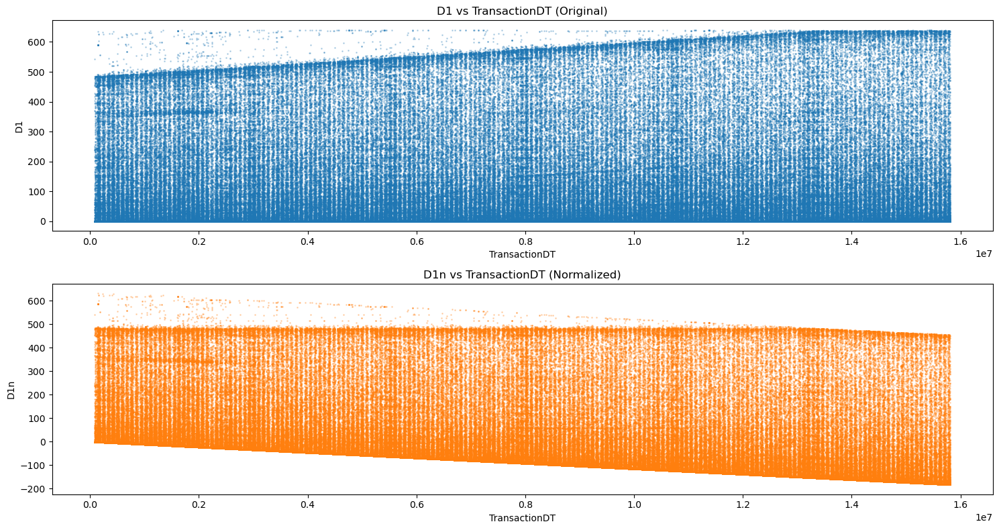

In [51]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 1, figsize=(15, 8))

# Plot D1 asli
axes[0].scatter(
    df_train['TransactionDT'],
    df_train['D1'],
    s=1,
    alpha=0.25,
    color='tab:blue'
)
axes[0].set_title('D1 vs TransactionDT (Original)')
axes[0].set_xlabel('TransactionDT')
axes[0].set_ylabel('D1')

# Plot D1n ter-normalisasi
axes[1].scatter(
    df_train['TransactionDT'],
    df_train['D1n'],
    s=1,
    alpha=0.25,
    color='tab:orange'
)
axes[1].set_title('D1n vs TransactionDT (Normalized)')
axes[1].set_xlabel('TransactionDT')
axes[1].set_ylabel('D1n')

plt.tight_layout()
plt.show()

In [52]:
plt.figure(figsize=(20,20))
sns.pairplot(sample_df, 
             hue='isFraud',
            vars=d_cols,height=5)
plt.show()

<Figure size 2000x2000 with 0 Axes>

## M1 - M9

Fitur M: ['M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9']


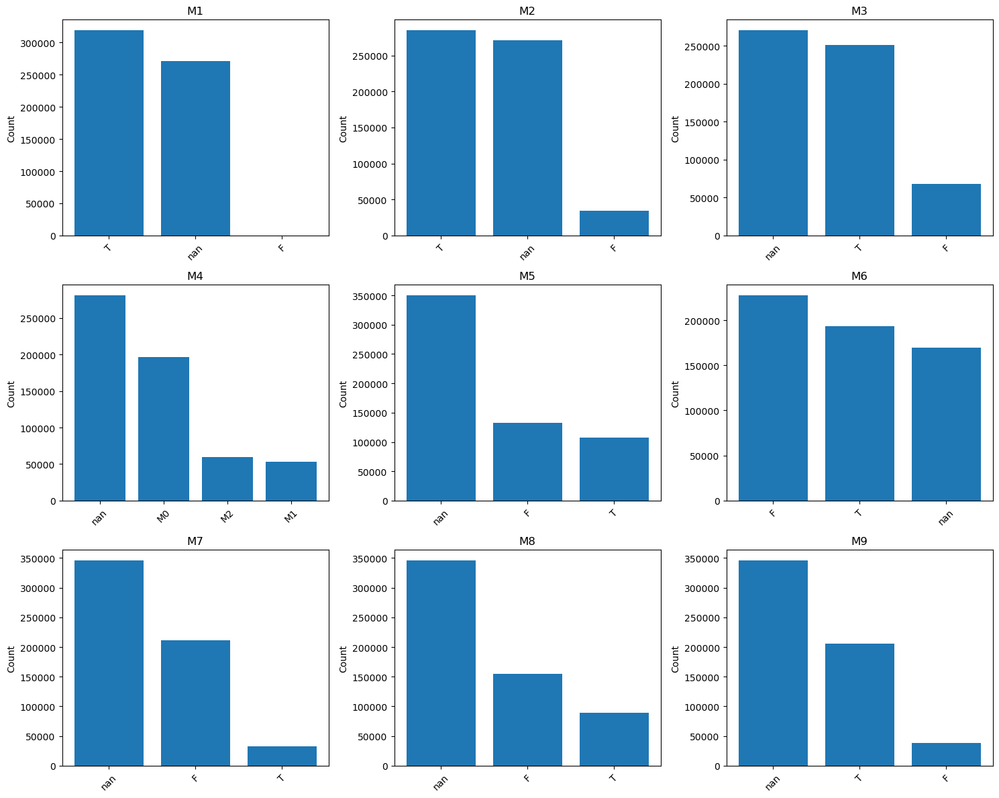

In [53]:
import math
import matplotlib.pyplot as plt

# Ambil semua kolom yang diawali 'M'
m_cols = [m for m in df_train.columns if m.startswith('M')]
print("Fitur M:", m_cols)

# Atur layout grid
n = len(m_cols)
n_cols = 3                         # jumlah kolom subplot
n_rows = math.ceil(n / n_cols)     # jumlah baris subplot

fig, axes = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 4 * n_rows))
axes = axes.flatten()

for i, col in enumerate(m_cols):
    vc = df_train[col].value_counts(dropna=False)

    axes[i].bar(vc.index.astype(str), vc.values)
    axes[i].set_title(col)
    axes[i].set_ylabel("Count")
    axes[i].tick_params(axis='x', rotation=45)

# Kosongkan axis yang tidak terpakai jika jumlah subplot lebih banyak dari jumlah kolom M
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

## V1 - V339

In [54]:
v_cols = [c for c in df_train if c[0] == 'V']
df_train[v_cols].head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [55]:
df_train[v_cols].describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,311251.000000,311251.000000,311251.000000,311251.000000,311251.000000,311251.000000,311251.000000,311251.000000,311251.000000,311251.000000,311251.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,514465.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,421569.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,513442.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,501374.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,590224.000000,81945.000000,81945.000000,81945.000000,81945.000000,81945.000000,81951.000000,81951.000000,81951.000000,81945.000000,81945.000000,81945.000000,81945.000000,81951.000000,81951.000000,81951.000000,81945.000000,81945.000000,81945.000000,81945.000000,81945.000000,81945.000000,81951.000000,81951.000000,81945.000000,81945.000000,81945.000000,81951.000000,81951.000000,81951.000000,139631.000000,139631.000000,139819.000000,139819.000000,139819.000000,139631.000000,139631.000000,139819.000000

## Device Type

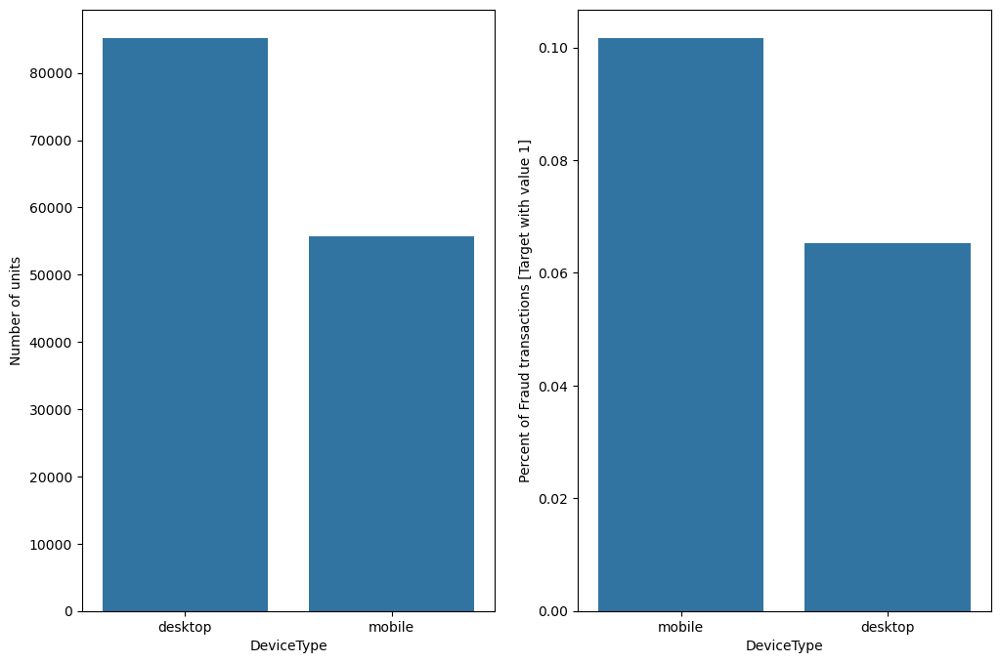

In [56]:
hor_plot('DeviceType',df_train)

In [57]:
tmp = df_train[['DeviceInfo','isFraud']].groupby(by=['DeviceInfo']).mean().sort_values(by='isFraud',ascending=False)
print(tmp[tmp['isFraud'] > 0.9].shape)
tmp[tmp['isFraud'] > 0.9]

(49, 1)


,isFraud
DeviceInfo,
G3123 Build/40.0.A.6.175,1.000000
LGLK430,1.000000
SM-T285M,1.000000
TAB7,1.000000
SM-T530,1.000000
SM-T217S Build/KOT49H,1.000000
Mi,1.000000
Nexus 6 Build/MOB30M,1.000000
A574BL Build/NMF26F,1.000000


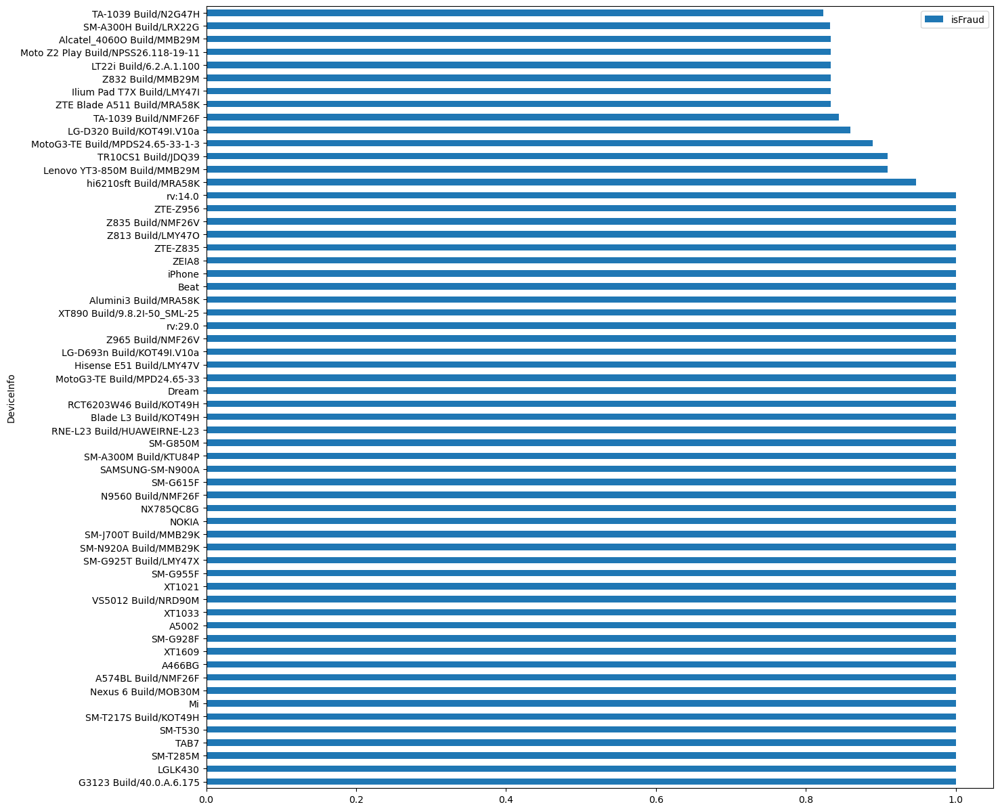

In [58]:
tmp.head(60).plot(kind='barh',figsize=(15, 15))
plt.show()

## 'id_01' - 'id_11';'id_13' - 'id_22'; 'id_24' - 'id_26';'id_32'	

In [59]:
id_cols = (
    [f"id_{i:02d}" for i in range(1, 12)] +    # id_01 - id_11
    [f"id_{i:02d}" for i in range(13, 23)] +   # id_13 - id_22
    [f"id_{i:02d}" for i in range(24, 27)] +   # id_24 - id_26
    ["id_32"]
)

# Filter: ambil hanya yang benar-benar ada di df_train
id_cols = [c for c in id_cols if c in df_train.columns]
print("Identity features analyzed:", id_cols)

Identity features analyzed: ['id_01', 'id_02', 'id_03', 'id_04', 'id_05', 'id_06', 'id_07', 'id_08', 'id_09', 'id_10', 'id_11', 'id_13', 'id_14', 'id_15', 'id_16', 'id_17', 'id_18', 'id_19', 'id_20', 'id_21', 'id_22', 'id_24', 'id_25', 'id_26', 'id_32']


In [60]:
missing_id = df_train[id_cols].isnull().mean() * 100

missing_id_df = pd.DataFrame({
    "feature": id_cols,
    "missing_percent": missing_id.values
})

with pd.option_context("display.max_rows", None):
    display(missing_id_df)

,feature,missing_percent
0,id_01,75.576000
1,id_02,76.145142
2,id_03,88.768885
3,id_04,88.768885
4,id_05,76.823676
5,id_06,76.823676
6,id_07,99.127067
7,id_08,99.127067
8,id_09,87.312247
9,id_10,87.312247


In [61]:
display(df_train[id_cols].describe().T)

,count,mean,std,min,25%,50%,75%,max
id_01,144233.0,-10.170502,14.347949,-100.0,-10.0,-5.0,-5.0,0.0
id_02,140872.0,174716.584708,159651.816856,1.0,67992.0,125800.5,228749.0,999595.0
id_03,66324.0,0.060189,0.598231,-13.0,0.0,0.0,0.0,10.0
id_04,66324.0,-0.058938,0.701015,-28.0,0.0,0.0,0.0,0.0
id_05,136865.0,1.615585,5.249856,-72.0,0.0,0.0,1.0,52.0
id_06,136865.0,-6.698710,16.491104,-100.0,-6.0,0.0,0.0,0.0
id_07,5155.0,13.285354,11.384207,-46.0,5.0,14.0,22.0,61.0
id_08,5155.0,-38.600388,26.084899,-100.0,-48.0,-34.0,-23.0,0.0
id_09,74926.0,0.091023,0.983842,-36.0,0.0,0.0,0.0,25.0
id_10,74926.0,-0.301124,2.789446,-100.0,0.0,0.0,0.0,0.0


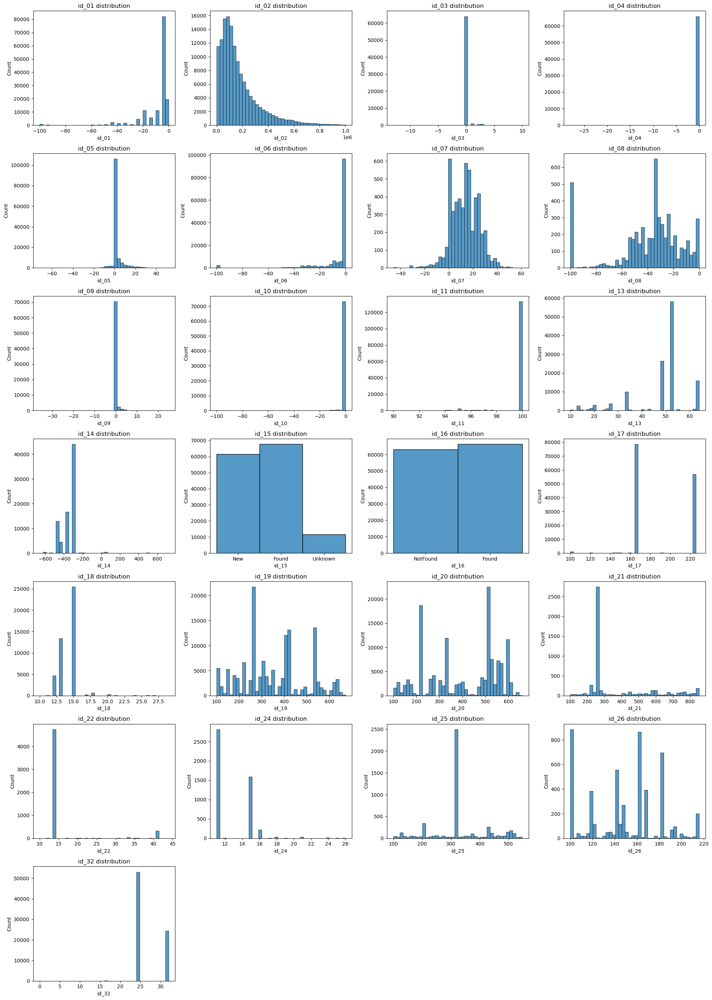

In [62]:
import math
import matplotlib.pyplot as plt
import seaborn as sns

n = len(id_cols)
n_cols = 4
n_rows = math.ceil(n / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
axes = axes.flatten()

for i, col in enumerate(id_cols):
    sns.histplot(
        data=df_train,
        x=col,
        bins=40,
        kde=False,
        ax=axes[i],
        color='tab:blue'
    )
    axes[i].set_title(f"{col} distribution")

# Matikan axis kosong jika jumlah subplot > fitur
for j in range(i + 1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()

## 'id_12'; 'id_15'; 'id_16'; 'id_23'; 'id_27' - 'id_30'; 'id_31'; 'id_33' - id_38'

In [63]:
# Membuat daftar kolom identity yang ingin dianalisis
id_cols_2 = (
    ['id_12', 'id_15', 'id_16', 'id_23'] +
    [f'id_{i}' for i in range(27, 31)] +   # id_27 - id_30
    ['id_31'] +
    [f'id_{i}' for i in range(33, 39)]     # id_33 - id_38
)

# Filter agar hanya kolom yang benar-benar ada di df_train
id_cols_2 = [col for col in id_cols_2 if col in df_train.columns]

print("Identity features analyzed:", id_cols_2)

Identity features analyzed: ['id_12', 'id_15', 'id_16', 'id_23', 'id_27', 'id_28', 'id_29', 'id_30', 'id_31', 'id_33', 'id_34', 'id_35', 'id_36', 'id_37', 'id_38']


In [64]:
missing_id2 = df_train[id_cols_2].isnull().mean() * 100

missing_id2_df = pd.DataFrame({
    "feature": id_cols_2,
    "missing_percent": missing_id2.values
})

with pd.option_context("display.max_rows", None):
    display(missing_id2_df)

,feature,missing_percent
0,id_12,75.576000
1,id_15,76.126007
2,id_16,78.097938
3,id_23,99.124696
4,id_27,99.124696
5,id_28,76.127192
6,id_29,76.127192
7,id_30,86.865367
8,id_31,76.245051
9,id_33,87.589452


In [65]:
display(df_train[id_cols_2].describe().T)

,count,unique,top,freq
id_12,144233,2,NotFound,123025
id_15,140985,3,Found,67728
id_16,129340,2,Found,66324
id_23,5169,3,IP_PROXY:TRANSPARENT,3489
id_27,5169,2,Found,5155
id_28,140978,2,Found,76232
id_29,140978,2,Found,74926
id_30,77565,75,Windows 10,21155
id_31,140282,130,chrome 63.0,22000
id_33,73289,260,1920x1080,16874


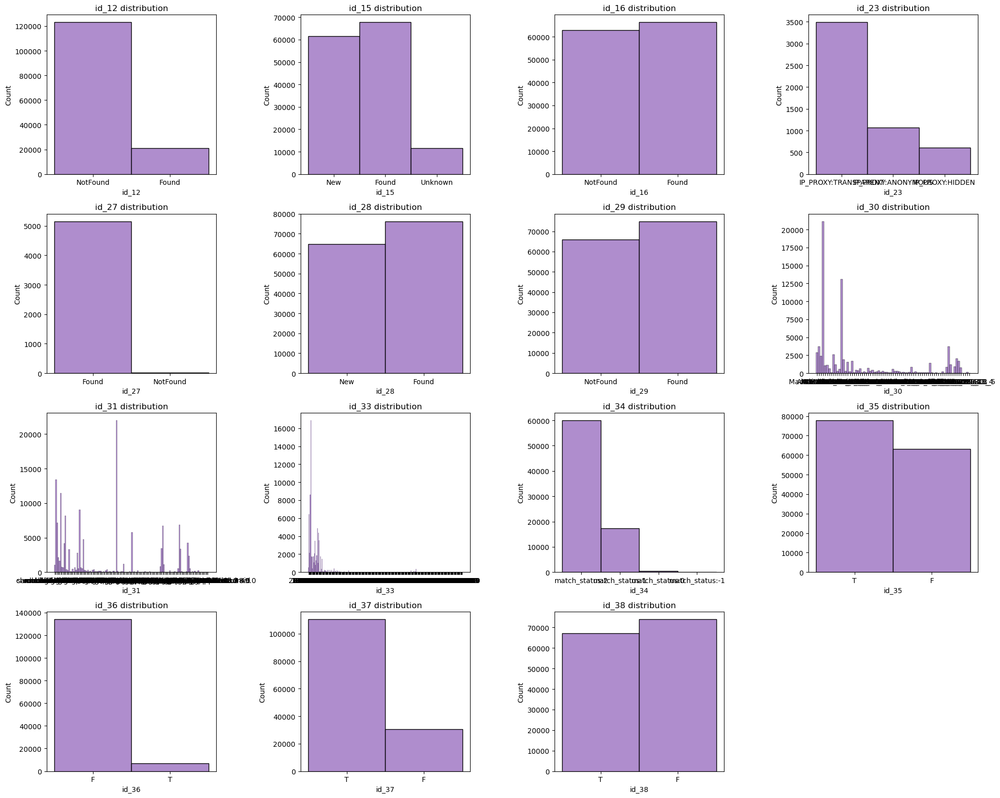

In [66]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

n = len(id_cols_2)
n_cols = 4
n_rows = math.ceil(n / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
axes = axes.flatten()

for i, col in enumerate(id_cols_2):
    sns.histplot(
        data=df_train,
        x=col,
        bins=40,
        kde=False,
        ax=axes[i],
        color='tab:purple'
    )
    axes[i].set_title(f"{col} distribution")

# Matikan axis berlebih
for j in range(i + 1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()

## Correlation Analysis

In [67]:
# Hitung persentase missing setiap kolom
missing_percent = df_train.isnull().mean() * 100

# Buat dataframe hasil missing
df_missing = pd.DataFrame({
    'col': df_train.columns,
    'missing_percent': missing_percent.values
})

# Ambil kolom dengan missing > 50%
missing_cols = df_missing[df_missing['missing_percent'] > 50]['col']

display(df_missing)
print("\nKolom dengan missing > 50%:")
display(missing_cols)

,col,missing_percent
0,TransactionID,0.000000
1,isFraud,0.000000
2,TransactionDT,0.000000
3,TransactionAmt,0.000000
4,ProductCD,0.000000
...,...,...
433,DeviceInfo,79.905442
434,dayofweek,0.000000
435,hour,0.000000
436,minute,0.000000



Kolom dengan missing > 50%:


13             dist1
14             dist2
16     R_emaildomain
35                D5
36                D6
           ...      
429            id_36
430            id_37
431            id_38
432       DeviceType
433       DeviceInfo
Name: col, Length: 214, dtype: object

In [68]:
# Hitung missing value (%) untuk semua kolom
missing_percent = df_train.isnull().mean() * 100

# Ambil hanya kolom dengan missing > 50%
missing_cols = missing_percent[missing_percent > 50].index

# Buat dictionary pengelompokan berdasarkan persentase missing
nan_dict = {}
for col in missing_cols:
    percent = round(missing_percent[col], 2)
    if percent not in nan_dict:
        nan_dict[percent] = []
    nan_dict[percent].append(col)

for percent, cols in sorted(nan_dict.items(), reverse=True):
    print("####" * 4)
    print(f"Missing Percentage = {percent}%")
    print(f"Jumlah kolom: {len(cols)}")
    
    # tampilkan hanya 5 kolom pertama agar tidak scroll
    preview = cols[:5]
    if len(cols) > 5:
        preview.append("...")
    
    print(preview)
    print()

################
Missing Percentage = 99.2%
Jumlah kolom: 1
['id_24']

################
Missing Percentage = 99.13%
Jumlah kolom: 5
['id_07', 'id_08', 'id_21', 'id_25', 'id_26']

################
Missing Percentage = 99.12%
Jumlah kolom: 3
['id_22', 'id_23', 'id_27']

################
Missing Percentage = 93.63%
Jumlah kolom: 1
['dist2']

################
Missing Percentage = 93.41%
Jumlah kolom: 1
['D7']

################
Missing Percentage = 92.36%
Jumlah kolom: 1
['id_18']

################
Missing Percentage = 89.51%
Jumlah kolom: 1
['D13']

################
Missing Percentage = 89.47%
Jumlah kolom: 1
['D14']

################
Missing Percentage = 89.04%
Jumlah kolom: 1
['D12']

################
Missing Percentage = 88.77%
Jumlah kolom: 2
['id_03', 'id_04']

################
Missing Percentage = 87.61%
Jumlah kolom: 1
['D6']

################
Missing Percentage = 87.59%
Jumlah kolom: 1
['id_33']

################
Missing Percentage = 87.31%
Jumlah kolom: 4
['D8', 'D9', 'id_09', 'id

In [69]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def correlation_analysis(cols, title='Correlation Analysis', size=(12, 12)):
    # Pastikan hanya ambil kolom yang ada di df_train
    cols = [c for c in cols if c in df_train.columns]
    cols = sorted(cols)
    
    # Filter hanya kolom numerik untuk menghindari error
    numeric_cols = [c for c in cols if pd.api.types.is_numeric_dtype(df_train[c])]
    
    if len(numeric_cols) < 2:
        print("Tidak cukup kolom numerik untuk korelasi. Kolom numerik yang ditemukan:", numeric_cols)
        return
    
    df_corr = df_train[numeric_cols].corr()
    
    fig, ax = plt.subplots(1, 1, figsize=size)
    sns.heatmap(
        df_corr,
        annot=True,
        cmap='RdBu_r',
        center=0,
        ax=ax
    )
    ax.set_title(title)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

In [70]:
def reduce_groups(grps):
    """
    Memilih 1 kolom terbaik dari setiap grup atribut,
    yaitu kolom dengan jumlah nilai unik (nunique) terbesar.
    
    Parameter:
        grps : list of lists
            Contoh: [['id_01','id_02','id_03'], ['id_12','id_15']]
    
    Return:
        use : list
            Kolom terpilih dari setiap grup
    """
    use = []

    for group in grps:
        max_unique = -1
        best_col = None
        
        for col in group:
            if col not in df_train.columns:
                continue  # skip kolom yang tidak ada

            # hitung nilai unik
            n_unique = df_train[col].nunique(dropna=True)

            if n_unique > max_unique:
                max_unique = n_unique
                best_col = col
        
        if best_col is not None:
            use.append(best_col)
        else:
            use.append("None")  # jika semua kolom kosong/invalid
    
    return use

## V1 - V11

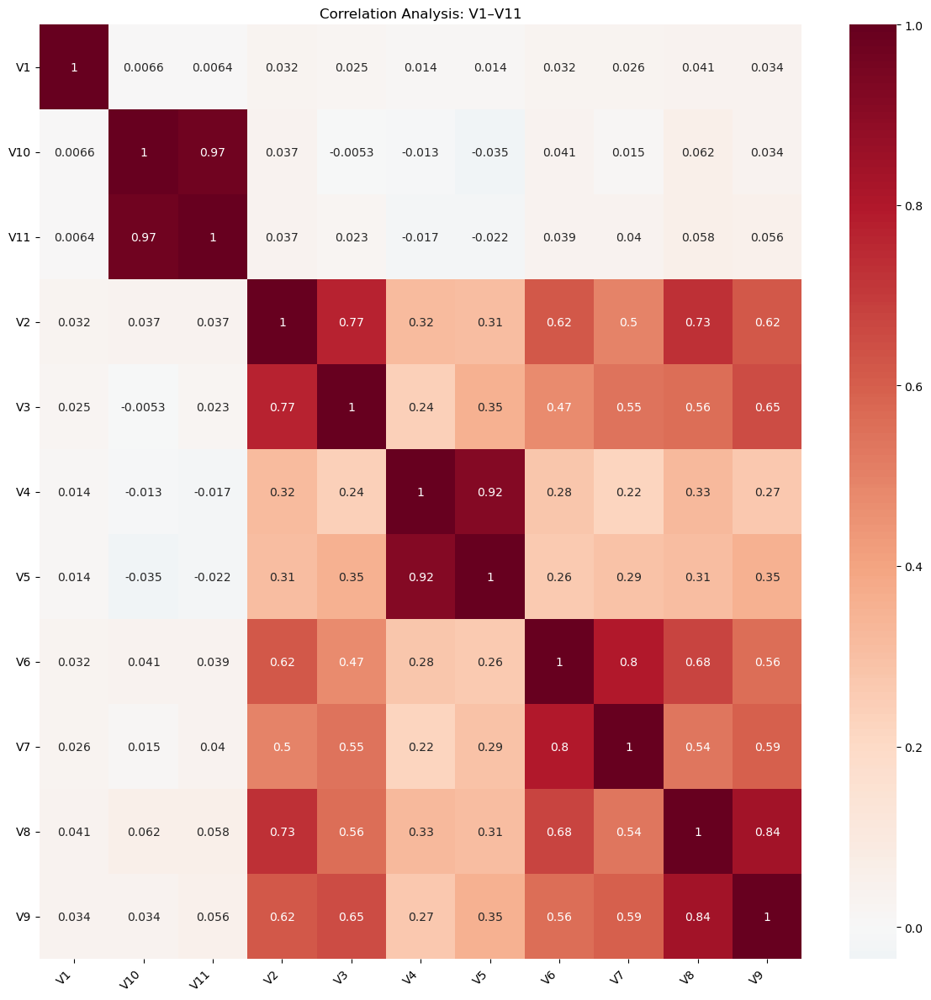

In [71]:
cols = ['V3', 'V9', 'V5', 'V11', 'V10', 'V8', 'V7', 'V6', 'V4', 'V2', 'V1']
correlation_analysis(cols, title='Correlation Analysis: V1–V11')

In [72]:
# Grouping feature V1–V11 sesuai pola yang kamu contohkan
pairs = [
    ['V1'],           # Grup 1
    ['V2', 'V3'],     # Grup 2
    ['V4', 'V5'],     # Grup 3
    ['V6', 'V7'],     # Grup 4
    ['V8', 'V9'],     # Grup 5
    ['V10', 'V11']    # Grup 6
]

# Menjalankan reduce_groups untuk memilih kolom terbaik dari setiap grup
red_cols_group1 = reduce_groups(pairs)
red_cols_group1

['V1', 'V3', 'V4', 'V6', 'V8', 'V11']

## V12 - V34

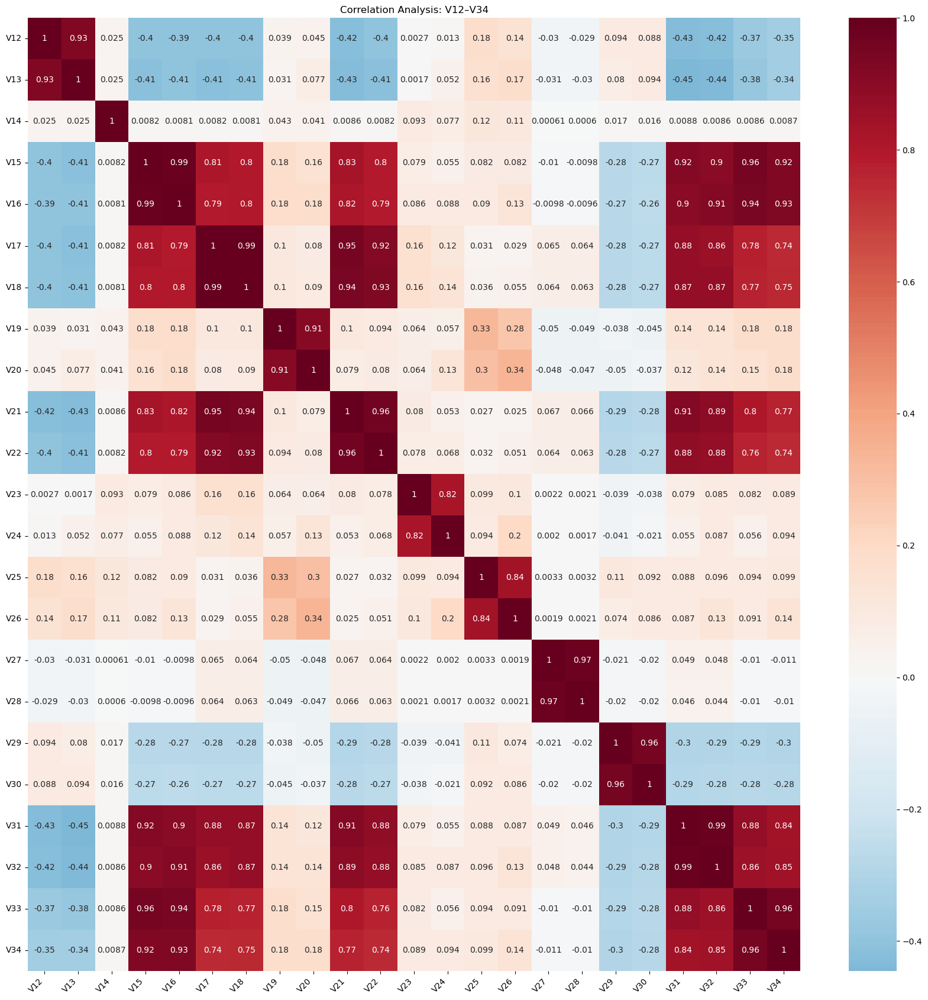

In [73]:
cols = [
    'V21', 'V22', 'V23', 'V34', 'V33', 'V32', 'V31',
    'V30', 'V29', 'V28', 'V27', 'V25', 'V24', 'V26', 
    'V16', 'V15', 'V20', 'V14', 'V19', 'V18', 'V17', 
    'V12', 'V13'
]

correlation_analysis(cols, title='Correlation Analysis: V12–V34', size=(17,17))

In [74]:
pairs = [
    ['V12', 'V13'],                                # group A
    ['V14', 'V15'],                                # group B
    ['V16', 'V17', 'V18'],                         # group C
    ['V19', 'V20'],                                # group D
    ['V21', 'V22', 'V31', 'V32', 'V33', 'V34'],    # group E (cluster besar)
    ['V23', 'V24'],                                # group F
    ['V25', 'V26'],                                # group G
    ['V27', 'V28'],                                # group H
    ['V29', 'V30']                                 # group I
]

red_cols = reduce_groups(pairs)
red_cols

['V13', 'V15', 'V17', 'V20', 'V32', 'V23', 'V26', 'V27', 'V30']

## V35 -V52

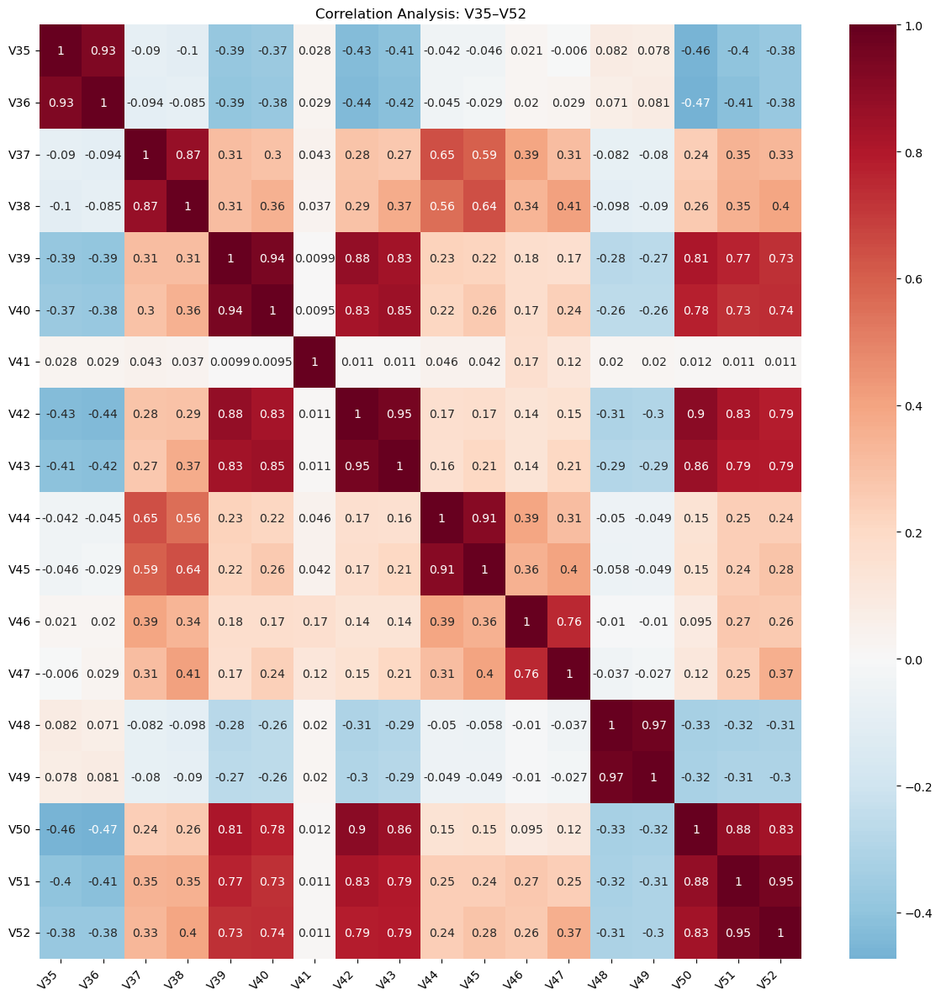

In [75]:
cols = [
    'V35', 'V36', 'V37', 'V38',
    'V39', 'V40', 'V41',
    'V42', 'V43',
    'V44', 'V45',
    'V46', 'V47',
    'V48', 'V49', 'V50',
    'V51', 'V52'
]

correlation_analysis(cols, title='Correlation Analysis: V35–V52', size=(12, 12))

In [76]:
pairs = [
    ['V35', 'V36', 'V37', 'V38'],   # grup 1
    ['V39', 'V40', 'V41'],          # grup 2
    ['V42', 'V43'],                 # grup 3
    ['V44', 'V45'],                 # grup 4
    ['V46', 'V47'],                 # grup 5
    ['V48', 'V49', 'V50'],          # grup 6
    ['V51', 'V52']                  # grup 7
]

red_cols_group2 = reduce_groups(pairs)
red_cols_group2

['V37', 'V40', 'V42', 'V44', 'V47', 'V48', 'V52']

## V52 - V74

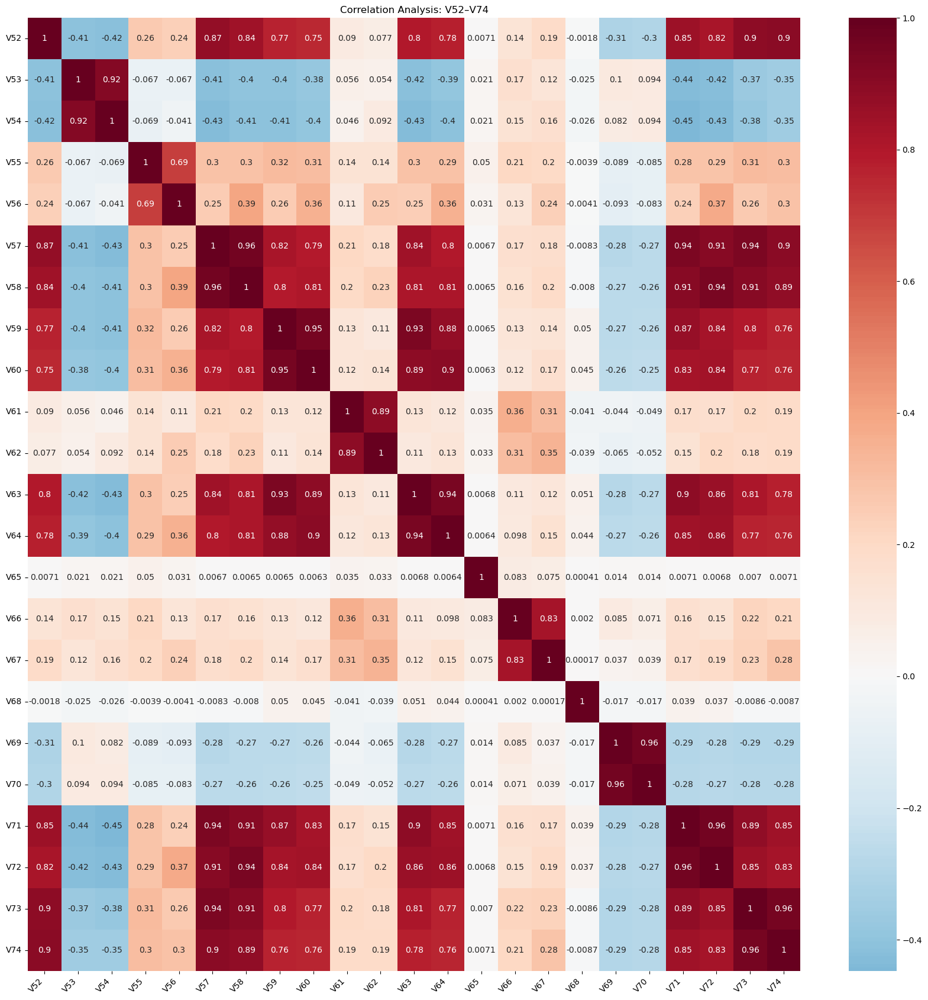

In [77]:
cols = [
    'V52', 'V53', 'V54', 'V55', 'V56', 'V57',
    'V58', 'V59', 'V60', 'V61', 'V62', 'V63',
    'V64', 'V65', 'V66', 'V67', 'V68', 'V69',
    'V70', 'V71', 'V72', 'V73', 'V74'
]

correlation_analysis(cols, title='Correlation Analysis: V52–V74', size=(17, 17))

In [78]:
pairs = [
    ['V52', 'V53'],          # group 1
    ['V54', 'V55'],          # group 2
    ['V56', 'V57'],          # group 3
    ['V58', 'V59'],          # group 4
    ['V60', 'V61'],          # group 5
    ['V62', 'V63'],          # group 6
    ['V64', 'V65'],          # group 7
    ['V66', 'V67'],          # group 8
    ['V68', 'V69'],          # group 9
    ['V70', 'V71', 'V72', 'V73', 'V74']   # group 10
]

red_cols_group3 = reduce_groups(pairs)
red_cols_group3


['V52', 'V55', 'V56', 'V59', 'V60', 'V62', 'V64', 'V67', 'V69', 'V72']

## V75-V94

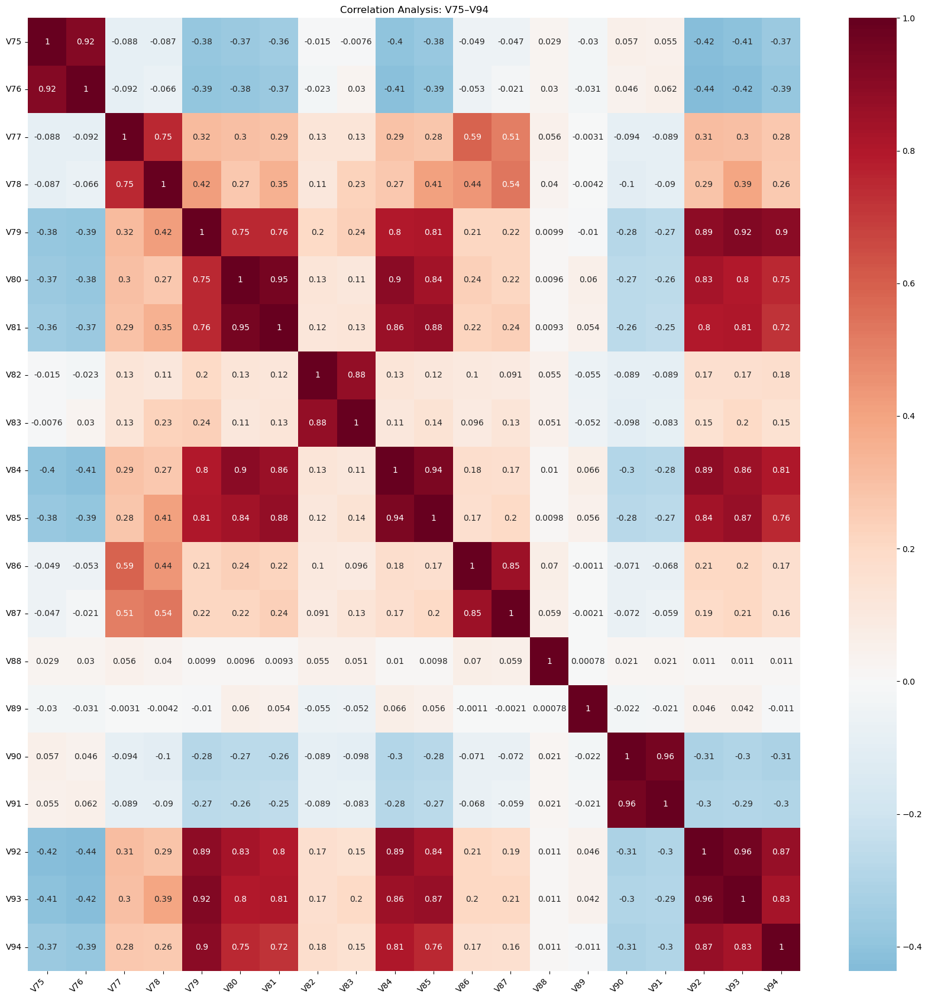

In [79]:
cols = [
    'V75','V76','V77','V78','V79','V80','V81','V82','V83','V84',
    'V85','V86','V87','V88','V89','V90','V91','V92','V93','V94'
]

correlation_analysis(cols, title='Correlation Analysis: V75–V94', size=(17, 17))

In [80]:
pairs = [
    ['V75', 'V76'],                
    ['V77', 'V78'],              
    ['V79', 'V80', 'V81', 'V82'],   
    ['V83', 'V84'],                
    ['V85', 'V86', 'V87', 'V88'], 
    ['V89', 'V90', 'V91', 'V92'], 
    ['V93', 'V94']                 
]

red_cols_group4 = reduce_groups(pairs)
red_cols_group4

['V76', 'V78', 'V80', 'V83', 'V86', 'V92', 'V93']

## V94 - V137

### V95 - V107

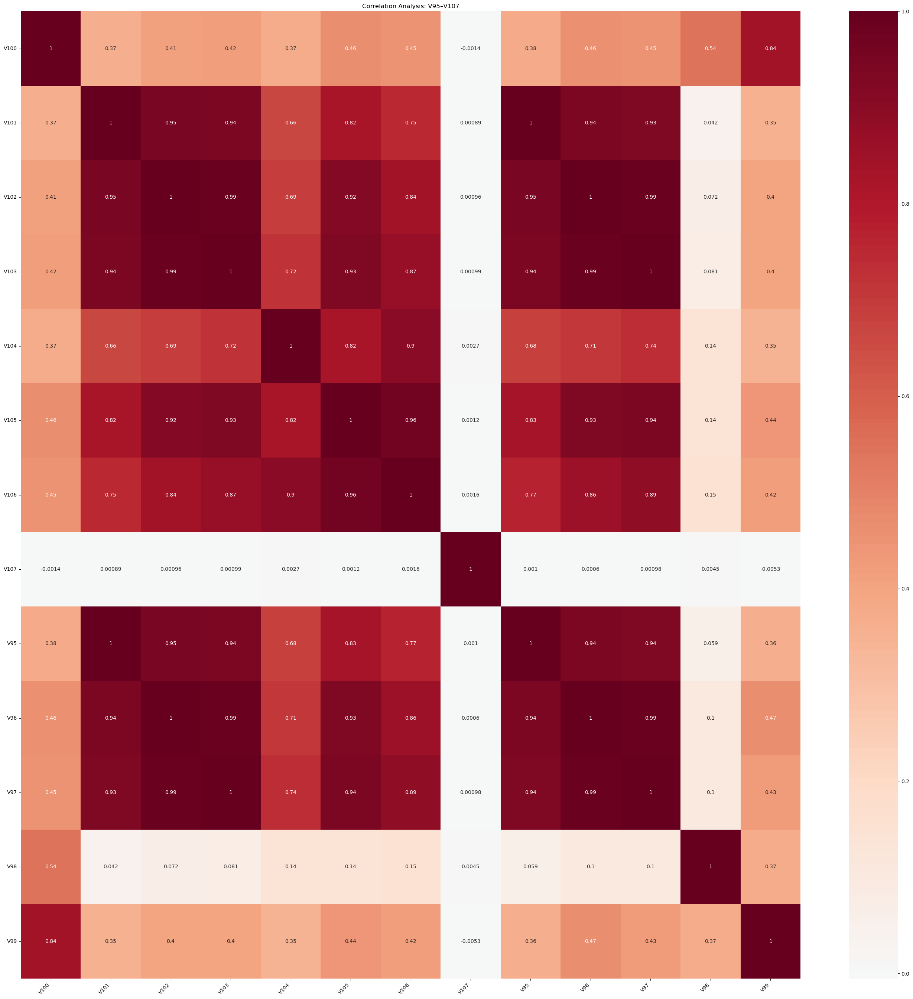

In [81]:
cols = [f"V{x}" for x in range(95, 108)]
correlation_analysis(cols, title='Correlation Analysis: V95–V107', size=(27, 27))

In [82]:
pairs = [
    ['V95','V96'], ['V97','V98'], ['V99','V100'],
    ['V101','V102'], ['V103','V104'], ['V105','V106','V107']
]

red_cols_1 = reduce_groups(pairs)
red_cols_1

['V96', 'V97', 'V99', 'V102', 'V103', 'V105']

### V108 - V121

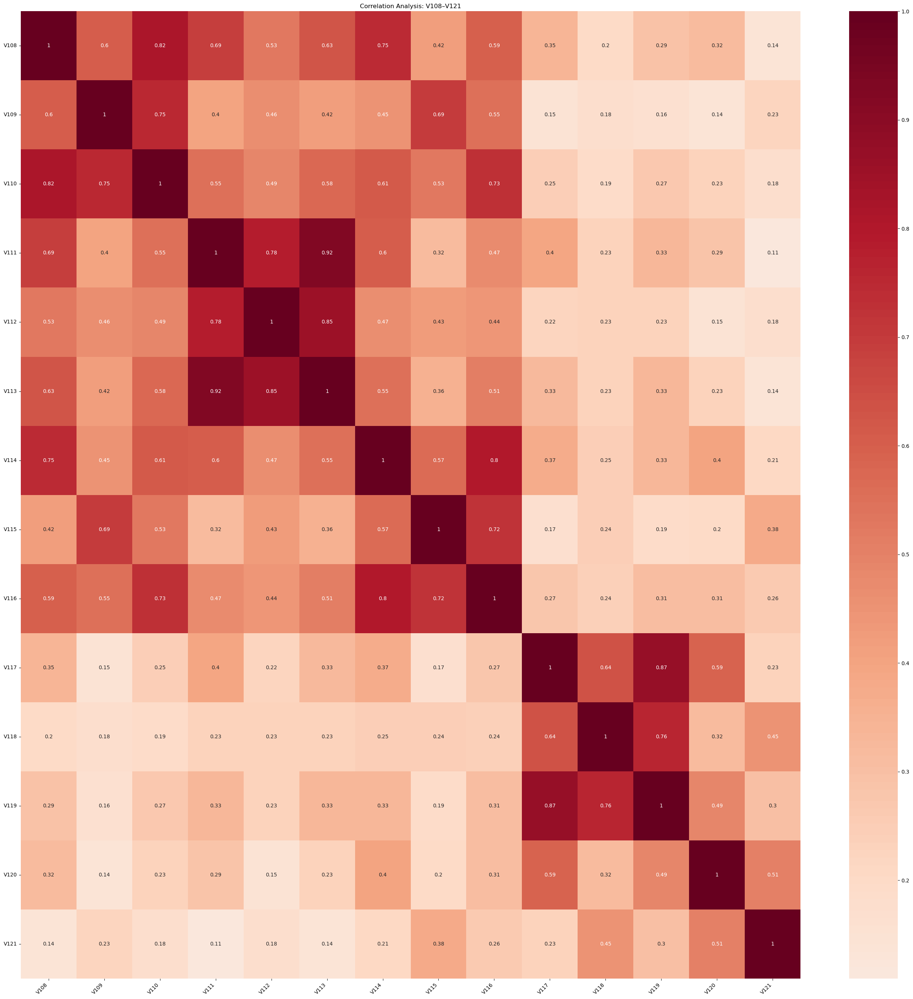

In [83]:
cols = [f"V{x}" for x in range(108, 122)]
correlation_analysis(cols, title='Correlation Analysis: V108–V121', size=(27, 27))

In [84]:
pairs = [
    ['V108','V109'], ['V110','V111'], ['V112','V113'],
    ['V114','V115'], ['V116','V117'], ['V118','V119'],
    ['V120','V121']
]

red_cols_2 = reduce_groups(pairs)
red_cols_2

['V108', 'V111', 'V112', 'V114', 'V116', 'V118', 'V120']

### V122 - V137

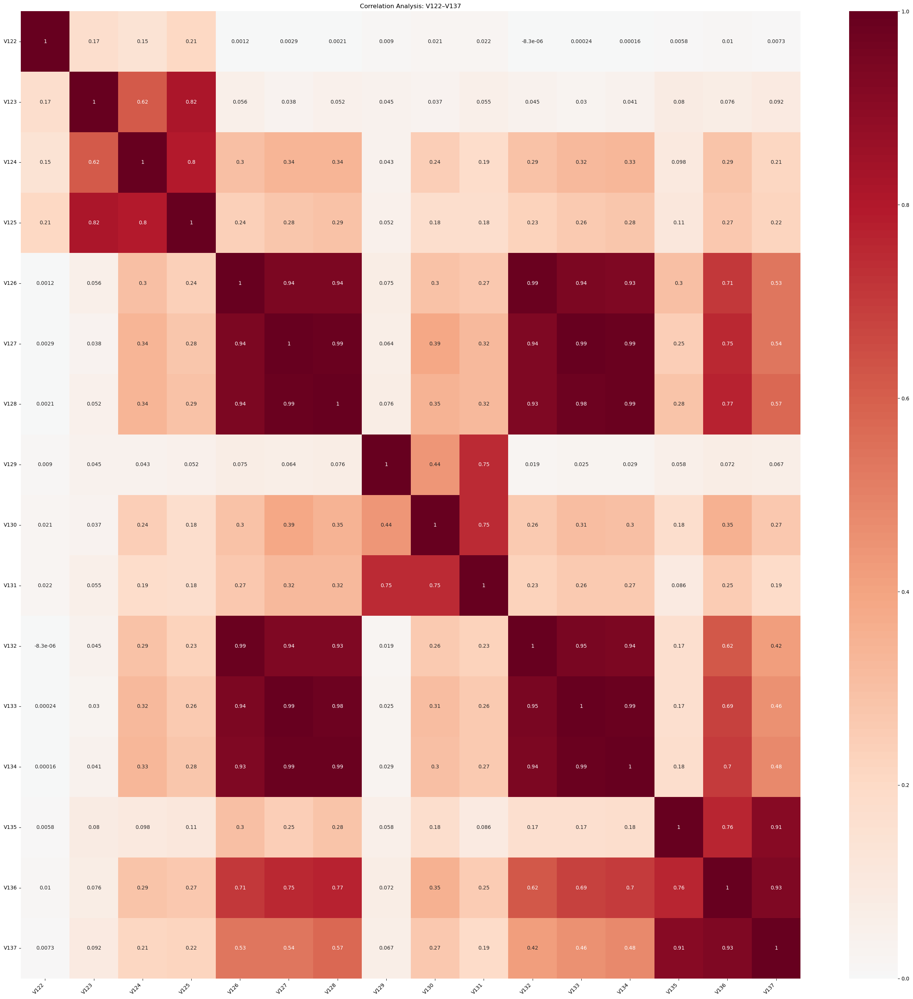

In [85]:
cols = [f"V{x}" for x in range(122, 138)]
correlation_analysis(cols, title='Correlation Analysis: V122–V137', size=(27, 27))

In [86]:
pairs = [
    ['V122','V123'], ['V124','V125'], ['V126','V127'],
    ['V128','V129','V130'], ['V131','V132'], ['V133','V134'],
    ['V135','V136','V137']
]

red_cols_3 = reduce_groups(pairs)
red_cols_3

['V123', 'V124', 'V127', 'V128', 'V132', 'V133', 'V136']

In [87]:
red_cols_group5 = red_cols_1 + red_cols_2 + red_cols_3
red_cols_group5

['V96',
 'V97',
 'V99',
 'V102',
 'V103',
 'V105',
 'V108',
 'V111',
 'V112',
 'V114',
 'V116',
 'V118',
 'V120',
 'V123',
 'V124',
 'V127',
 'V128',
 'V132',
 'V133',
 'V136']

## V138 - V163

### V138 - V147

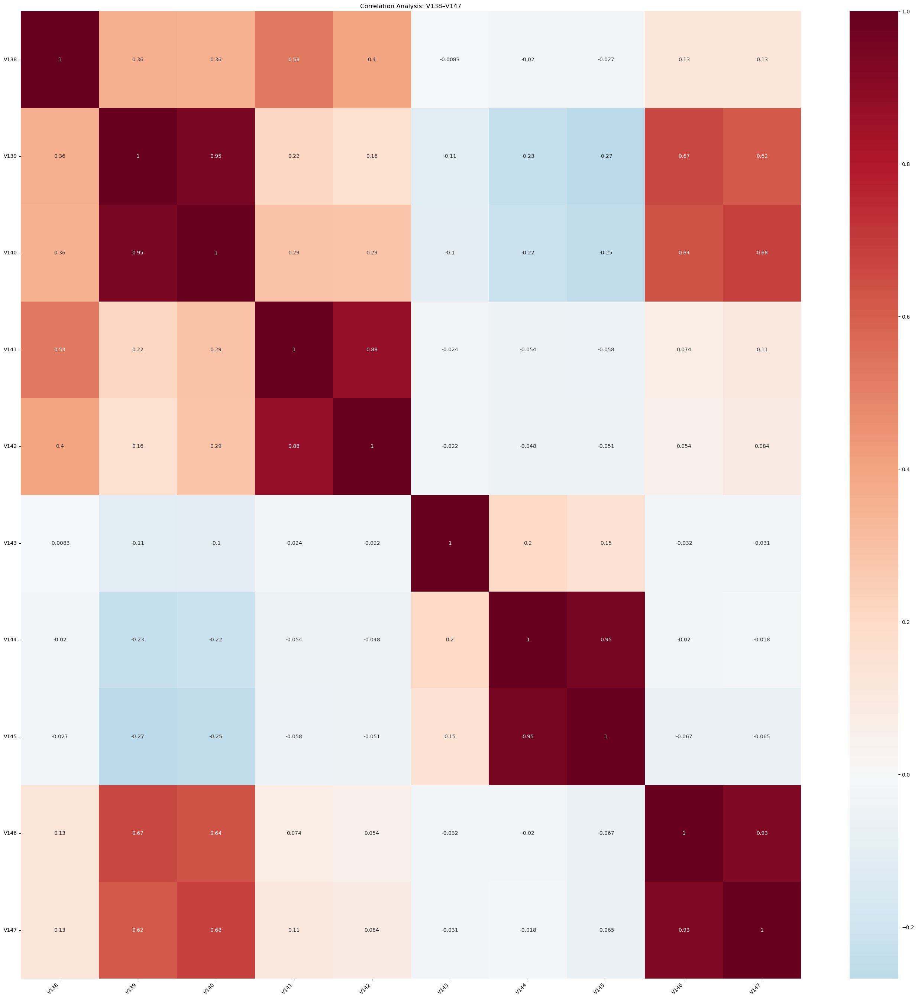

In [88]:
cols = [f"V{x}" for x in range(138, 148)]
correlation_analysis(cols, title='Correlation Analysis: V138–V147', size=(27, 27))

In [89]:
pairs = [
    ['V138','V139'],
    ['V140','V141'],
    ['V142','V143'],
    ['V144','V145'],
    ['V146','V147']
]

red_cols_1 = reduce_groups(pairs)
red_cols_1

['V139', 'V140', 'V143', 'V145', 'V147']

### V148 - V155

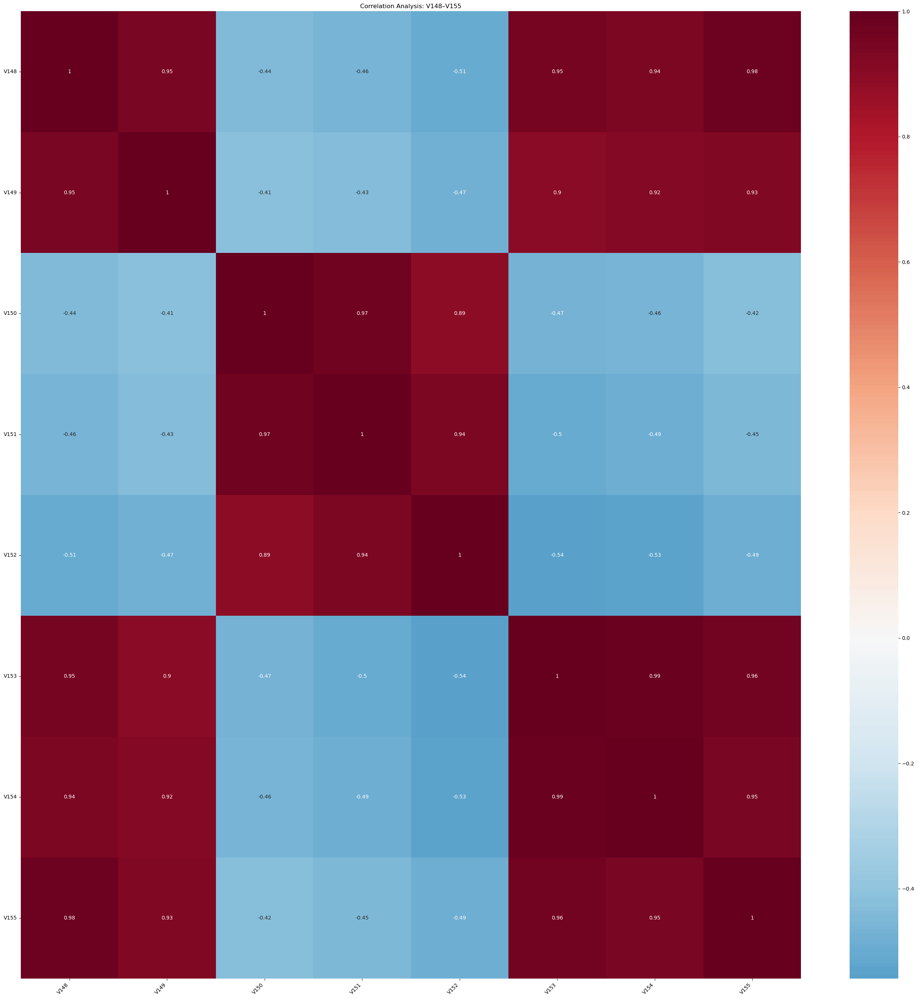

In [90]:
cols = [f"V{x}" for x in range(148, 156)]
correlation_analysis(cols, title='Correlation Analysis: V148–V155', size=(27, 27))

In [91]:
pairs = [
    ['V148','V149'],
    ['V150','V151'],
    ['V152','V153','V154'],
    ['V155']
]

red_cols_2 = reduce_groups(pairs)
red_cols_2

['V148', 'V150', 'V152', 'V155']

### V156 - V163

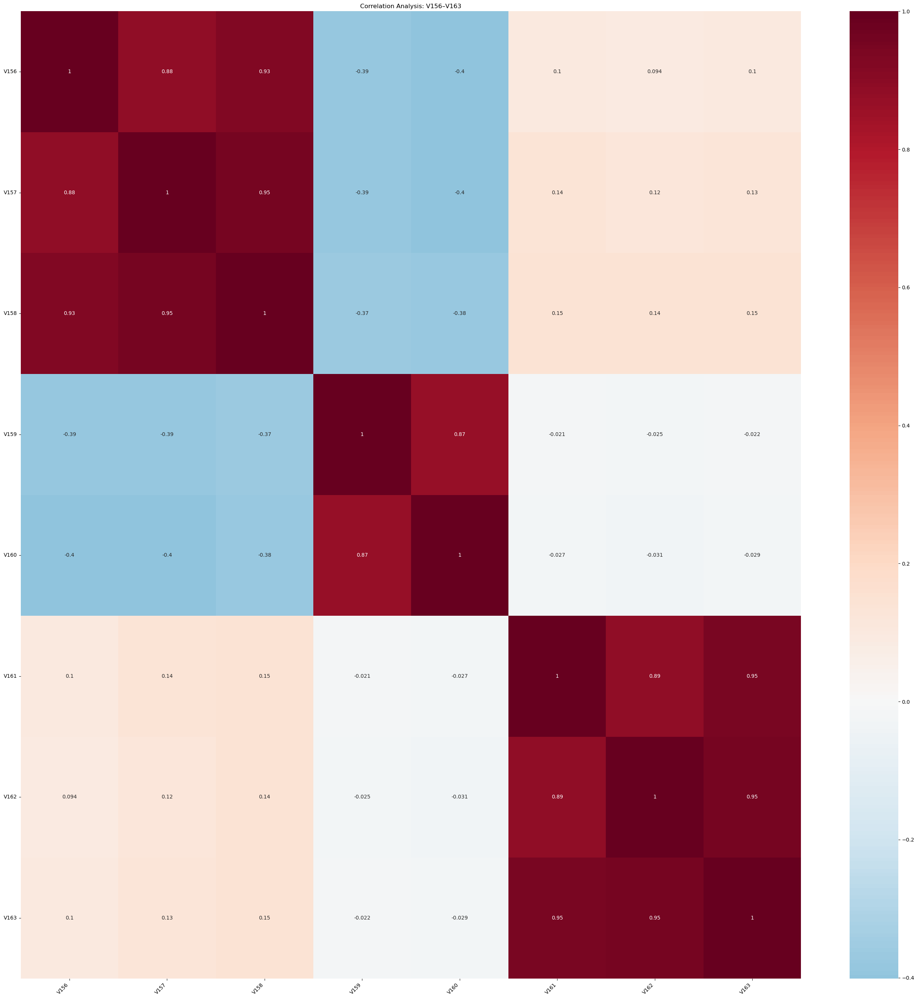

In [92]:
cols = [f"V{x}" for x in range(156, 164)]
correlation_analysis(cols, title='Correlation Analysis: V156–V163', size=(27, 27))

In [93]:
pairs = [
    ['V156','V157'],
    ['V158','V159'],
    ['V160','V161','V162','V163']
]

red_cols_3 = reduce_groups(pairs)
red_cols_3

['V156', 'V159', 'V160']

In [94]:
red_cols_group6 = red_cols_1 + red_cols_2 + red_cols_3
red_cols_group6

['V139',
 'V140',
 'V143',
 'V145',
 'V147',
 'V148',
 'V150',
 'V152',
 'V155',
 'V156',
 'V159',
 'V160']

## V138 - V163

### V138 - V147

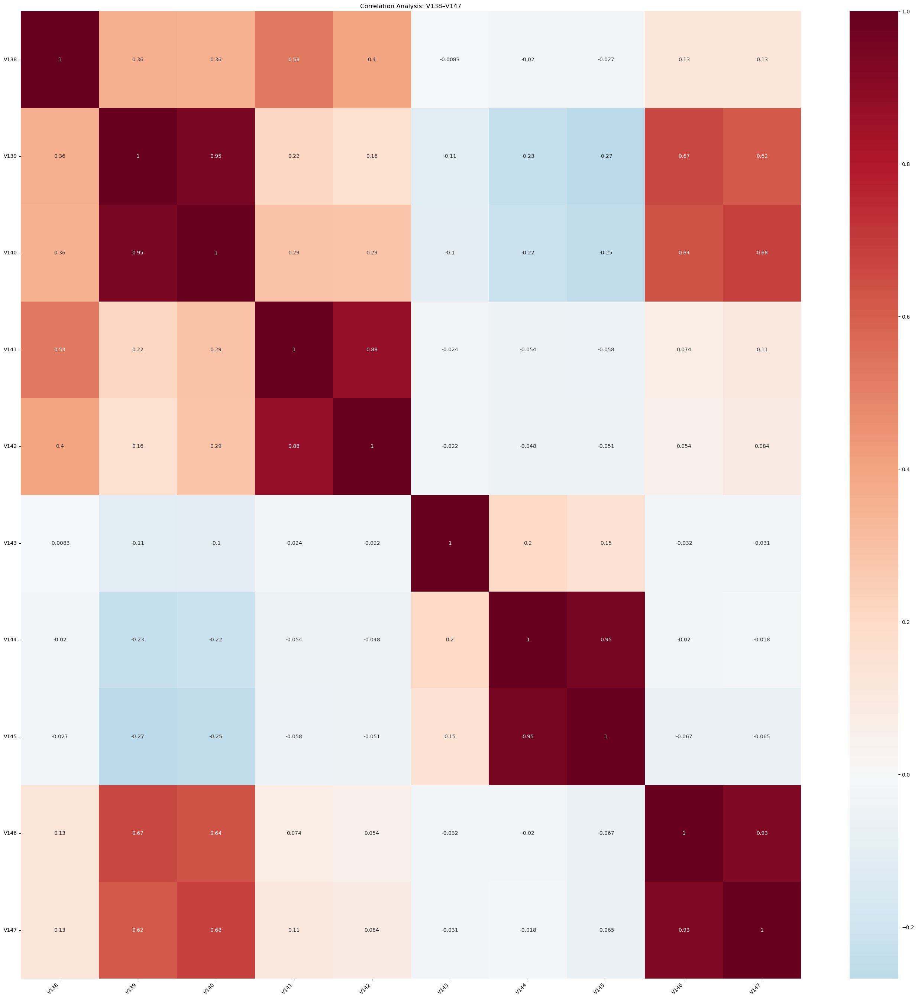

In [95]:
cols = [f'V{x}' for x in range(138, 148)]
correlation_analysis(cols, title='Correlation Analysis: V138–V147', size=(27,27))

In [96]:
pairs = [
    ['V138','V139'],
    ['V140','V141'],
    ['V142','V143'],
    ['V144','V145'],
    ['V146','V147']
]

red_cols_1 = reduce_groups(pairs)
red_cols_1

['V139', 'V140', 'V143', 'V145', 'V147']

### V148 - V155

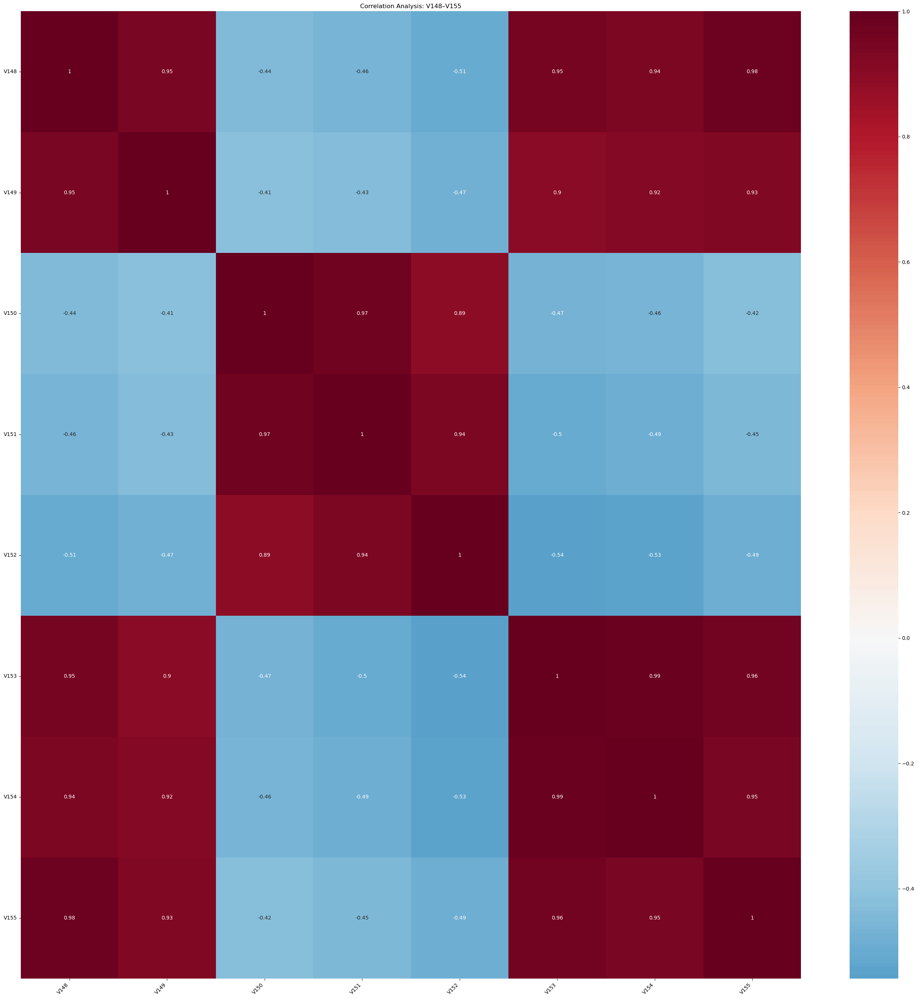

In [97]:
cols = [f'V{x}' for x in range(148, 156)]
correlation_analysis(cols, title='Correlation Analysis: V148–V155', size=(27,27))

In [98]:
pairs = [
    ['V148','V149'],
    ['V150','V151'],
    ['V152','V153','V154'],
    ['V155']
]

red_cols_2 = reduce_groups(pairs)
red_cols_2

['V148', 'V150', 'V152', 'V155']

### V156 - V163

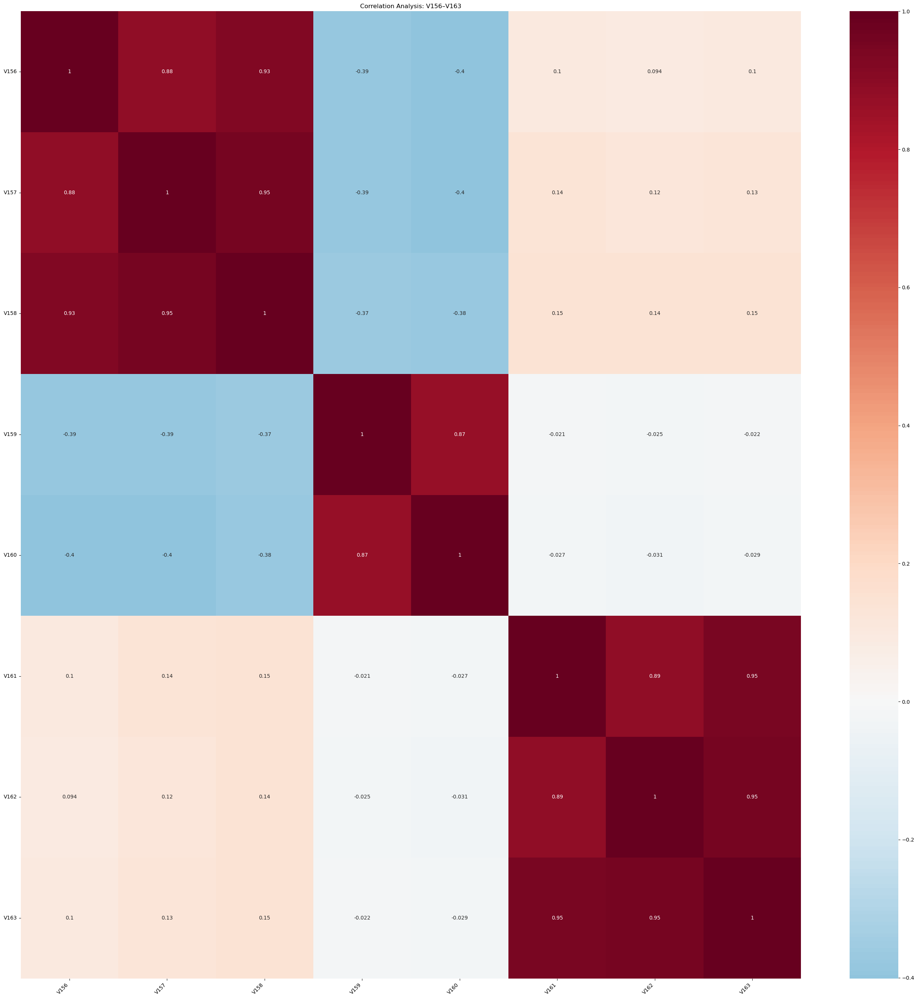

In [99]:
cols = [f'V{x}' for x in range(156, 164)]
correlation_analysis(cols, title='Correlation Analysis: V156–V163', size=(27,27))

In [100]:
pairs = [
    ['V156','V157'],
    ['V158','V159'],
    ['V160','V161','V162','V163']
]

red_cols_3 = reduce_groups(pairs)
red_cols_3

['V156', 'V159', 'V160']

In [101]:
red_cols_group7 = red_cols_1 + red_cols_2 + red_cols_3
red_cols_group7

['V139',
 'V140',
 'V143',
 'V145',
 'V147',
 'V148',
 'V150',
 'V152',
 'V155',
 'V156',
 'V159',
 'V160']

## V164 - V216

### V 164 - V187

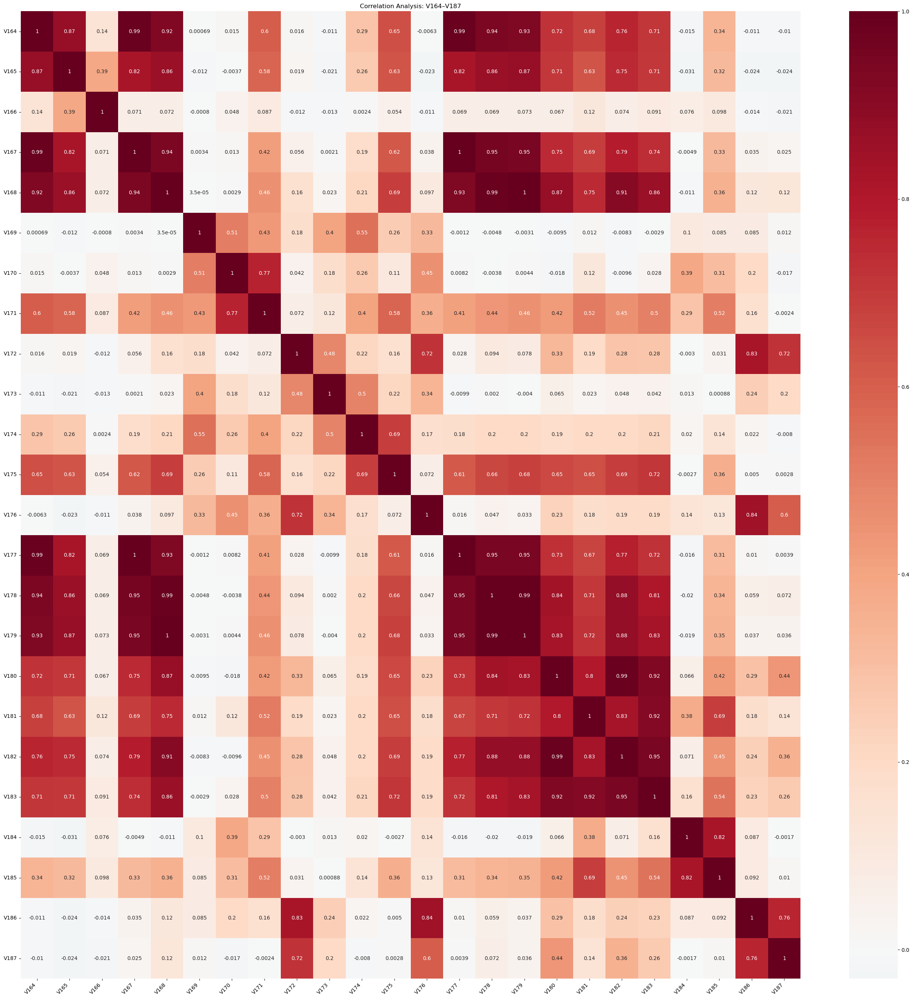

In [102]:
cols = [f"V{x}" for x in range(164, 188)]
correlation_analysis(cols, title='Correlation Analysis: V164–V187', size=(27,27))

In [103]:
pairs = [
    ['V164','V165'], ['V166','V167'], ['V168','V169'], ['V170','V171'],
    ['V172','V173'], ['V174','V175'], ['V176','V177'], ['V178','V179'],
    ['V180','V181'], ['V182','V183'], ['V184','V185'], ['V186','V187']
]

red_cols_A = reduce_groups(pairs)
red_cols_A

['V165',
 'V166',
 'V168',
 'V171',
 'V172',
 'V175',
 'V177',
 'V178',
 'V180',
 'V182',
 'V185',
 'V187']

### V188 - V202

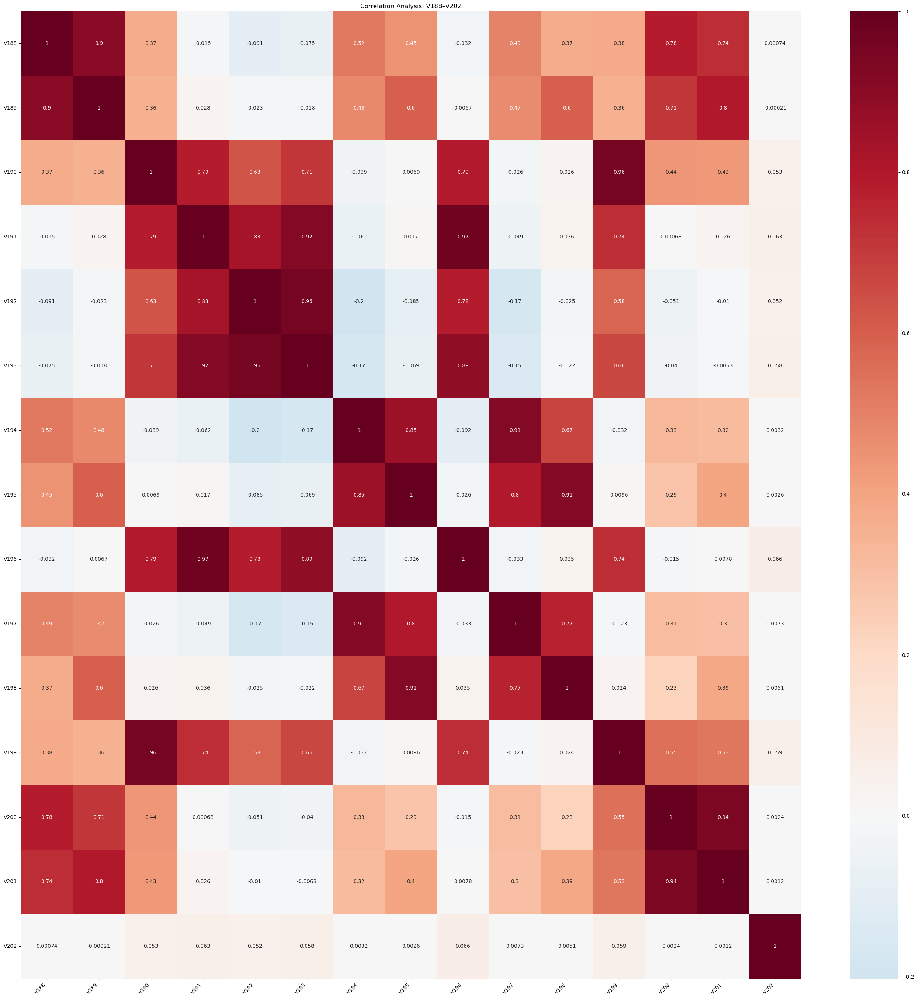

In [104]:
cols = [f"V{x}" for x in range(188, 203)]
correlation_analysis(cols, title='Correlation Analysis: V188–V202', size=(27,27))

In [105]:
pairs = [
    ['V188','V189'], ['V190','V191'], ['V192','V193'], ['V194','V195'],
    ['V196','V197'], ['V198','V199'], ['V200','V201'], ['V202']
]

red_cols_B = reduce_groups(pairs)
red_cols_B

['V188', 'V190', 'V192', 'V195', 'V196', 'V199', 'V201', 'V202']

### V203 - V216

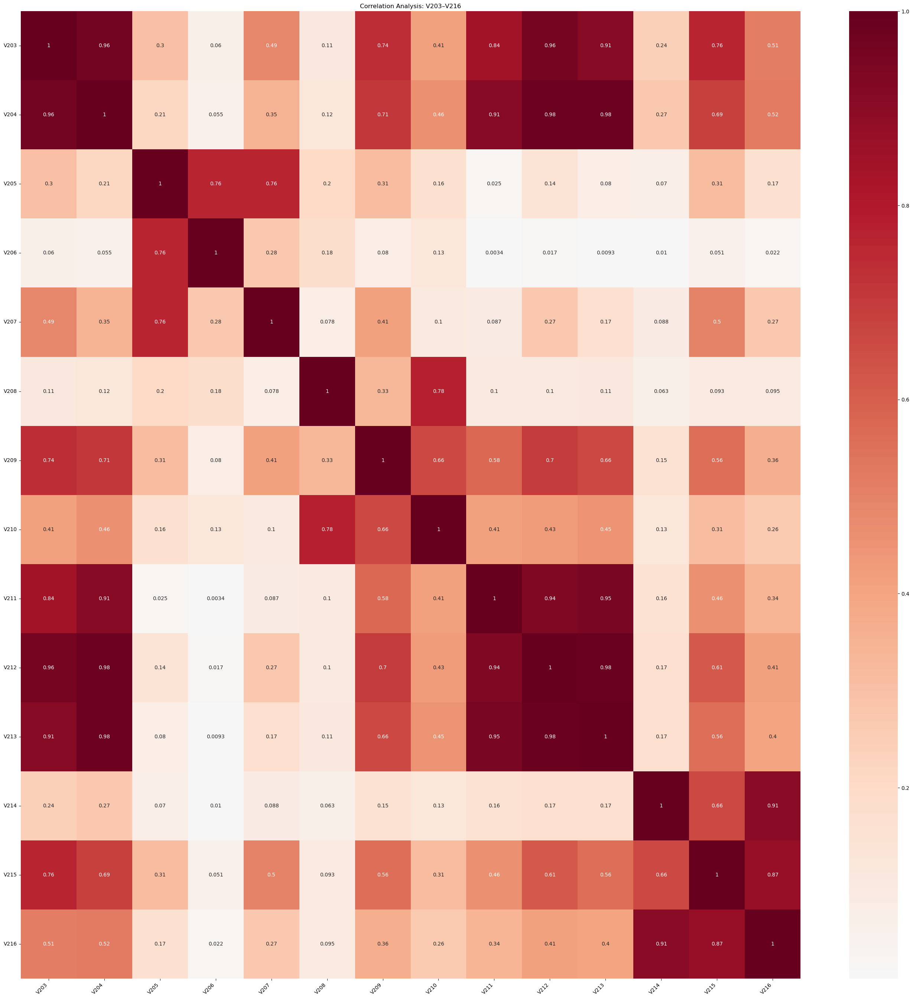

In [108]:
cols = [f"V{x}" for x in range(203, 217)]
correlation_analysis(cols, title='Correlation Analysis: V203–V216', size=(27,27))

In [109]:
pairs = [
    ['V203','V204'], ['V205','V206'], ['V207','V208'],
    ['V209','V210'], ['V211','V212'], ['V213','V214'],
    ['V215','V216']
]

red_cols_C = reduce_groups(pairs)
red_cols_C

['V203', 'V205', 'V207', 'V209', 'V212', 'V213', 'V215']

In [110]:
red_cols_group8 = red_cols_A + red_cols_B + red_cols_C
red_cols_group8

['V165',
 'V166',
 'V168',
 'V171',
 'V172',
 'V175',
 'V177',
 'V178',
 'V180',
 'V182',
 'V185',
 'V187',
 'V188',
 'V190',
 'V192',
 'V195',
 'V196',
 'V199',
 'V201',
 'V202',
 'V203',
 'V205',
 'V207',
 'V209',
 'V212',
 'V213',
 'V215']

## V217 - V278

### V217 - V239

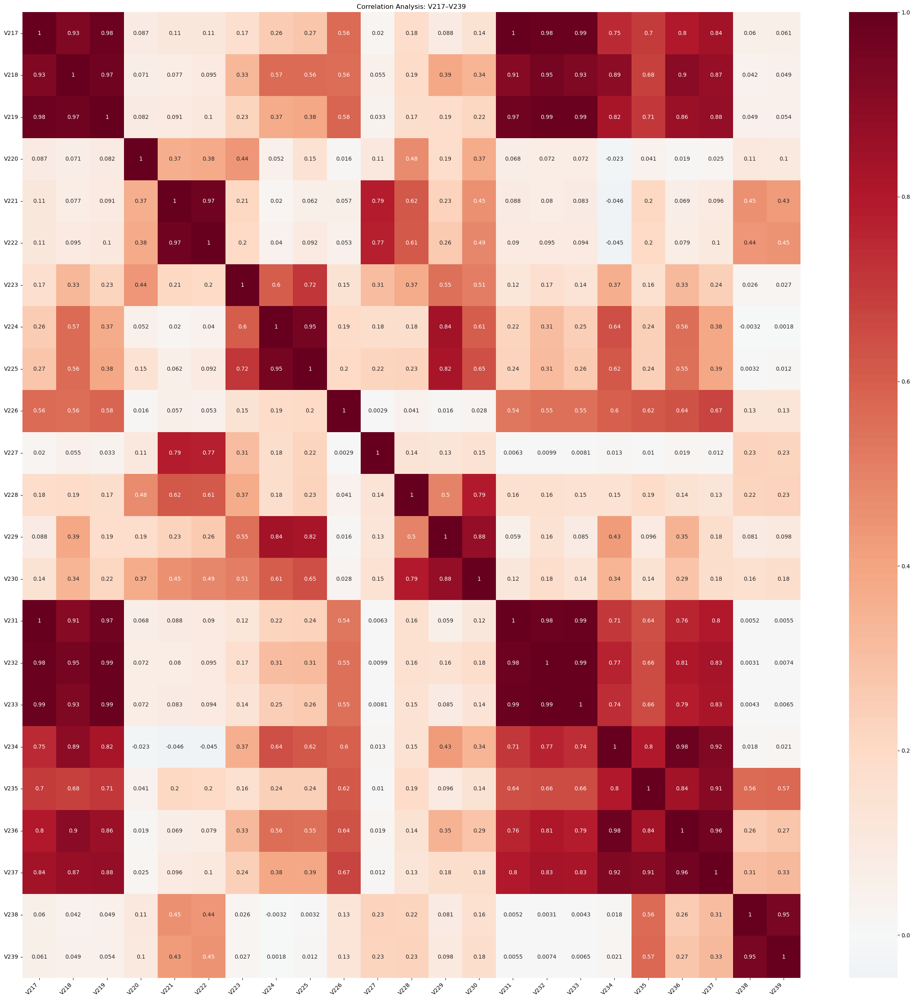

In [111]:
cols = [f"V{x}" for x in range(217, 240)]
correlation_analysis(cols, title='Correlation Analysis: V217–V239', size=(25,25))

In [112]:
pairs = [
    ['V217','V218'], ['V219','V220'], ['V221','V222'], ['V223','V224'], ['V225','V226'],
    ['V227','V228'], ['V229','V230'], ['V231','V232'], ['V233','V234'], ['V235','V236'],
    ['V237','V238'], ['V239']
]

red_cols_A = reduce_groups(pairs)
red_cols_A

['V218',
 'V219',
 'V221',
 'V224',
 'V226',
 'V228',
 'V229',
 'V232',
 'V233',
 'V236',
 'V237',
 'V239']

### V240 - V259

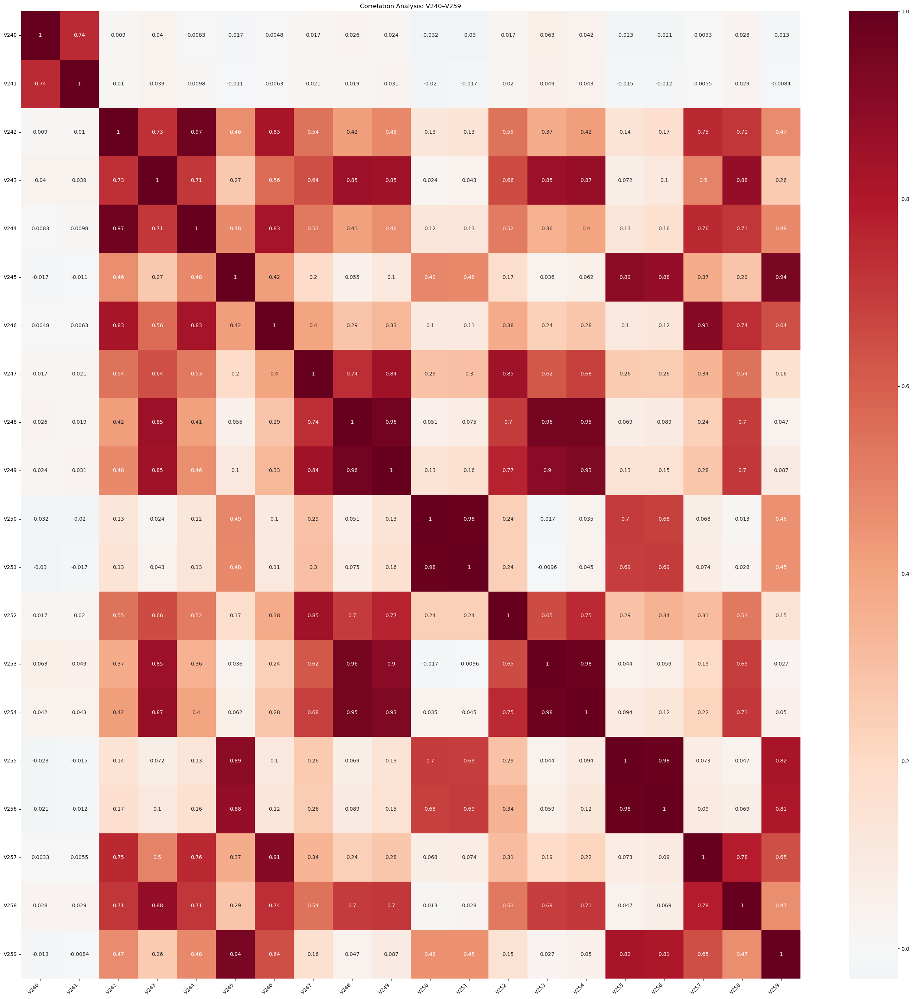

In [113]:
cols = [f"V{x}" for x in range(240, 260)]
correlation_analysis(cols, title='Correlation Analysis: V240–V259', size=(27,27))

In [114]:
pairs = [
    ['V240','V241'], ['V242','V243'], ['V244','V245'], ['V246','V247'], ['V248','V249'],
    ['V250','V251'], ['V252','V253'], ['V254','V255'], ['V256','V257'], ['V258','V259']
]

red_cols_B = reduce_groups(pairs)
red_cols_B

['V240',
 'V243',
 'V245',
 'V246',
 'V248',
 'V250',
 'V253',
 'V255',
 'V257',
 'V259']

### V260 - V278

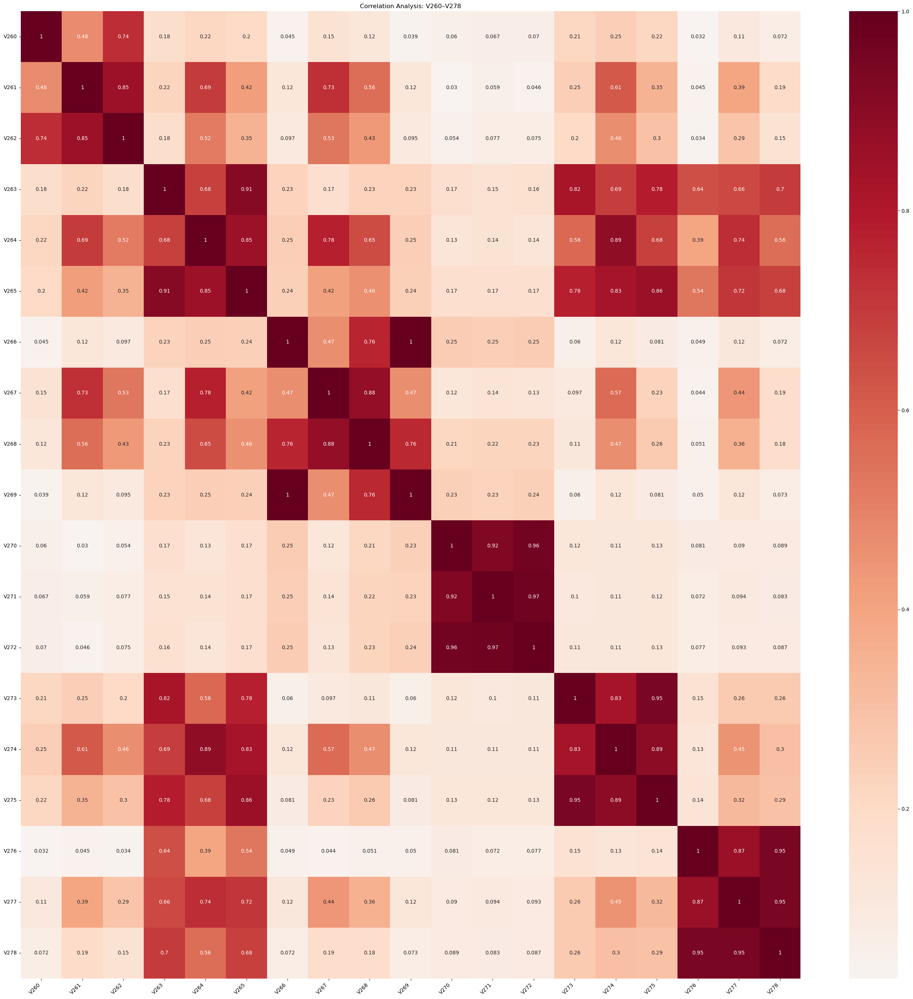

In [115]:
cols = [f"V{x}" for x in range(260, 279)]
correlation_analysis(cols, title='Correlation Analysis: V260–V278', size=(27,27))

In [116]:
pairs = [
    ['V260','V261'], ['V262','V263'], ['V264','V265'], ['V266','V267'], ['V268','V269'],
    ['V270','V271'], ['V272','V273'], ['V274','V275'], ['V276','V277'], ['V278']
]

red_cols_C = reduce_groups(pairs)
red_cols_C

['V261',
 'V263',
 'V264',
 'V267',
 'V268',
 'V271',
 'V273',
 'V274',
 'V277',
 'V278']

In [117]:
red_cols_group9 = red_cols_A + red_cols_B + red_cols_C
red_cols_group9

['V218',
 'V219',
 'V221',
 'V224',
 'V226',
 'V228',
 'V229',
 'V232',
 'V233',
 'V236',
 'V237',
 'V239',
 'V240',
 'V243',
 'V245',
 'V246',
 'V248',
 'V250',
 'V253',
 'V255',
 'V257',
 'V259',
 'V261',
 'V263',
 'V264',
 'V267',
 'V268',
 'V271',
 'V273',
 'V274',
 'V277',
 'V278']

## V279 – V339

### V279 - V304

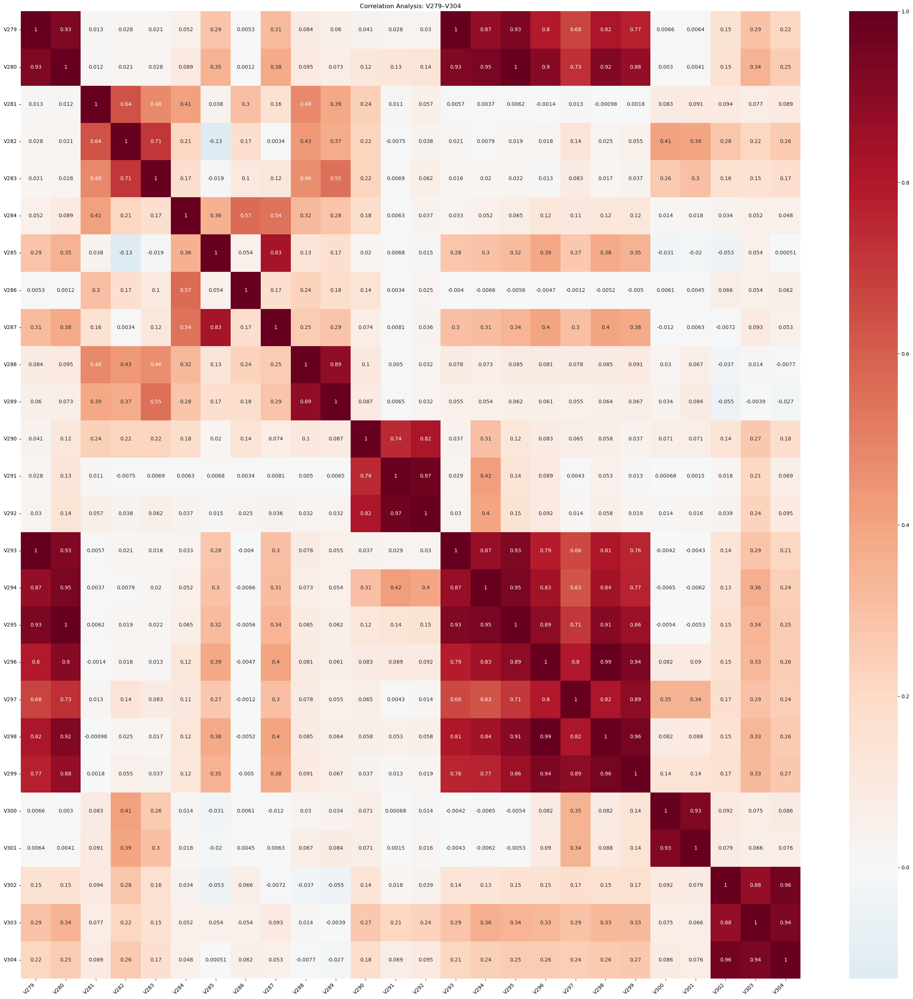

In [118]:
cols = [f"V{x}" for x in range(279, 305)]
correlation_analysis(cols, title='Correlation Analysis: V279–V304', size=(27,27))

In [119]:
pairs = [
    ['V279','V280'], ['V281','V282'], ['V283','V284'], ['V285','V286'], ['V287','V288'],
    ['V289','V290'], ['V291','V292'], ['V293','V294'], ['V295','V296'], ['V297','V298'],
    ['V299','V300'], ['V301','V302'], ['V303','V304']
]

red_cols_A = reduce_groups(pairs)
red_cols_A

['V280',
 'V282',
 'V283',
 'V285',
 'V287',
 'V290',
 'V291',
 'V294',
 'V295',
 'V298',
 'V299',
 'V302',
 'V303']

## V305 - V321

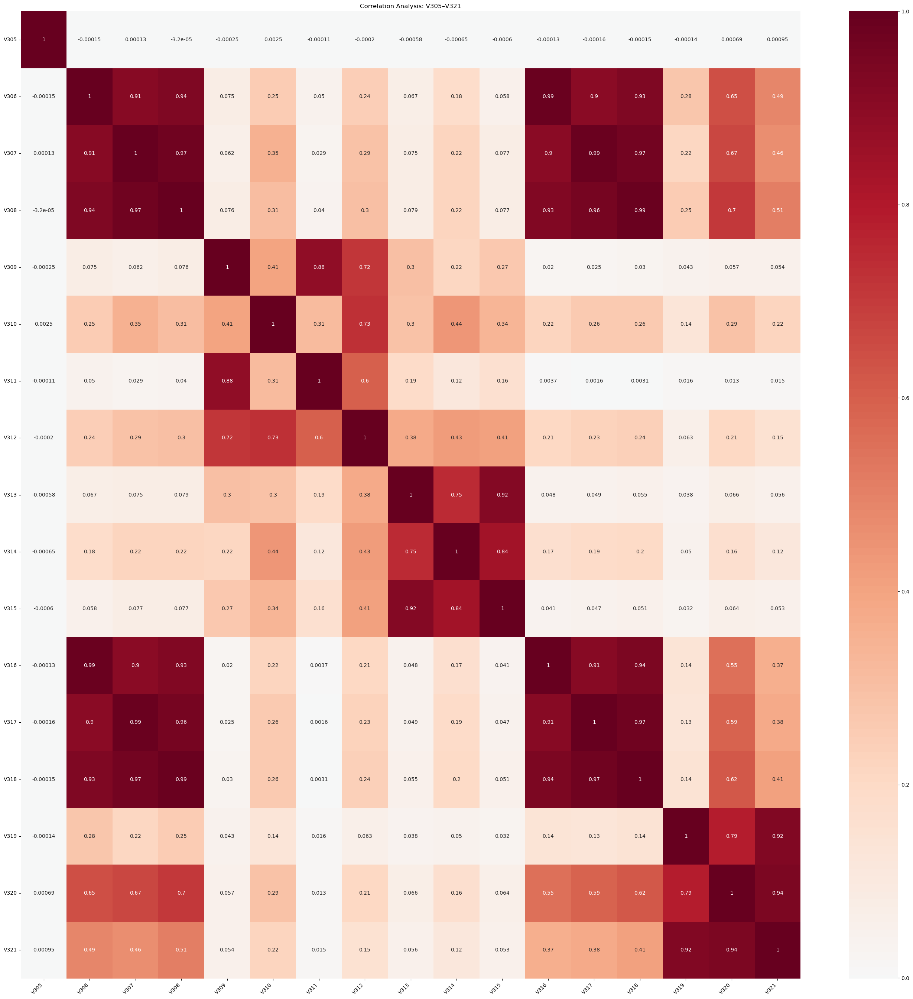

In [120]:
cols = [f"V{x}" for x in range(305, 322)]
correlation_analysis(cols, title='Correlation Analysis: V305–V321', size=(27,27))

In [121]:
pairs = [
    ['V305','V306'], ['V307','V308'], ['V309','V310'], ['V311','V312'], ['V313','V314'],
    ['V315','V316'], ['V317','V318'], ['V319','V320'], ['V321']
]

red_cols_B = reduce_groups(pairs)
red_cols_B

['V306', 'V307', 'V310', 'V312', 'V314', 'V316', 'V317', 'V320', 'V321']

### V322 - V339

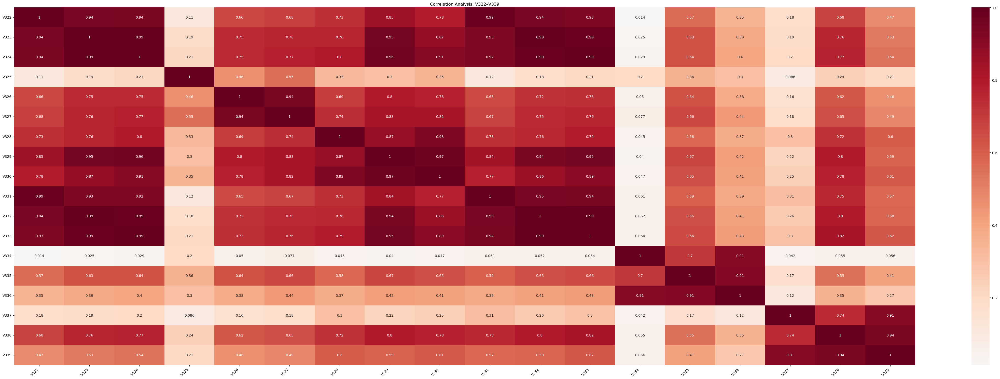

In [122]:
cols = [f"V{x}" for x in range(322, 340)]
correlation_analysis(cols, title='Correlation Analysis: V322–V339', size=(45,15))

In [123]:
pairs = [
    ['V322','V323'], ['V324','V325'], ['V326','V327'], ['V328','V329'], ['V330','V331'],
    ['V332','V333'], ['V334','V335'], ['V336','V337'], ['V338','V339']
]

red_cols_C = reduce_groups(pairs)
red_cols_C

['V323', 'V324', 'V326', 'V329', 'V331', 'V332', 'V335', 'V336', 'V338']

In [124]:
red_cols_group10 = red_cols_A + red_cols_B + red_cols_C
red_cols_group10

['V280',
 'V282',
 'V283',
 'V285',
 'V287',
 'V290',
 'V291',
 'V294',
 'V295',
 'V298',
 'V299',
 'V302',
 'V303',
 'V306',
 'V307',
 'V310',
 'V312',
 'V314',
 'V316',
 'V317',
 'V320',
 'V321',
 'V323',
 'V324',
 'V326',
 'V329',
 'V331',
 'V332',
 'V335',
 'V336',
 'V338']

In [125]:
# Menggabungkan semua hasil reduksi dari setiap group
final_v_features = (
    red_cols_group1 +
    red_cols_group2 +
    red_cols_group3 +
    red_cols_group4 +
    red_cols_group5 +
    red_cols_group6 +
    red_cols_group7 +
    red_cols_group8 +
    red_cols_group9 +
    red_cols_group10
)

# Buang duplikat dan urutkan
final_v_features = sorted(set(final_v_features))

# Cek jumlah dan daftar fitur
len(final_v_features), final_v_features

# (opsional) buat dataframe hanya dengan V terpilih + isFraud
v_reduced_cols = final_v_features + (['isFraud'] if 'isFraud' in df_train.columns else [])
df_train_v_reduced = df_train[v_reduced_cols].copy()

df_train.shape, df_train_v_reduced.shape

((590538, 438), (590538, 152))

## Id_01 - Id_38

Jumlah kolom ID numerik: 23
Contoh kolom: ['id_01', 'id_02', 'id_03', 'id_04', 'id_05', 'id_06', 'id_07', 'id_08', 'id_09', 'id_10', 'id_11', 'id_13', 'id_14', 'id_17', 'id_18', 'id_19', 'id_20', 'id_21', 'id_22', 'id_24', 'id_25', 'id_26', 'id_32', 'isFraud']


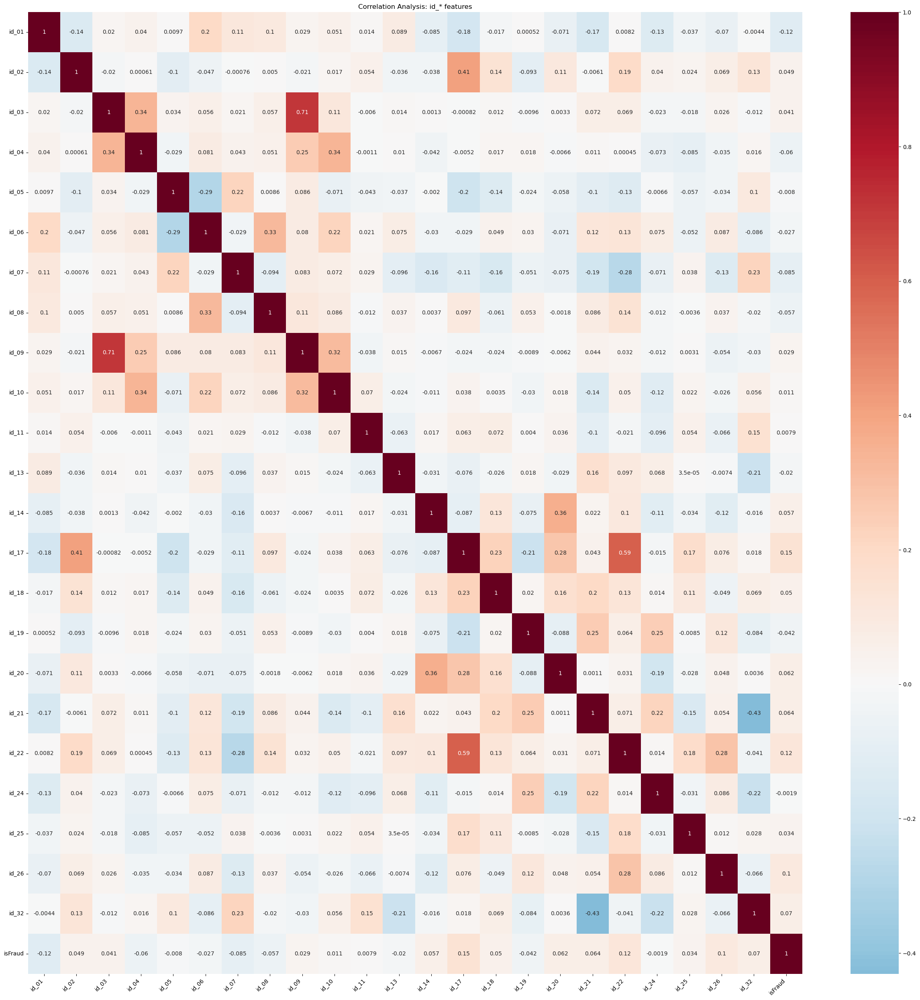

In [126]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Ambil semua kolom yang diawali 'id_'
id_cols = [col for col in df_train.columns if col.startswith('id_')]

# 2. Filter hanya kolom numerik (supaya .corr() tidak error)
numeric_id_cols = [c for c in id_cols if pd.api.types.is_numeric_dtype(df_train[c])]

# (opsional) sertakan target isFraud dalam korelasi
corr_cols = numeric_id_cols + ['isFraud'] if 'isFraud' in df_train.columns else numeric_id_cols

print("Jumlah kolom ID numerik:", len(numeric_id_cols))
print("Contoh kolom:", corr_cols)

# 3. Hitung korelasi
df_corr = df_train[corr_cols].corr()

# 4. Plot heatmap korelasi
fig, ax = plt.subplots(1, 1, figsize=(25, 25))
sns.heatmap(
    df_corr,
    annot=True,        # kalau terlalu ramai, bisa True tapi akan berat
    cmap='RdBu_r',
    center=0,
    ax=ax
)
ax.set_title('Correlation Analysis: id_* features')
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

Jumlah ID kategorikal: 15
ID kategorikal: ['id_12', 'id_15', 'id_16', 'id_23', 'id_27', 'id_28', 'id_29', 'id_30', 'id_31', 'id_33', 'id_34', 'id_35', 'id_36', 'id_37', 'id_38']


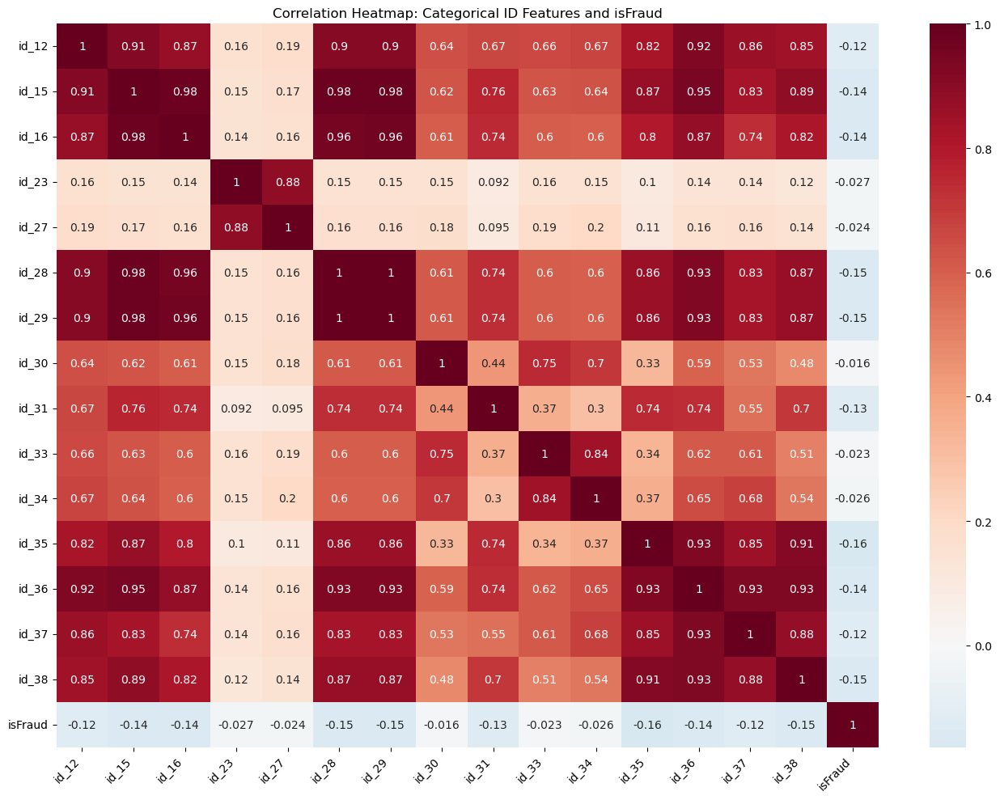

In [127]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder

# 1. Ambil semua kolom 'id_'
id_cols = [col for col in df_train.columns if col.startswith("id_")]

# 2. Pilih kolom yang kategorikal
id_cat_cols = [c for c in id_cols if df_train[c].dtype == 'object']

print("Jumlah ID kategorikal:", len(id_cat_cols))
print("ID kategorikal:", id_cat_cols)

# 3. Copy dan label-encode
df_id_cat = df_train[id_cat_cols].copy()

for col in id_cat_cols:
    le = LabelEncoder()
    df_id_cat[col] = le.fit_transform(df_id_cat[col].astype(str))

# 4. Tambahkan target
df_id_cat['isFraud'] = df_train['isFraud'].values

# 5. Hitung korelasi penuh (ID kategorikal + isFraud)
corr_mat = df_id_cat.corr(numeric_only=True)

# 6. Heatmap korelasi
plt.figure(figsize=(len(corr_mat.columns)*0.6 + 4, 10))  # ukuran dinamis sedikit
sns.heatmap(
    corr_mat,
    cmap='RdBu_r',
    center=0,
    annot=True
)
plt.title("Correlation Heatmap: Categorical ID Features and isFraud")
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

## Spearman Correlation and Pearson

In [128]:
import pandas as pd

# ============================================================
# 1. Definisikan fitur transaksi penting (manual)
# ============================================================
important_features = [
    'TransactionDT', 'TransactionAmt', 'ProductCD',
    'card1', 'card2', 'card3', 'card4', 'card5', 'card6',
    'addr1', 'addr2',
    'dist1', 'dist2',
    'id_01','id_02','id_03','id_04','id_05',
    'id_06','id_07','id_08','id_09','id_10','id_11',
    'id_13','id_14','id_15','id_16','id_17',
]

# ============================================================
# 2. Tambahkan semua fitur C* dan D* yang ada di df_train
# ============================================================
c_features = [c for c in df_train.columns if c.startswith('C')]
d_features = [c for c in df_train.columns if c.startswith('D')]

important_features.extend(c_features)
important_features.extend(d_features)

# ambil yang benar-benar ada (sekadar pengaman)
important_features = [f for f in important_features if f in df_train.columns]

# ============================================================
# 3. Pilih hanya kolom numerik untuk correlation
# ============================================================
numeric_important = [f for f in important_features if pd.api.types.is_numeric_dtype(df_train[f])]

# tambahkan target untuk korelasi
numeric_important.append('isFraud')

# subset dataframe kecil
df_small = df_train[numeric_important].copy()

# ============================================================
# 4. Hitung Pearson & Spearman correlation
# ============================================================
pearson_corr  = df_small.corr(method='pearson')
spearman_corr = df_small.corr(method='spearman')

pearson_vs_fraud  = pearson_corr['isFraud'].drop('isFraud')
spearman_vs_fraud = spearman_corr['isFraud'].drop('isFraud')

# ============================================================
# 5. Gabungkan ke dalam satu DataFrame perbandingan
#    (tanpa diurutkan, sesuai permintaan sebelumnya)
# ============================================================
corr_compare = pd.DataFrame({
    'pearson' : pearson_vs_fraud,
    'spearman': spearman_vs_fraud
})

corr_compare['abs_pearson']  = corr_compare['pearson'].abs()
corr_compare['abs_spearman'] = corr_compare['spearman'].abs()

corr_compare

,pearson,spearman,abs_pearson,abs_spearman
TransactionDT,0.013103,0.014166,0.013103,0.014166
TransactionAmt,0.011763,-0.001575,0.011763,0.001575
card1,-0.013639,-0.013430,0.013639,0.013430
card2,0.003389,0.003517,0.003389,0.003517
card3,0.154151,0.152209,0.154151,0.152209
card5,-0.033581,-0.035617,0.033581,0.035617
addr1,0.005595,0.006627,0.005595,0.006627
addr2,-0.030387,-0.025636,0.030387,0.025636
dist1,0.021522,0.020794,0.021522,0.020794
dist2,-0.019054,-0.010128,0.019054,0.010128


In [130]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder

# ============================================================
# 1. Definisikan fitur kategorikal transaksi penting
# ============================================================
cat_features = [
    'ProductCD',
    'card4', 'card6',
    'P_emaildomain', 'R_emaildomain',
    'DeviceType', 'DeviceInfo',
    'M1','M2','M3','M4','M5','M6','M7','M8','M9'   # tambahan di sini
]

# Hanya ambil fitur yang benar-benar ada di df_train
cat_features = [f for f in cat_features if f in df_train.columns]

# Copy dataset subset
df_cat = df_train[cat_features].copy()

# Label Encoding tiap fitur kategorikal
for col in cat_features:
    le = LabelEncoder()
    df_cat[col] = le.fit_transform(df_cat[col].astype(str))

# Tambahkan target isFraud
df_cat['isFraud'] = df_train['isFraud'].values

# Hitung Pearson & Spearman correlation
pearson_corr  = df_cat.corr(method='pearson')
spearman_corr = df_cat.corr(method='spearman')

pearson_vs_fraud  = pearson_corr['isFraud'].drop('isFraud')
spearman_vs_fraud = spearman_corr['isFraud'].drop('isFraud')

# Gabungkan hasil
corr_cat_compare = pd.DataFrame({
    'pearson' : pearson_vs_fraud,
    'spearman': spearman_vs_fraud
})

corr_cat_compare

,pearson,spearman
ProductCD,-0.156556,-0.148166
card4,-0.003298,-0.003211
card6,-0.097762,-0.100087
P_emaildomain,-0.024055,-0.015664
R_emaildomain,-0.085760,-0.111805
DeviceType,-0.112697,-0.128431
DeviceInfo,-0.075975,-0.094795
M1,0.089418,0.089419
M2,0.074819,0.081876
M3,0.070423,0.078304


In [ ]:
import pandas as pd

pd.set_option('display.max_rows', None)   # tampilkan semua baris
pd.set_option('display.max_columns', None)  # semua kolom

# final_v_features

# Pastikan final_v_features sudah terdefinisi sebelumnya
v_numeric = [
    f for f in final_v_features
    if f in df_train.columns and pd.api.types.is_numeric_dtype(df_train[f])
]

# Tambahkan target
v_numeric.append('isFraud')

# Subset dataframe
df_v = df_train[v_numeric].copy()

# 2. Hitung Pearson & Spearman correlation

pearson_corr  = df_v.corr(method='pearson')
spearman_corr = df_v.corr(method='spearman')

pearson_vs_fraud  = pearson_corr['isFraud'].drop('isFraud')
spearman_vs_fraud = spearman_corr['isFraud'].drop('isFraud')

corr_v_compare = pd.DataFrame({
    'pearson' : pearson_vs_fraud,
    'spearman': spearman_vs_fraud
})

corr_v_compare